# Lending Tree Loan Status: SMOTE
## Classification - XGBoost HPO RAPIDS GPU

## Set Up Environment, Read Data, Split Train/Validation Sets

In [ ]:
# Upgrade pip
!pip install --upgrade pip

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 65.3 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 22.0.3
    Uninstalling pip-22.0.3:
      Successfully uninstalled pip-22.0.3


In [ ]:
# Install/import dependencies
!pip install --upgrade -q wandb
!pip install xgboost==1.5.2
!pip install optuna
!pip install dask_optuna
!pip install eli5
!pip install shap
!pip install plotly
import os
import warnings
import random
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask.utils import parse_bytes
from dask_cuda import LocalCUDACluster
import dask_cudf
import dask_optuna
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import cudf
import cuml
from cuml.model_selection import train_test_split
from xgboost import XGBClassifier, plot_importance
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import joblib
from joblib import parallel_backend
import pickle
import pandas as pd
import sklearn
from sklearn.metrics import f1_score
from sklearn.metrics import fbeta_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import roc_auc_score
from sklearn.inspection import permutation_importance
import plotly.offline as py
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
from eli5 import show_weights
import webbrowser
from eli5.sklearn import explain_weights_sklearn
from eli5.formatters import format_as_dataframe, format_as_dataframes
import shap
warnings.filterwarnings('ignore')
my_dpi=96

os.environ['CUDA_VISIBLE_DEVICES'] = '0'

print('\n')
!nvidia-smi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 348.3/348.3 kB 34.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 209.8/209.8 kB 47.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 85.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 MB 41.4 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.0/81.0 kB 26.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 26.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.1/154.1 kB 40.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 147.1/147.1 kB 38.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.5/49.5 kB 17.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 112.4/112.4 kB 33.3 MB/s eta 0:00:00
  Created wheel for pyperclip: filename=pyperclip-1.8.2-py3-none-any.whl size=11137 sha256=784e4c674b4c51f4414ffb2fc7cf1e6831e5ea7f1bbbda490a

In [ ]:
# Set up Dask cluster    
cluster = LocalCUDACluster(CUDA_VISIBLE_DEVICES='0', memory_limit='10GB', 
                           device_memory_limit='5GB', ip='0.0.0.0')

client = Client(cluster)
client

distributed.diskutils - INFO - Found stale lock file and directory '/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Notebooks_Scripts/dask-worker-space/worker-j4e79rv7', purging
/opt/conda/envs/rapids/lib/python3.9/contextlib.py:126: UserWarning: Creating scratch directories is taking a surprisingly long time. This is often due to running workers on a network file system. Consider specifying a local-directory to point workers to write scratch data to a local disk.
  next(self.gen)
distributed.preloading - INFO - Import preload module: dask_cuda.initialize


Connection method: Cluster object,Cluster type: dask_cuda.LocalCUDACluster
Dashboard: http://10.42.102.181:8787/status,
Dashboard: http://10.42.102.181:8787/status,Workers: 1
Total threads: 1,Total memory: 9.31 GiB
Status: running,Using processes: True
Comm: tcp://10.42.102.181:35159,Workers: 1
Dashboard: http://10.42.102.181:8787/status,Total threads: 1
Started: Just now,Total memory: 9.31 GiB
Comm: tcp://10.42.102.181:36611,Total threads: 1
Dashboard: http://10.42.102.181:43113/status,Memory: 9.31 GiB
Nanny: tcp://10.42.102.181:39681,


In [ ]:
# Define function to time code blocks
@contextmanager
def timed(name):
    t0 = time.time()
    yield
    t1 = time.time()
    print('..%-24s:  %8.4f' % (name, t1 - t0))

In [ ]:
# Set seed 
seed_value = 42
os.environ['xgbRAPIDS_GPU'] = str(seed_value)
random.seed(seed_value)
cupy.random.seed(seed_value)
np.random.seed(seed_value)

In [ ]:
%cd /notebooks/LoanStatus/Data/

/notebooks/LoanStatus/Data


In [ ]:
# Read data
trainDF = cudf.read_csv('trainDF_SMOTE.csv', low_memory=False)
print('Train set: Number of rows and columns:', trainDF.shape)

testDF  = cudf.read_csv('testDF_SMOTE.csv', low_memory=False)
print('Test set: Number of rows and columns:', testDF.shape)

Train set: Number of rows and columns: (3022132, 51)
Test set: Number of rows and columns: (432473, 51)


In [ ]:
# Split train set into train and validation set
X_train, X_val, y_train, y_val = train_test_split(trainDF, 'loan_status', 
                                                  train_size=0.8)

# Convert data types for modeling
X_train = X_train.astype('float32')
X_val = X_val.astype('float32')
y_train = y_train.astype('int32')
y_val = y_val.astype('int32')

## Weighted F1

### 100 Trials

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_smote_xgbRapids_weightedF1_tpe'

In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_xgb100gpu_trainvaltest', 
                'save_code': 'False', 'notes': 'smote_xgb100gpu_trainvaltest'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `XGBoostClassifier` model.
    """
    joblib.dump(study, 'xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.pkl')

    # Define parameter grid
    params_xgboost_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'subsample': trial.suggest_float('subsample', 0.25, 0.75),
        'gamma': trial.suggest_float('gamma', 0, 3),
        'learning_rate': trial.suggest_float('learning_rate', 0.0001, 0.3),
        'reg_alpha' : trial.suggest_float('reg_alpha', 0, 3),
        'reg_lambda' : trial.suggest_float('reg_lambda', 0, 3),
        'colsample_bytree' : trial.suggest_float('colsample_bytree', 0.5, 0.99),
        'colsample_bylevel' : trial.suggest_float('colsample_bylevel', 0.05, 0.5), 
        'min_child_weight' : trial.suggest_int('min_child_weight', 1, 10),
    }    

    # Define model type
    xgb = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params_xgboost_optuna)
    
    # Start timer for each trial
    start = timer()

    xgb.fit(X_train, y_train, 
            eval_set=[(X_val, y_val)], 
            verbose=0)    
    
    # Predictions
    y_pred_val = xgb.predict(X_val)
    score = f1_score(asnumpy(y_val), asnumpy(y_pred_val), average='weighted')
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial weighted F1:', score)
    print('######################################################')

    return score


In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.pkl'): 
        study = joblib.load('xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial),
                       n_trials=100)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest F1 Score', study.best_value)
wandb.finish()

- Trial time: 9.273346859030426
- Trial weighted F1: 0.9917437379076358
######################################################
- Trial time: 11.827306778053753
- Trial weighted F1: 0.9392980754616137
######################################################
- Trial time: 26.90952072897926
- Trial weighted F1: 0.9828550853772068
######################################################
- Trial time: 11.10122163395863
- Trial weighted F1: 0.9924734645724024
######################################################
- Trial time: 35.00243464997038
- Trial weighted F1: 0.98987535274002
######################################################
- Trial time: 10.323373804916628
- Trial weighted F1: 0.9917817878993049
######################################################
- Trial time: 8.544212342007086
- Trial weighted F1: 0.9907723253657443
######################################################
- Trial time: 3.2518254349706694
- Trial weighted F1: 0.9816645639575506
######################################

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'f1_weighted'},inplace=True)
trials_df.rename(columns={'params_colsample_bylevel':'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree':'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma':'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate':'learning_rate'}, inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight':'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha':'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda':'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample':'subsample'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('f1_weighted', ascending=False)
trials_df.to_csv('xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.csv', index=False)
print(trials_df) 

    iteration  f1_weighted             datetime_start  \
71         71     0.992900 2022-09-17 03:38:43.525601   
75         75     0.992881 2022-09-17 03:40:06.352728   
44         44     0.992881 2022-09-17 03:29:43.927834   
35         35     0.992866 2022-09-17 03:26:12.340948   
61         61     0.992862 2022-09-17 03:35:26.689823   
..        ...          ...                        ...   
40         40     0.986074 2022-09-17 03:28:00.101980   
2           2     0.982855 2022-09-17 03:16:02.089792   
7           7     0.981665 2022-09-17 03:17:35.815610   
9           9     0.970120 2022-09-17 03:17:52.035574   
1           1     0.939298 2022-09-17 03:15:49.749470   

            datetime_complete               duration  colsample_bylevel  \
71 2022-09-17 03:39:05.406020 0 days 00:00:21.880419           0.486471   
75 2022-09-17 03:40:32.286701 0 days 00:00:25.933973           0.456165   
44 2022-09-17 03:30:14.616679 0 days 00:00:30.688845           0.471663   
35 2022-09-17 0

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'learning_rate', 
                                                       'gamma'])
py.plot(fig, filename='contour_xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.html')
fig.show()

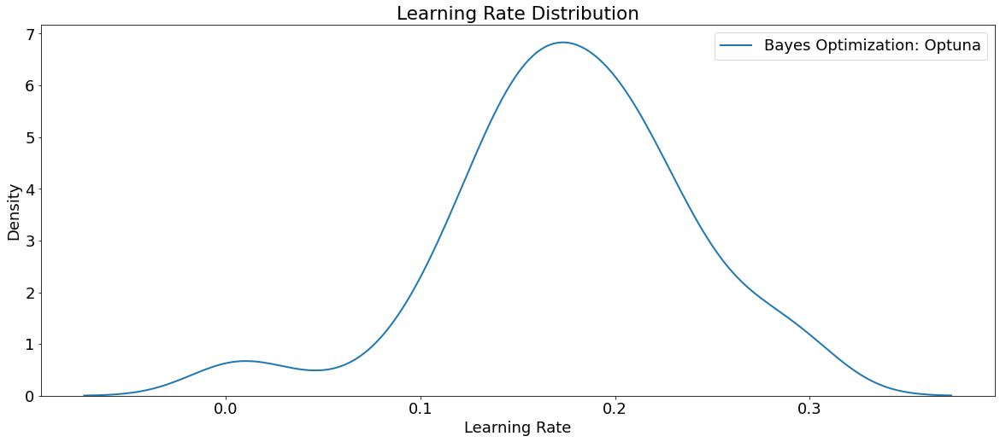

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc = 1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

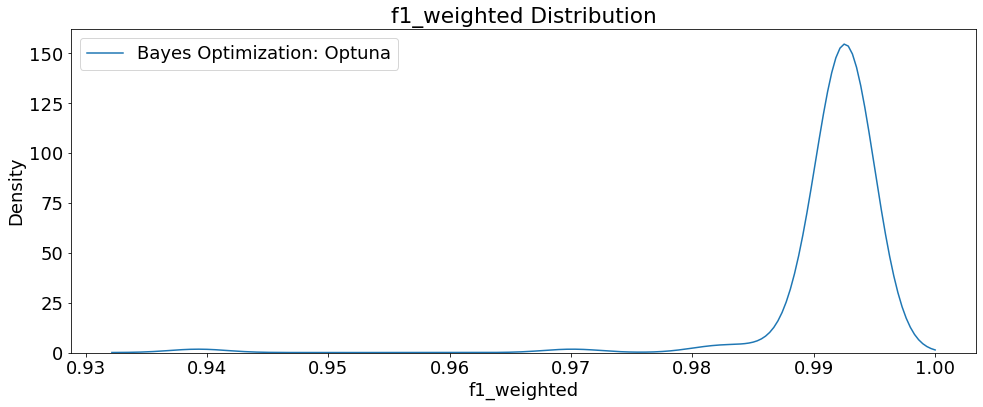

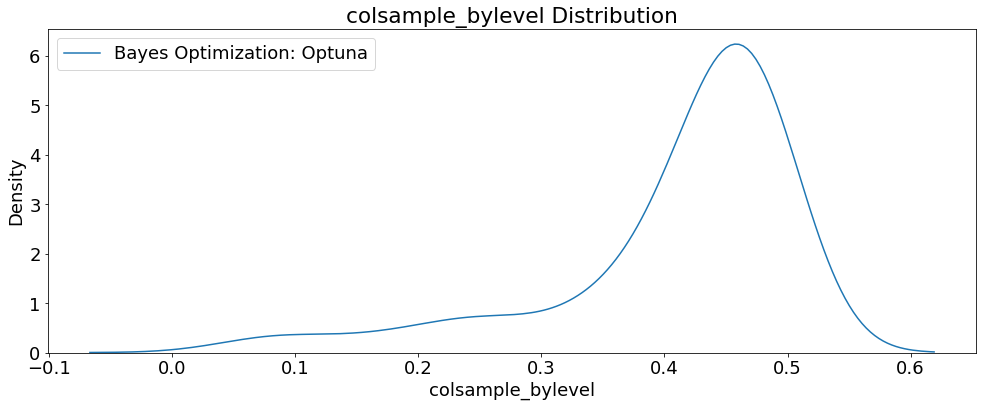

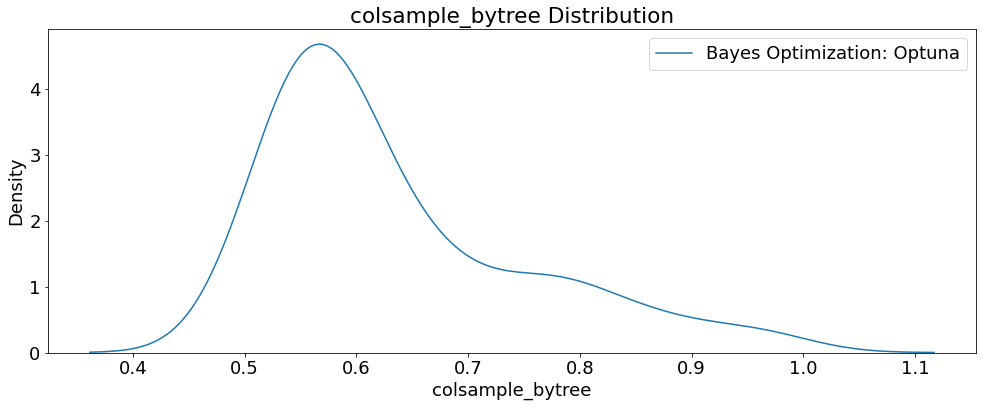

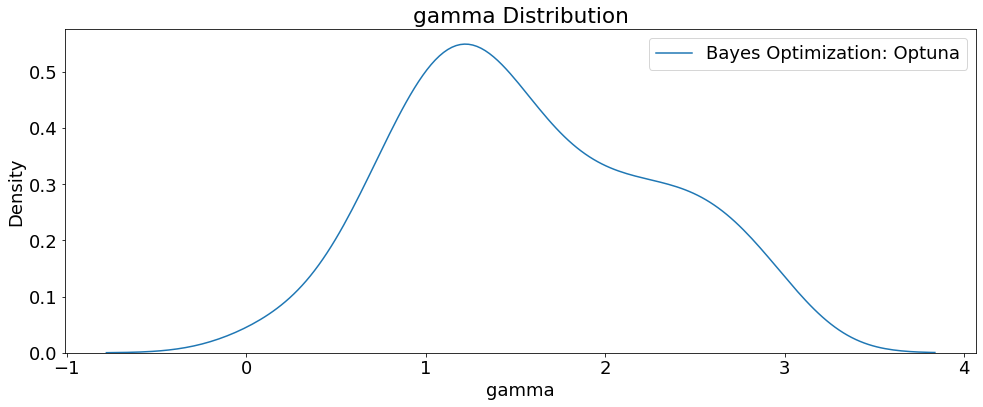

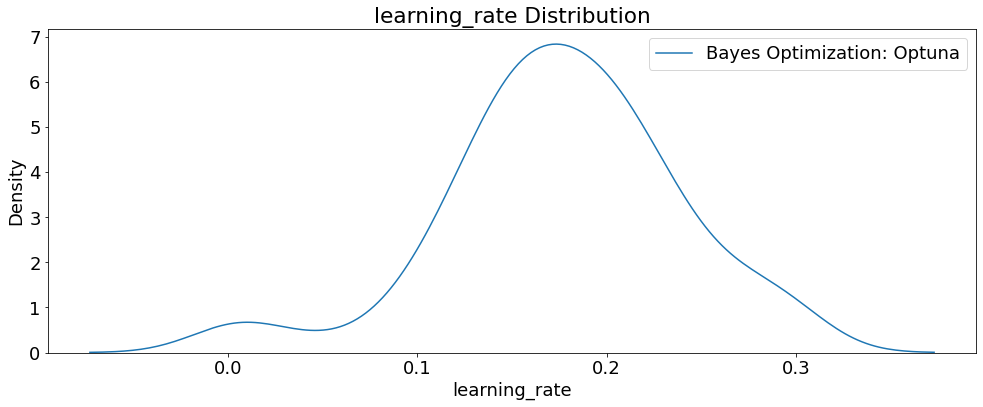

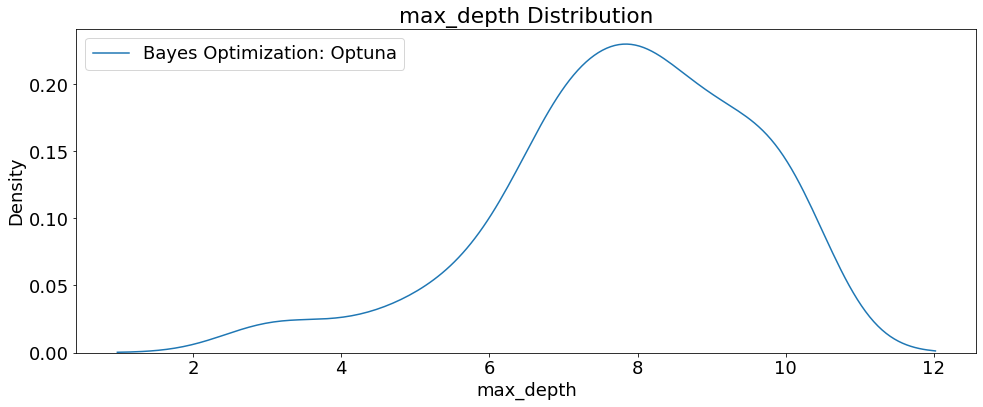

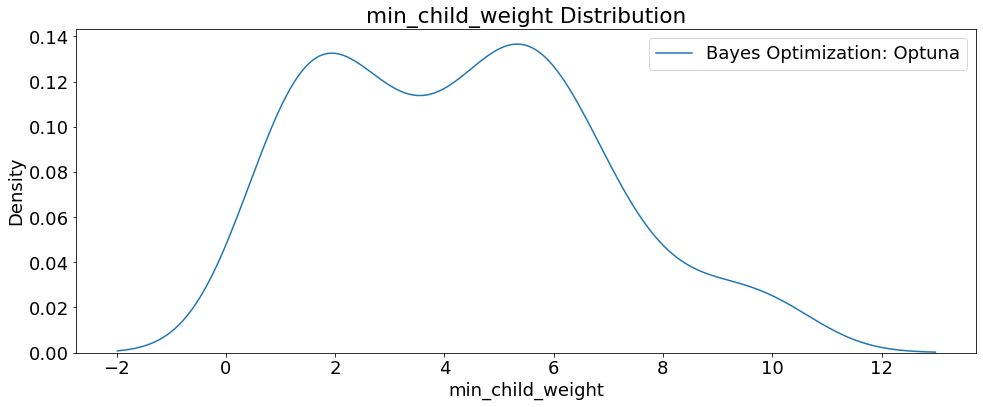

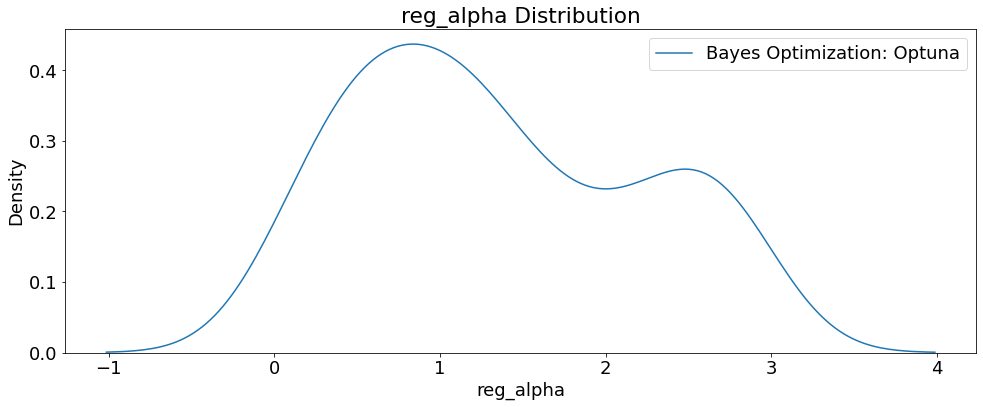

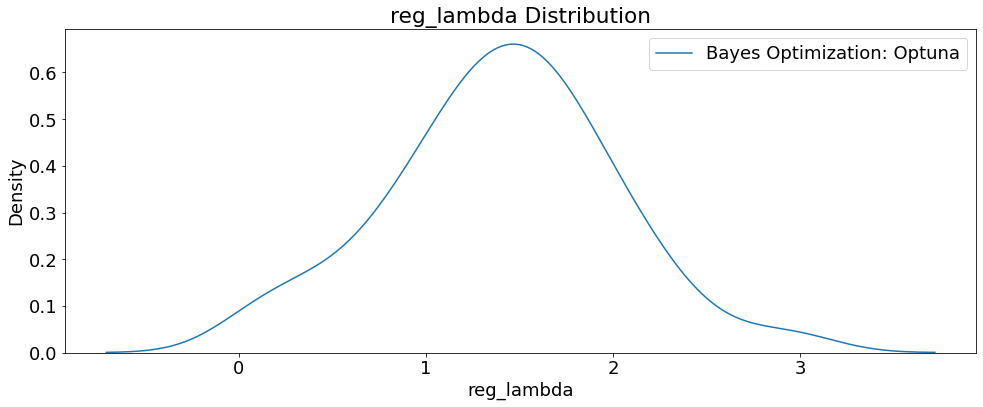

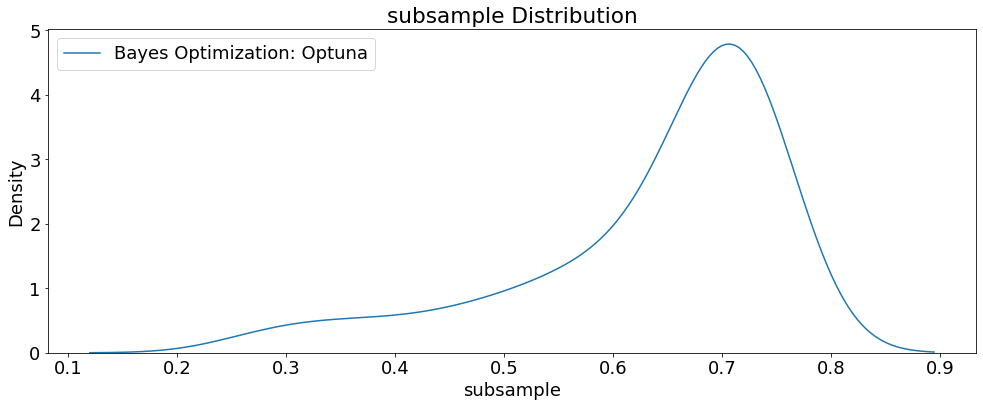

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize = (14, 6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

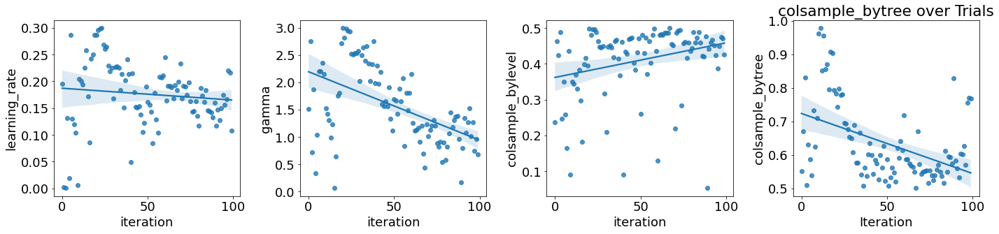

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'gamma', 'colsample_bylevel',
                         'colsample_bytree']): 
                        # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

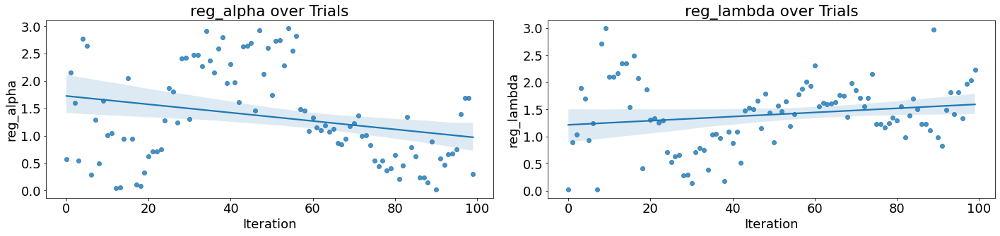

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['reg_alpha', 'reg_lambda']):
        # Scatterplot
        sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
        axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
                   title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params

{'n_estimators': 439,
 'max_depth': 7,
 'subsample': 0.7325248475887562,
 'gamma': 1.12969623561189,
 'learning_rate': 0.19134047279967198,
 'reg_alpha': 1.3636084699399456,
 'reg_lambda': 1.70787382798864,
 'colsample_bytree': 0.5498467743203572,
 'colsample_bylevel': 0.4864710087836885,
 'min_child_weight': 5}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

In [ ]:
# Re-create the best model and train on the training data
best_model = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'xgbRAPIDS_Optuna_SMOTE_100trials_GPU_f1weighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('xgbRAPIDS_Optuna_SMOTE_100trials_GPU_f1weighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost RAPIDS HPO SMOTE 100 trials GPU F1 Weighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for XGBoost RAPIDS HPO SMOTE 100 trials GPU F1 Weighted


Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    377848
           1       1.00      0.91      0.95     54625

    accuracy                           0.99    432473
   macro avg       0.99      0.95      0.97    432473
weighted avg       0.99      0.99      0.99    432473



Confusion matrix:
[[377642    206]
 [  4998  49627]]


Accuracy score : 0.988
Precision score : 0.996
Recall score : 0.909
F1 score : 0.950


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 100 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 100 GPU trials optimization scores 0.95398 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    71
f1_weighted                              0.9929
datetime_start       2022-09-17 03:38:43.525601
datetime_complete    2022-09-17 03:39:05.406020
duration                 0 days 00:00:21.880419
colsample_bylevel                      0.486471
colsample_bytree                       0.549847
gamma                                  1.129696
learning_rate                           0.19134
max_depth                                     7
min_child_weight                              5
n_estimators                                439
reg_alpha                              1.363608
reg_lambda                             1.707874
subsample                              0.732525
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
# Model metrics with ELI5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.2693 ± 0.0006,total_pymnt
0.2395 ± 0.0008,out_prncp
0.0860 ± 0.0003,loan_amnt
0.0678 ± 0.0002,recoveries
0.0480 ± 0.0007,installment
0.0286 ± 0.0003,last_pymnt_amnt
0.0135 ± 0.0003,total_rec_int
0.0008 ± 0.0001,total_rec_late_fee
0.0008 ± 0.0001,int_rate
0.0003 ± 0.0000,term_ 60 months


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,total_pymnt,0.269268,0.000292
1,out_prncp,0.239466,0.000412
2,loan_amnt,0.086008,0.000163
3,recoveries,0.067815,0.000095
4,installment,0.047953,0.000345
5,last_pymnt_amnt,0.028608,0.000132
6,total_rec_int,0.013543,0.000138
7,total_rec_late_fee,0.000803,0.000028
8,int_rate,0.000782,0.000056
9,term_ 60 months,0.000311,0.000019


In [ ]:
# Training Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_train)

<Figure size 432x288 with 0 Axes>

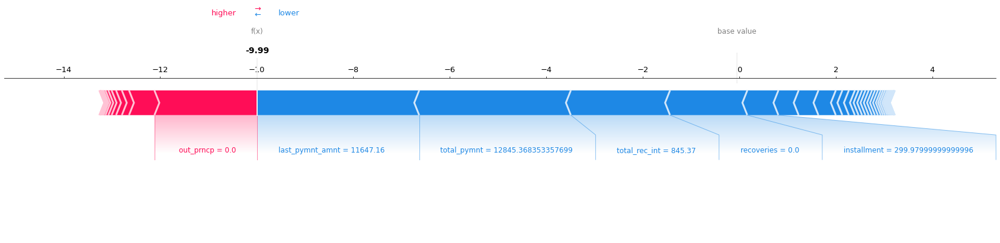

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 5)).savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted_ShapForcePlot_TrainSet.png', 
                                                                      dpi=my_dpi, 
                                                                      bbox_inches='tight');

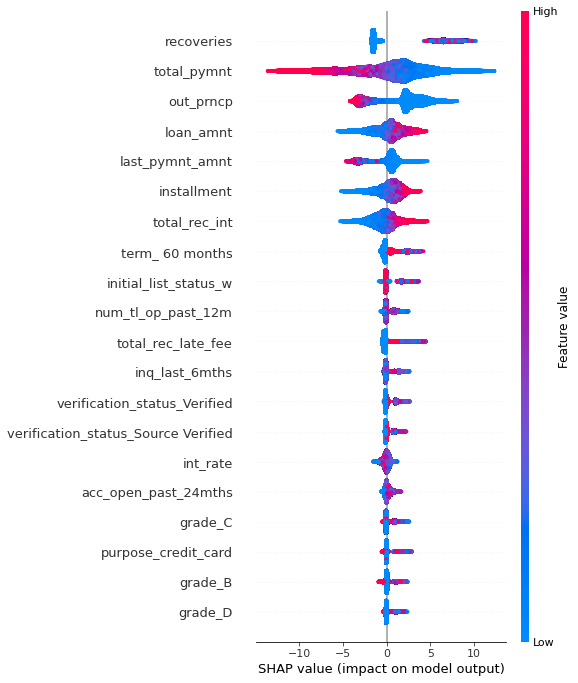

In [ ]:
# Training Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_train.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted_ShapSummary_TrainSet.png', 
            dpi=my_dpi, bbox_inches='tight');

In [ ]:
# Test Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_test)

<Figure size 432x288 with 0 Axes>

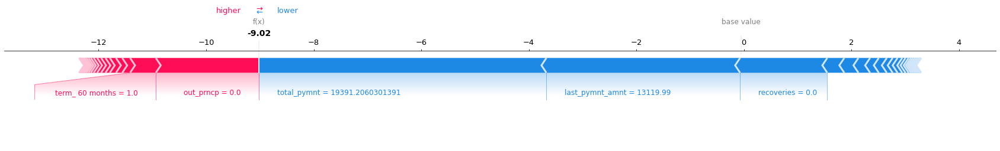

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_test.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 3)).savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted_ShapForcePlot_TestSet.png', 
                                                                      dpi=my_dpi, 
                                                                      bbox_inches='tight');

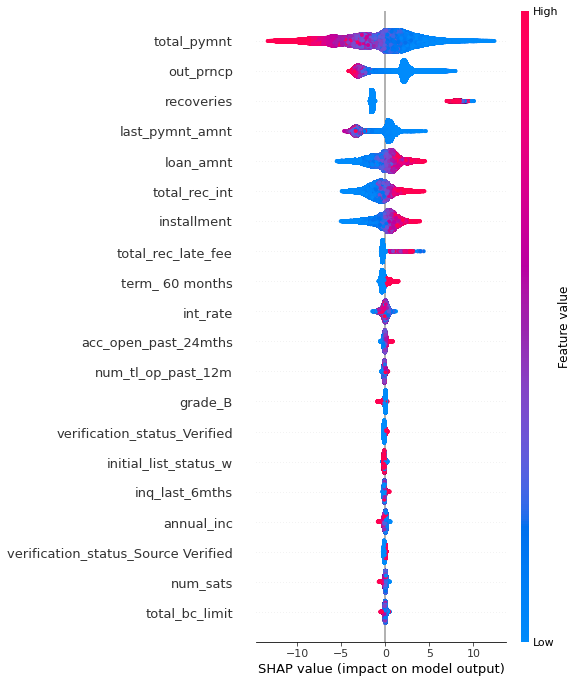

In [ ]:
# Test Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_test.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted_ShapSummary_TestSet.png', 
            dpi=my_dpi, bbox_inches='tight');

<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

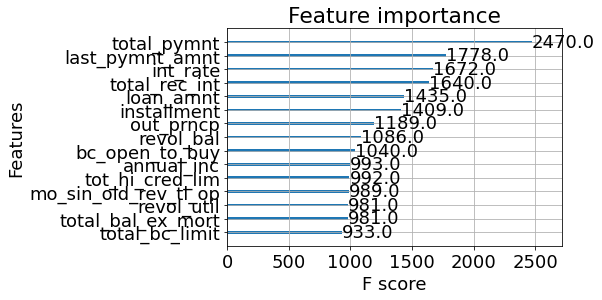

In [ ]:
# Feature importance
plot_importance(best_model, max_num_features=15);

<Figure size 432x288 with 0 Axes>

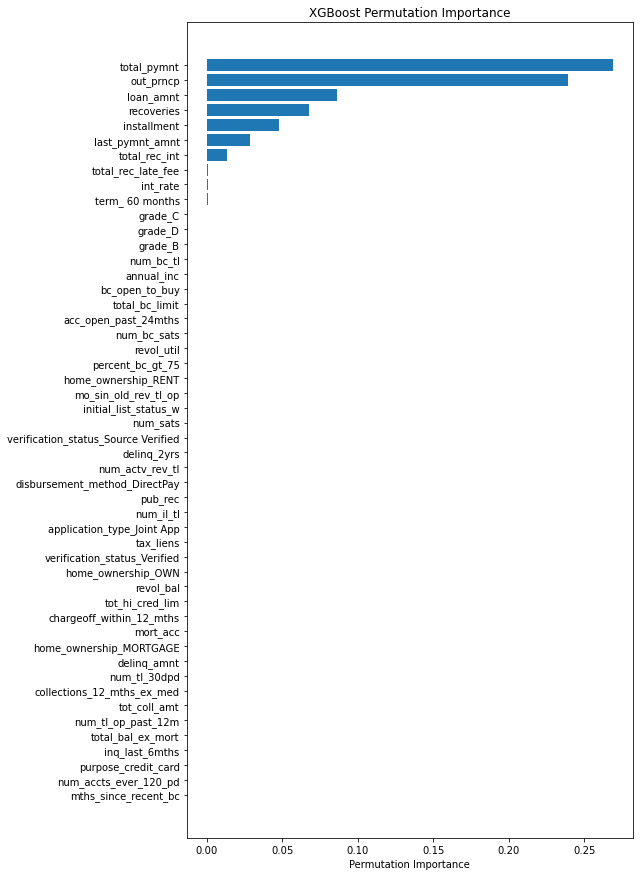

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('XGBoost Permutation Importance')
fig.savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_f1weighted_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

### 300 Trials

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_smote_xgbRapids_weightedF1_300_tpe'

In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_xgb300gpu_trainvaltest', 
                'save_code': 'False', 'notes': 'smote_xgb300gpu_trainvaltest_f1weighted'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `XGBoostClassifier` model.
    """
    joblib.dump(study, 'xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.pkl')

    # Define parameter grid
    params_xgboost_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 400, 700),
        'max_depth': trial.suggest_int('max_depth', 7, 15),
        'subsample': trial.suggest_float('subsample', 0.55, 0.8),
        'gamma': trial.suggest_float('gamma', 0.6, 2.5),
        'learning_rate': trial.suggest_float('learning_rate', 0.13, 0.3),
        'reg_alpha' : trial.suggest_float('reg_alpha', 0.2, 2.65),
        'reg_lambda' : trial.suggest_float('reg_lambda', 0.6, 2.3),
        'colsample_bytree' : trial.suggest_float('colsample_bytree', 0.5, 0.8),
        'colsample_bylevel' : trial.suggest_float('colsample_bylevel', 0.35, 0.6), 
        'min_child_weight' : trial.suggest_int('min_child_weight', 1, 8),
    }      

    # Define model type
    xgb = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params_xgboost_optuna)
    
    # Start timer for each trial
    start = timer()

    xgb.fit(X_train, y_train, 
            eval_set=[(X_val, y_val)],
            verbose=0)    
    
    # Predictions
    y_pred_val = xgb.predict(X_val)
    score = f1_score(asnumpy(y_val), asnumpy(y_pred_val), average='weighted')
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial weighted F1:', score)
    print('######################################################')

    return score

In [ ]:
study = joblib.load('xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.pkl')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest F1 Score', study.best_value)

Number of finished trials: 35
Best trial: {'n_estimators': 504, 'max_depth': 10, 'subsample': 0.7884109129309878, 'gamma': 2.4917228543486036, 'learning_rate': 0.13369246192923853, 'reg_alpha': 1.6781034649937816, 'reg_lambda': 2.2841174167066725, 'colsample_bytree': 0.7321652864845699, 'colsample_bylevel': 0.5108159983287197, 'min_child_weight': 3}
Highest F1 Score 0.9930741838743147


In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.pkl'): 
        study = joblib.load('xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=265)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest F1 Score', study.best_value)
wandb.finish()

- Trial time: 17.465171184856445
- Trial weighted F1: 0.9929931075449085
######################################################
- Trial time: 31.569154267199337
- Trial weighted F1: 0.9930311729946917
######################################################
- Trial time: 19.635910976910964
- Trial weighted F1: 0.9929898132170127
######################################################
- Trial time: 20.713211907073855
- Trial weighted F1: 0.9930344787359903
######################################################
- Trial time: 32.77394607895985
- Trial weighted F1: 0.9929765865813874
######################################################
- Trial time: 42.855363629059866
- Trial weighted F1: 0.9929881571933841
######################################################
- Trial time: 23.988057071808726
- Trial weighted F1: 0.993019598853763
######################################################
- Trial time: 18.388933898881078
- Trial weighted F1: 0.9930675731920253
#################################

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'f1_weighted'},inplace=True)
trials_df.rename(columns={'params_colsample_bylevel':'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree':'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma':'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate':'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight':'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha':'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda':'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample':'subsample'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('f1_weighted', ascending=False)
trials_df.to_csv('xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.csv', index=False)
print(trials_df) 

     iteration  f1_weighted             datetime_start  \
271        271     0.993178 2022-09-18 04:15:41.163464   
122        122     0.993170 2022-09-18 03:34:13.524632   
182        182     0.993165 2022-09-18 03:50:32.282648   
268        268     0.993162 2022-09-18 04:14:47.364919   
231        231     0.993155 2022-09-18 04:04:23.402626   
..         ...          ...                        ...   
8            8     0.992809 2022-09-18 02:52:30.182629   
51          51     0.992809 2022-09-18 03:10:46.524193   
4            4     0.992801 2022-09-18 02:51:50.103090   
19          19     0.992753 2022-09-18 02:54:31.774280   
34          34          NaN 2022-09-18 02:58:48.130980   

             datetime_complete               duration  colsample_bylevel  \
271 2022-09-18 04:15:59.718844 0 days 00:00:18.555380           0.544937   
122 2022-09-18 03:34:31.023521 0 days 00:00:17.498889           0.592178   
182 2022-09-18 03:50:49.120409 0 days 00:00:16.837761           0.563410   

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'learning_rate', 
                                                       'gamma'])
py.plot(fig, filename='contour_xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.html')
fig.show()

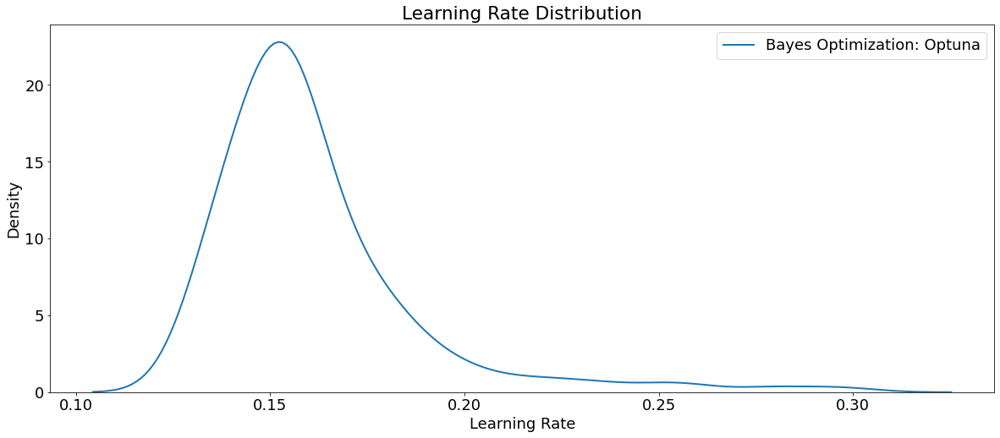

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc = 1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

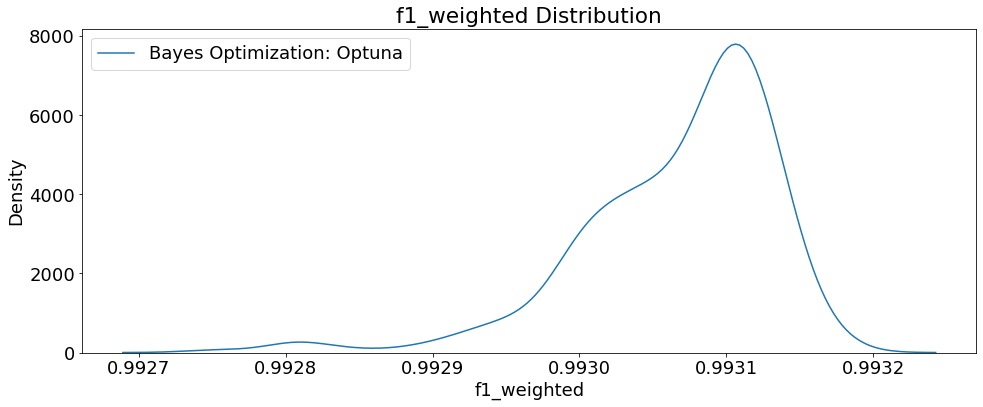

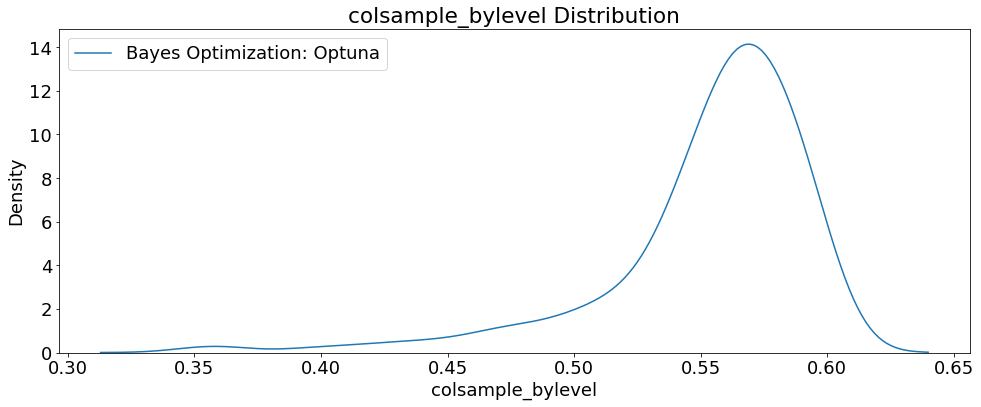

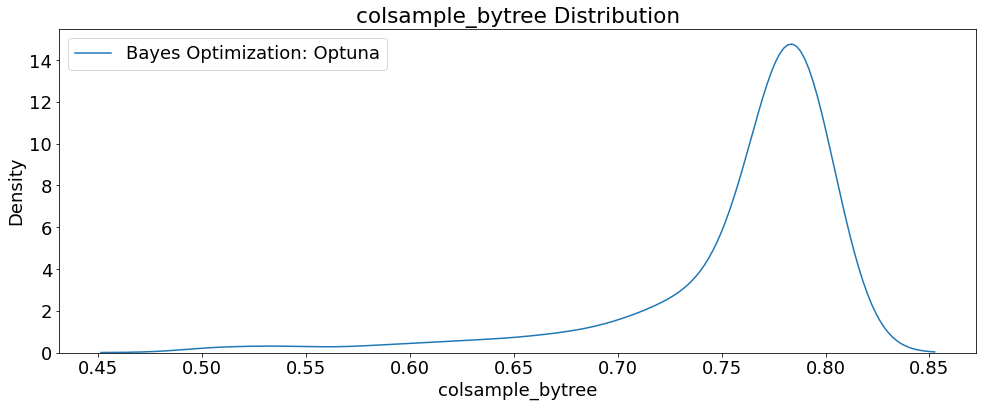

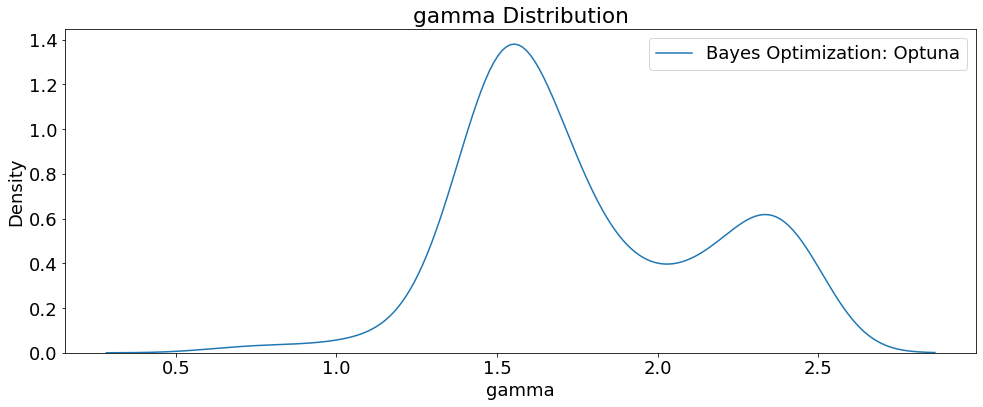

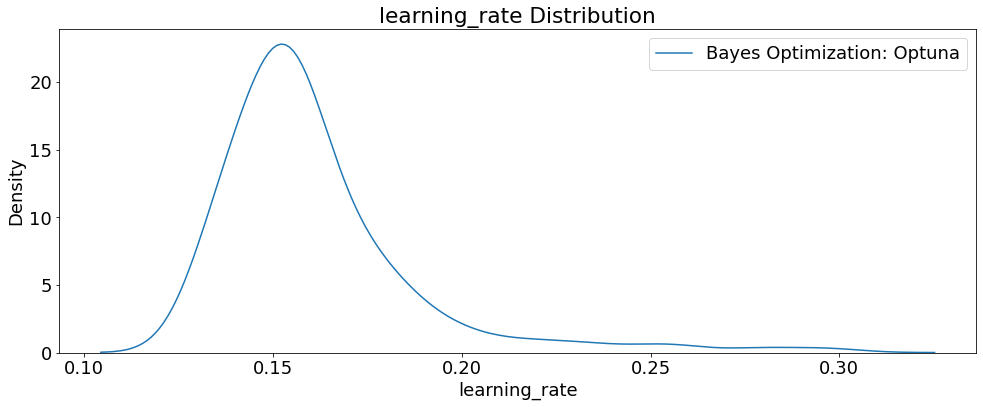

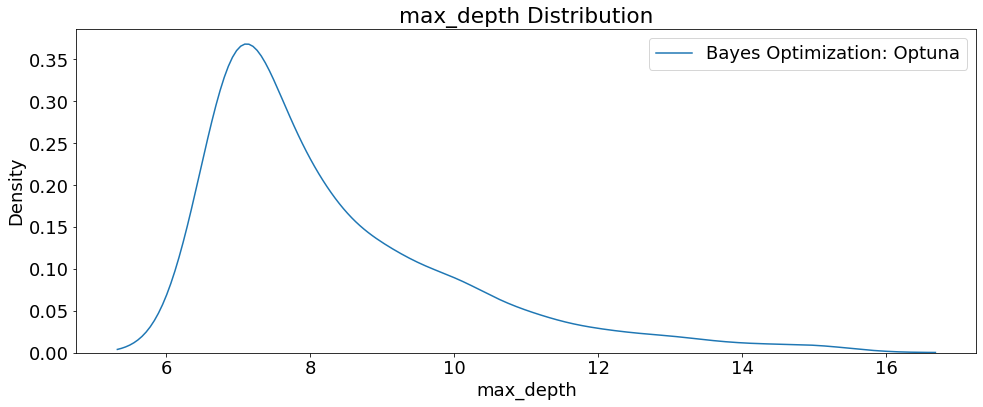

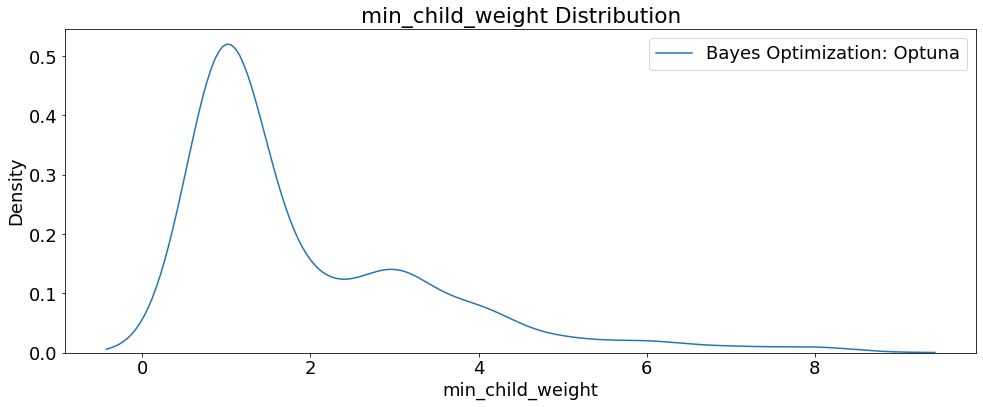

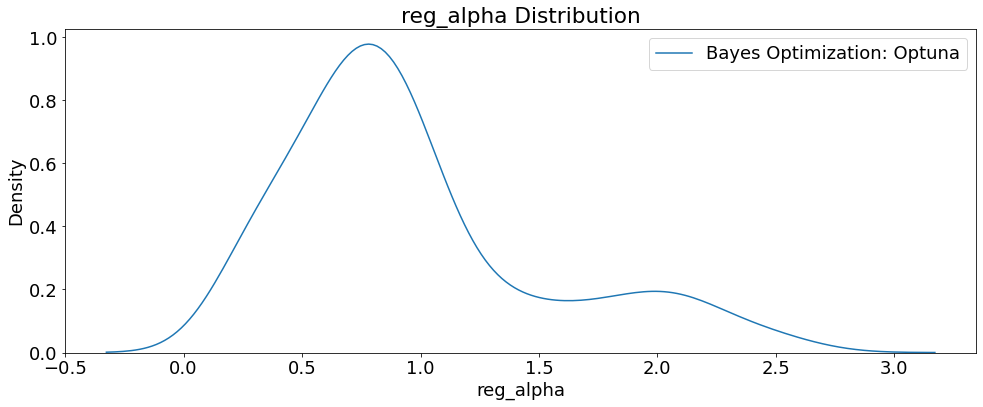

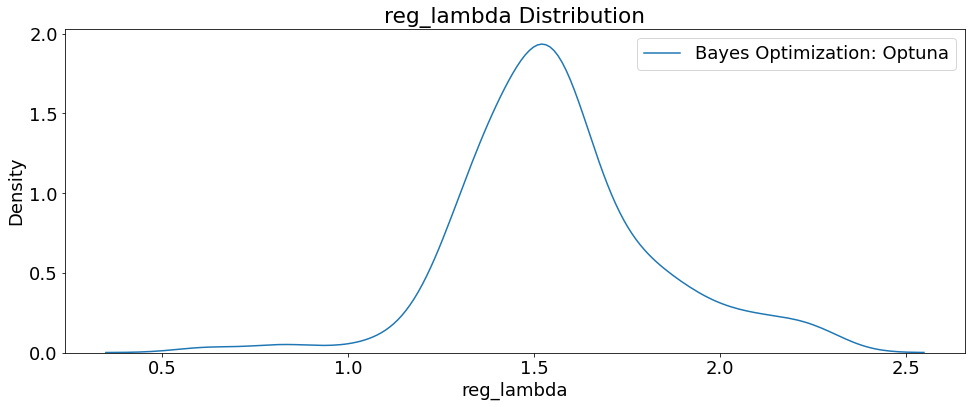

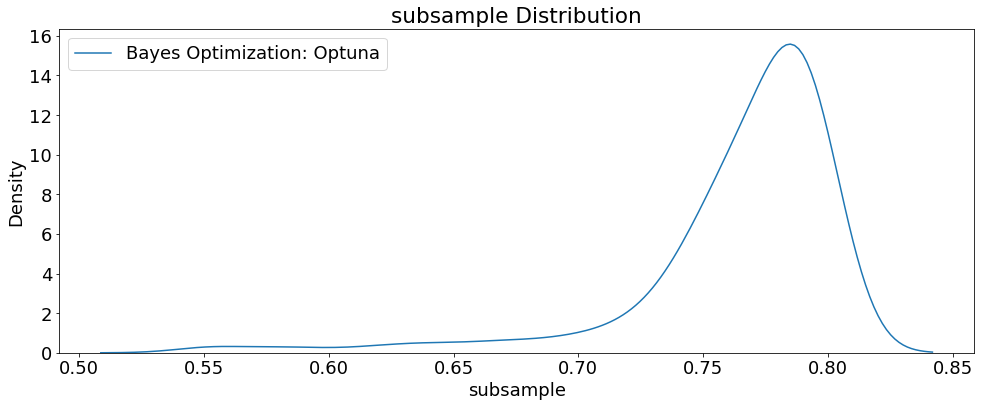

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize = (14, 6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

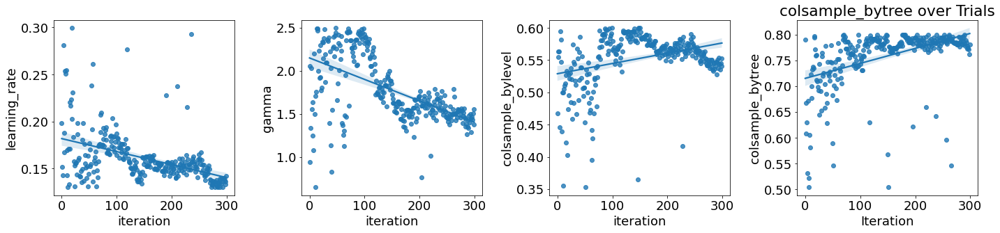

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'gamma', 'colsample_bylevel',
                         'colsample_bytree']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

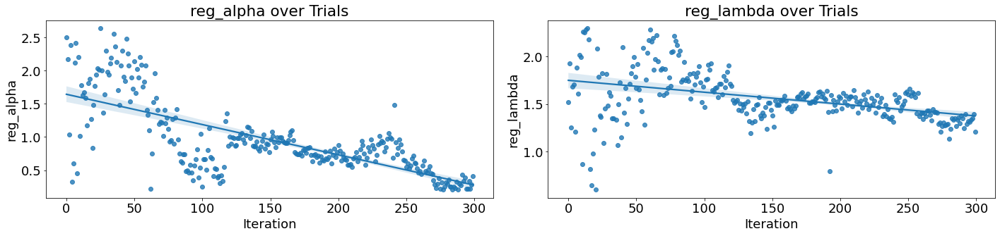

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['reg_alpha', 'reg_lambda']):
        # Scatterplot
        sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
        axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
                   title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params

{'n_estimators': 691,
 'max_depth': 8,
 'subsample': 0.796466106984622,
 'gamma': 1.547512878374652,
 'learning_rate': 0.13800983815031365,
 'reg_alpha': 0.2841773131264607,
 'reg_lambda': 1.4119808147660278,
 'colsample_bytree': 0.7839284986307313,
 'colsample_bylevel': 0.5449365714550495,
 'min_child_weight': 1}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

In [ ]:
# Re-create the best model and train on the training data
best_model = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'xgbRAPIDS_Optuna_SMOTE_300trials_GPU_f1weighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('xgbRAPIDS_Optuna_SMOTE_300trials_GPU_f1weighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost RAPIDS HPO SMOTE 300 trials GPU F1 Weighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for XGBoost RAPIDS HPO SMOTE 300 trials GPU F1 Weighted


Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    377848
           1       1.00      0.91      0.95     54625

    accuracy                           0.99    432473
   macro avg       0.99      0.96      0.97    432473
weighted avg       0.99      0.99      0.99    432473



Confusion matrix:
[[377629    219]
 [  4839  49786]]


Accuracy score : 0.988
Precision score : 0.996
Recall score : 0.911
F1 score : 0.952


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 300 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 300 GPU trials optimization scores 0.95542 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                   271
f1_weighted                            0.993178
datetime_start       2022-09-18 04:15:41.163464
datetime_complete    2022-09-18 04:15:59.718844
duration                 0 days 00:00:18.555380
colsample_bylevel                      0.544937
colsample_bytree                       0.783928
gamma                                  1.547513
learning_rate                           0.13801
max_depth                                   8.0
min_child_weight                            1.0
n_estimators                              691.0
reg_alpha                              0.284177
reg_lambda                             1.411981
subsample                              0.796466
state                                  COMPLETE
Name: 271, dtype: object


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.2847 ± 0.0006,total_pymnt
0.2404 ± 0.0008,out_prncp
0.0829 ± 0.0007,loan_amnt
0.0743 ± 0.0002,installment
0.0675 ± 0.0002,recoveries
0.0296 ± 0.0007,last_pymnt_amnt
0.0279 ± 0.0003,total_rec_int
0.0065 ± 0.0002,int_rate
0.0008 ± 0.0001,total_rec_late_fee
0.0003 ± 0.0000,grade_C


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,total_pymnt,0.284731,0.000322
1,out_prncp,0.240418,0.000402
2,loan_amnt,0.082900,0.000331
3,installment,0.074277,0.000123
4,recoveries,0.067454,0.000094
5,last_pymnt_amnt,0.029555,0.000332
6,total_rec_int,0.027872,0.000129
7,int_rate,0.006538,0.000083
8,total_rec_late_fee,0.000816,0.000030
9,grade_C,0.000321,0.000025


In [ ]:
# Training Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_train)

<Figure size 432x288 with 0 Axes>

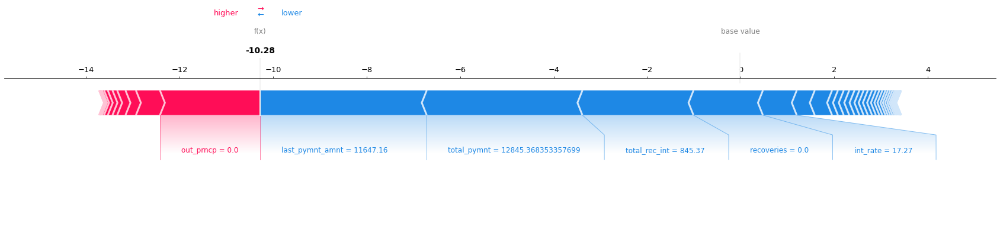

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 5)).savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted_ShapForcePlot_TrainSet.png', 
                                                                      dpi=my_dpi, 
                                                                      bbox_inches='tight');

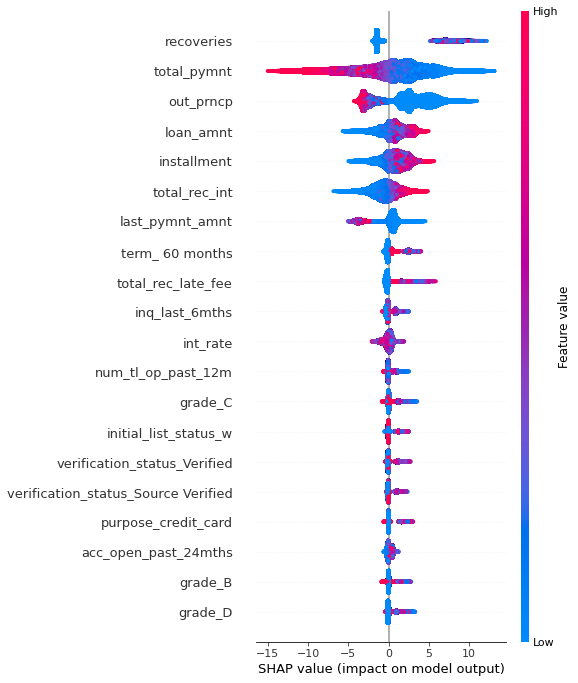

In [ ]:
# Training Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_train.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted_ShapSummary_TrainSet.png', 
            dpi=my_dpi, bbox_inches='tight');

In [ ]:
# Test Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_test)

<Figure size 432x288 with 0 Axes>

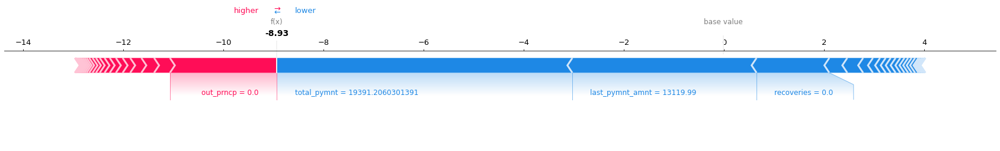

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_test.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 3)).savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted_ShapForcePlot_TestSet.png', 
                                                                      dpi=my_dpi, 
                                                                      bbox_inches='tight');

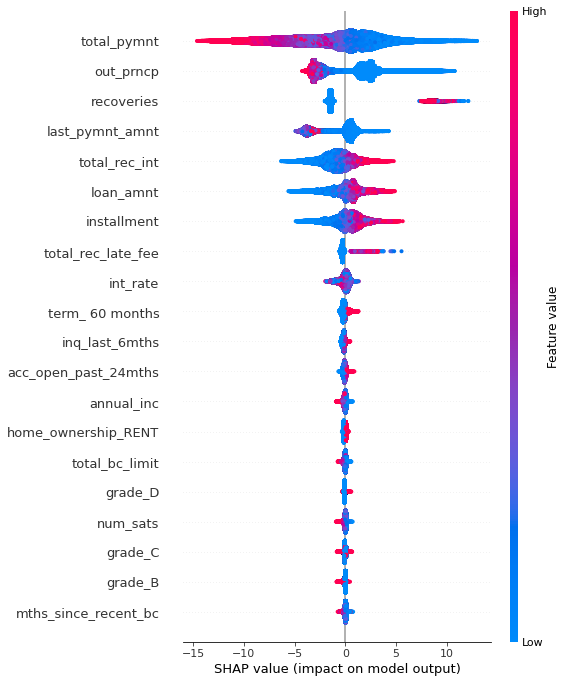

In [ ]:
# Test Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_test.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted_ShapSummary_TestSet.png', 
            dpi=my_dpi, bbox_inches='tight');

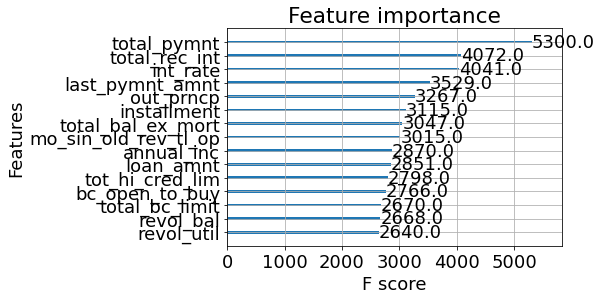

In [ ]:
# Feature importance
plot_importance(best_model, max_num_features=15);

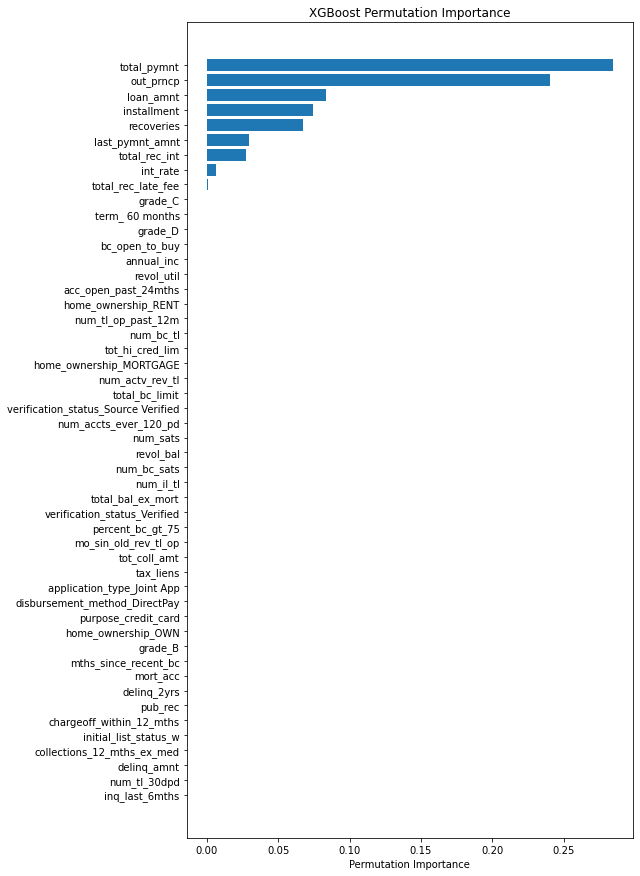

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('XGBoost Permutation Importance')
fig.savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_f1weighted_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

## Precision

### 100 Trials

In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_SMOTE_xgbRapids_precision_tpe'

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

# called us but it's smote
wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_xgb100gpu_trainvaltest_precision', 
                'save_code': 'False', 'notes': 'smote_xgb100gpu_trainvaltest_precision'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: WARNING Calling wandb.login() after wandb.init() has no effect.


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `XGBoostClassifier` model.
    """
    joblib.dump(study, 'xgbRAPIDS_Optuna_SMOTE_100_GPU_precision.pkl')

    # Define parameter grid
    params_xgboost_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'subsample': trial.suggest_float('subsample', 0.25, 0.75),
        'gamma': trial.suggest_float('gamma', 0, 3),
        'learning_rate': trial.suggest_float('learning_rate', 0.0001, 0.3),
        'reg_alpha' : trial.suggest_float('reg_alpha', 0, 3),
        'reg_lambda' : trial.suggest_float('reg_lambda', 0, 3),
        'colsample_bytree' : trial.suggest_float('colsample_bytree', 0.5, 0.99),
        'colsample_bylevel' : trial.suggest_float('colsample_bylevel', 0.05, 0.5), 
        'min_child_weight' : trial.suggest_int('min_child_weight', 1, 10),
    }    

    # Define model type
    xgb = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params_xgboost_optuna)
    
    # Start timer for each trial
    start = timer()

    xgb.fit(X_train, y_train, 
            eval_set=[(X_val, y_val)], 
            verbose=0)    
    
    # Predictions
    y_pred_val = xgb.predict(X_val)
    score = precision_score(asnumpy(y_val), asnumpy(y_pred_val))
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial precision:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('xgbRAPIDS_Optuna_SMOTE_100_GPU_precision.pkl'): 
        study = joblib.load('xgbRAPIDS_Optuna_SMOTE_100_GPU_precision.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=100)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Precision Score', study.best_value)
wandb.finish()

- Trial time: 8.8831373360008
- Trial precision: 0.9997856678789827
######################################################
- Trial time: 10.717987562995404
- Trial precision: 0.9995977242687202
######################################################
- Trial time: 13.448285138001665
- Trial precision: 0.9997622157473458
######################################################
- Trial time: 2.5028783809393644
- Trial precision: 0.9509877529653253
######################################################
- Trial time: 4.367230091011152
- Trial precision: 0.9996235386686835
######################################################
- Trial time: 10.91787431400735
- Trial precision: 0.9959858182023232
######################################################
- Trial time: 12.527197615010664
- Trial precision: 0.9996712931595436
######################################################
- Trial time: 6.798303646966815
- Trial precision: 0.999801870477022
######################################################

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'precision'},inplace=True)
trials_df.rename(columns={'params_colsample_bylevel':'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree':'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma':'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate':'learning_rate'}, inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight':'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha':'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda':'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample':'subsample'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('precision', ascending=False)
trials_df.to_csv('xgbRAPIDS_Optuna_SMOTE_100_GPU_precision.csv', index=False)
print(trials_df) 

    iteration  precision             datetime_start  \
55         55   0.999902 2022-09-17 04:41:33.477359   
70         70   0.999899 2022-09-17 04:45:39.767151   
72         72   0.999896 2022-09-17 04:46:21.789390   
77         77   0.999892 2022-09-17 04:48:03.608160   
53         53   0.999891 2022-09-17 04:40:56.689010   
..        ...        ...                        ...   
20         20   0.998321 2022-09-17 04:35:23.560140   
39         39   0.998319 2022-09-17 04:37:52.633004   
5           5   0.995986 2022-09-17 04:33:08.876995   
3           3   0.950988 2022-09-17 04:33:01.294330   
99         99        NaN 2022-09-17 04:55:36.800396   

            datetime_complete               duration  colsample_bylevel  \
55 2022-09-17 04:41:50.091424 0 days 00:00:16.614065           0.162007   
70 2022-09-17 04:46:00.163413 0 days 00:00:20.396262           0.217745   
72 2022-09-17 04:46:42.004594 0 days 00:00:20.215204           0.163144   
77 2022-09-17 04:48:22.946151 0 days 00

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_xgbRAPIDS_Optuna_SMOTE_100_GPU_precision.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_xgbRAPIDS_Optuna_SMOTE_100_GPU_precision.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_xgbRAPIDS_Optuna_SMOTE_100_GPU_precision.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'learning_rate', 
                                                       'gamma'])
py.plot(fig, filename='contour_xgbRAPIDS_Optuna_SMOTE_100_GPU_precision.html')
fig.show()

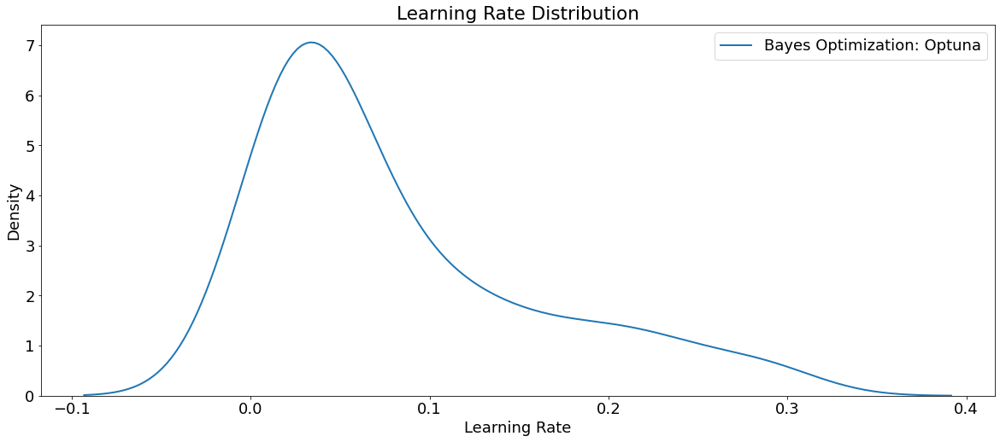

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc = 1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

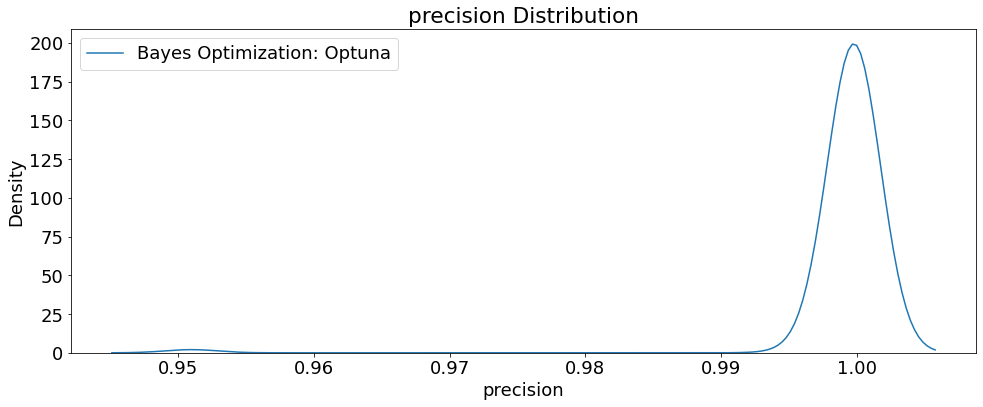

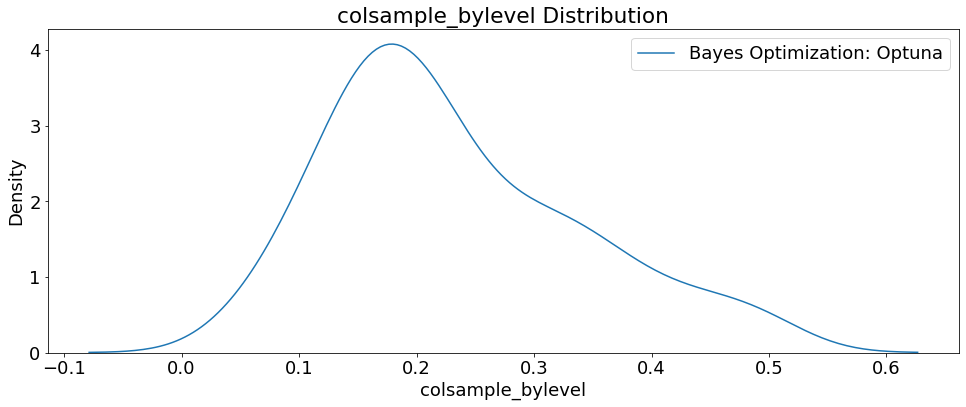

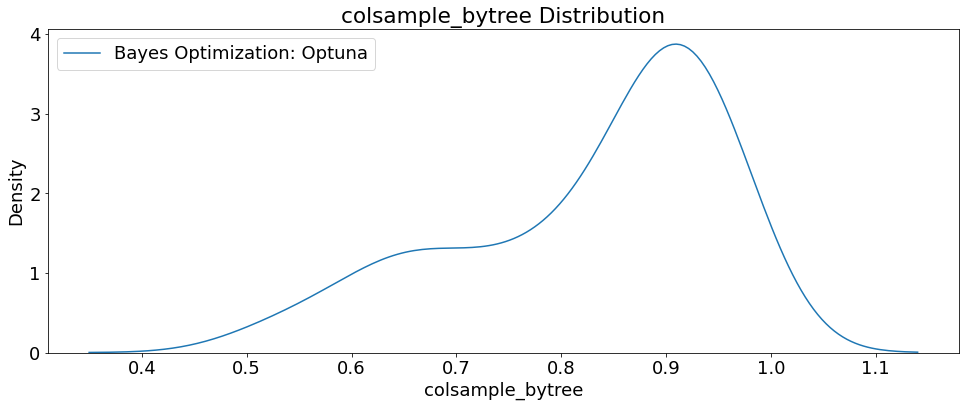

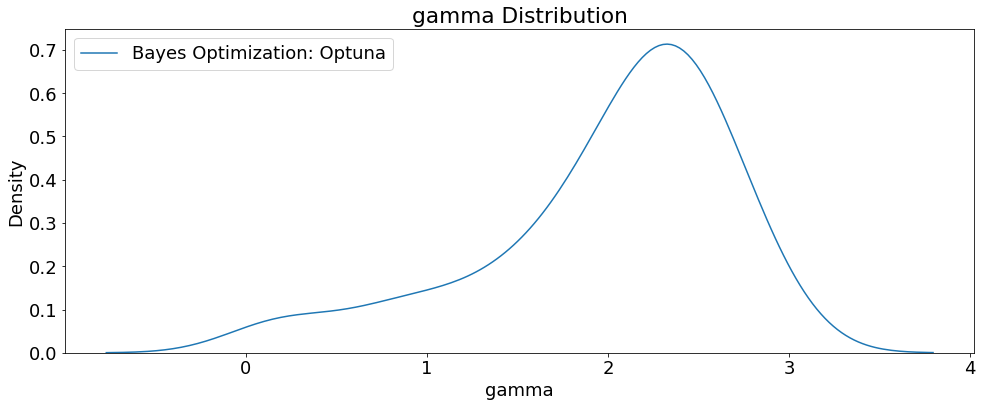

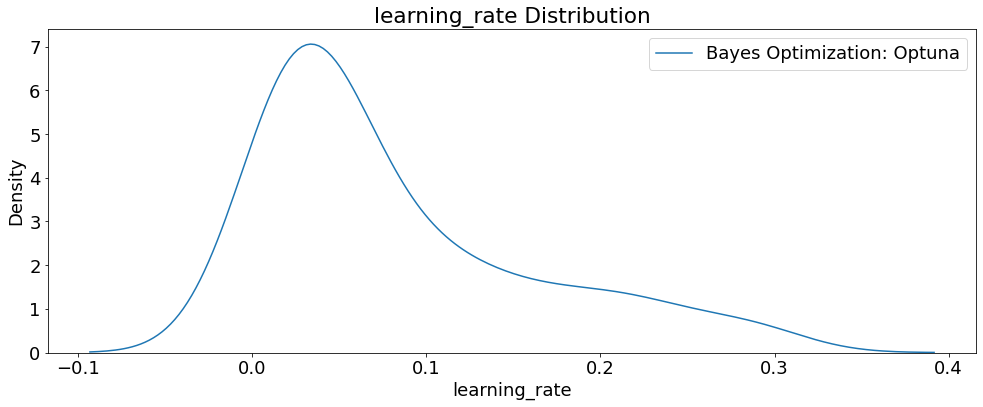

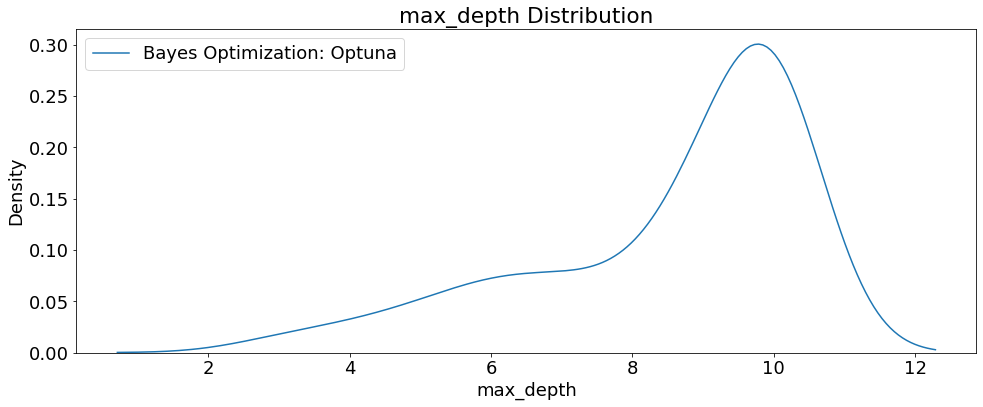

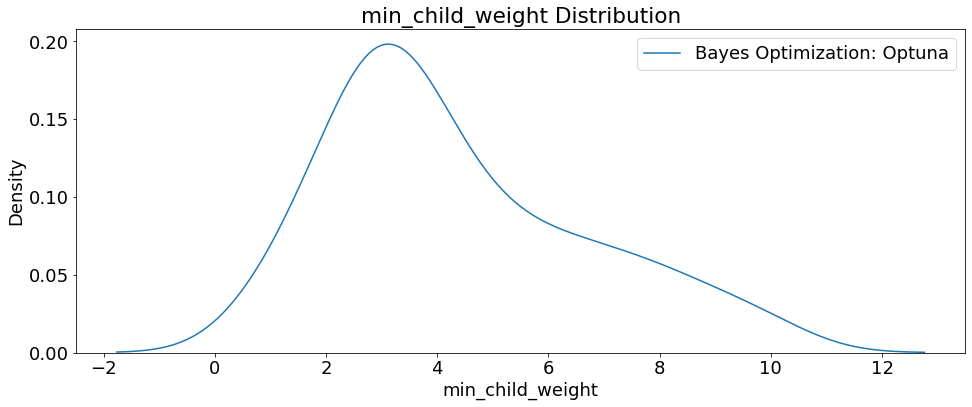

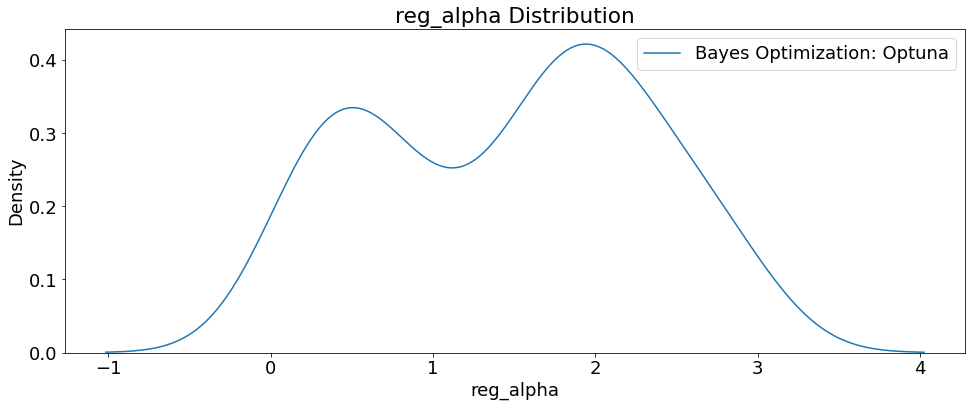

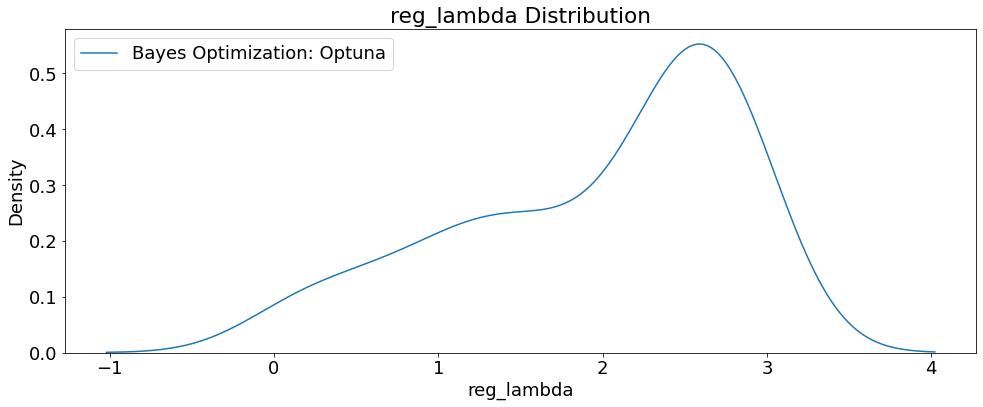

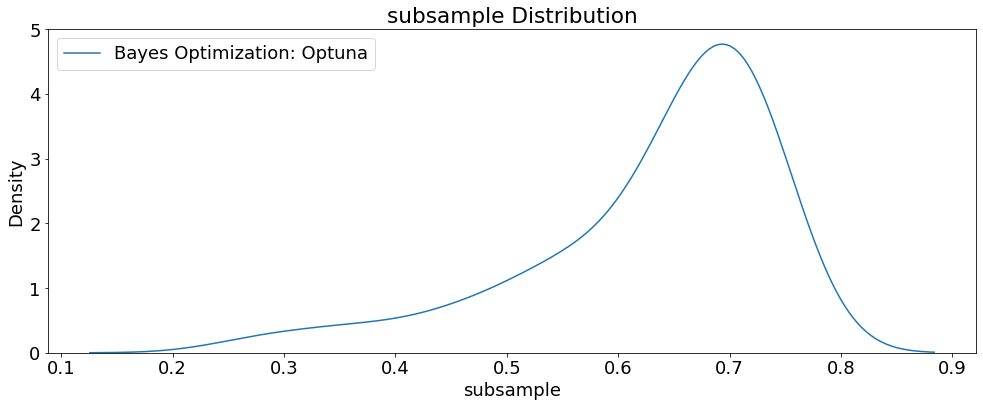

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize = (14, 6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

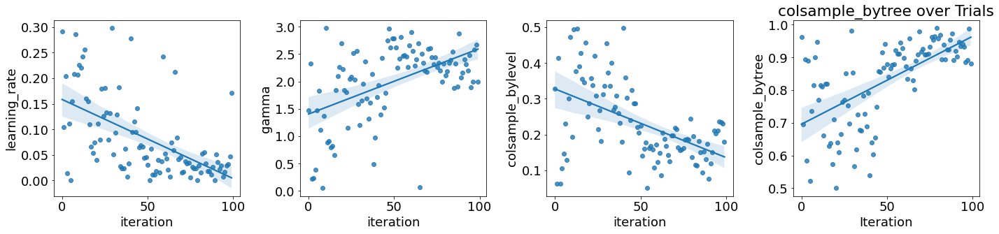

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'gamma', 'colsample_bylevel',
                         'colsample_bytree']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

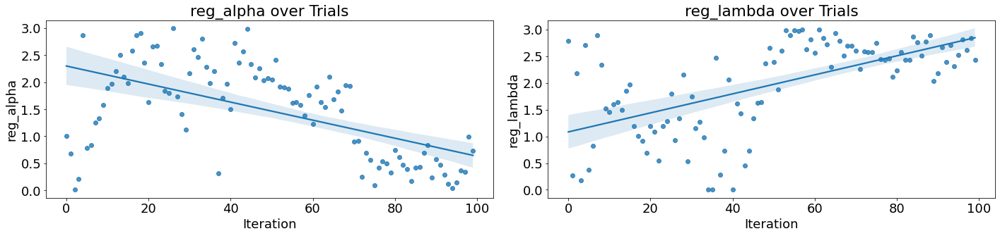

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['reg_alpha', 'reg_lambda']):
        # Scatterplot
        sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
        axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
                   title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_xgbRAPIDS_Optuna_SMOTE_100_GPU_precision.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_xgbRAPIDS_Optuna_SMOTE_100_GPU_precision.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params

{'n_estimators': 364,
 'max_depth': 10,
 'subsample': 0.6560417517523364,
 'gamma': 2.469903006343567,
 'learning_rate': 0.018116501718105575,
 'reg_alpha': 1.6227182590965568,
 'reg_lambda': 2.9823175467824856,
 'colsample_bytree': 0.9219884040885981,
 'colsample_bylevel': 0.16200660357462832,
 'min_child_weight': 3}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

In [ ]:
# Re-create the best model and train on the training data
best_model = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'xgbRAPIDS_Optuna_SMOTE_100trials_GPU_precision.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('xgbRAPIDS_Optuna_SMOTE_100trials_GPU_precision.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost RAPIDS HPO SMOTE 100 trials GPU Precision')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for XGBoost RAPIDS HPO SMOTE 100 trials GPU Precision


Classification Report:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99    377848
           1       1.00      0.86      0.93     54625

    accuracy                           0.98    432473
   macro avg       0.99      0.93      0.96    432473
weighted avg       0.98      0.98      0.98    432473



Confusion matrix:
[[377783     65]
 [  7562  47063]]


Accuracy score : 0.982
Precision score : 0.999
Recall score : 0.862
F1 score : 0.925


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 100 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 100 GPU trials optimization scores 0.93070 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    55
precision                              0.999902
datetime_start       2022-09-17 04:41:33.477359
datetime_complete    2022-09-17 04:41:50.091424
duration                 0 days 00:00:16.614065
colsample_bylevel                      0.162007
colsample_bytree                       0.921988
gamma                                  2.469903
learning_rate                          0.018117
max_depth                                  10.0
min_child_weight                            3.0
n_estimators                              364.0
reg_alpha                              1.622718
reg_lambda                             2.982318
subsample                              0.656042
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_100_GPU_precision_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_100_GPU_precision_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1796 ± 0.0009,out_prncp
0.0794 ± 0.0002,recoveries
0.0650 ± 0.0003,total_pymnt
0.0125 ± 0.0001,last_pymnt_amnt
0.0089 ± 0.0001,loan_amnt
0.0077 ± 0.0002,installment
0.0021 ± 0.0001,total_rec_int
0.0010 ± 0.0001,total_rec_late_fee
0.0009 ± 0.0000,term_ 60 months
0.0002 ± 0.0001,annual_inc


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('xgbRAPIDS_Optuna_SMOTE_100_GPU_precision_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,out_prncp,0.179575,0.000458
1,recoveries,0.079381,0.000083
2,total_pymnt,0.065018,0.000138
3,last_pymnt_amnt,0.012546,0.000070
4,loan_amnt,0.008893,0.000069
5,installment,0.007671,0.000103
6,total_rec_int,0.002080,0.000028
7,total_rec_late_fee,0.000959,0.000027
8,term_ 60 months,0.000902,0.000023
9,annual_inc,0.000247,0.000027


In [ ]:
# Training Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_train)

<Figure size 432x288 with 0 Axes>

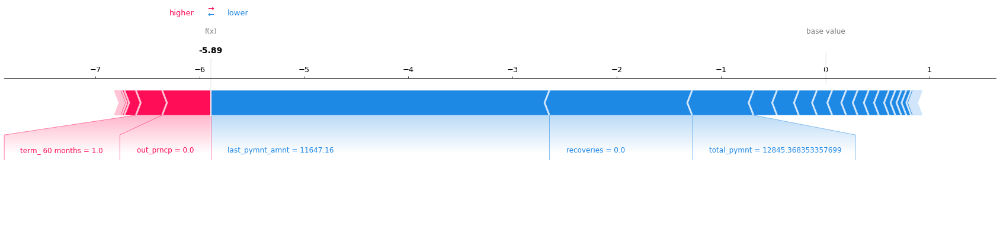

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 5)).savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_precision_ShapForcePlot_TrainSet.png', 
                                                                      dpi=my_dpi, 
                                                                      bbox_inches='tight');

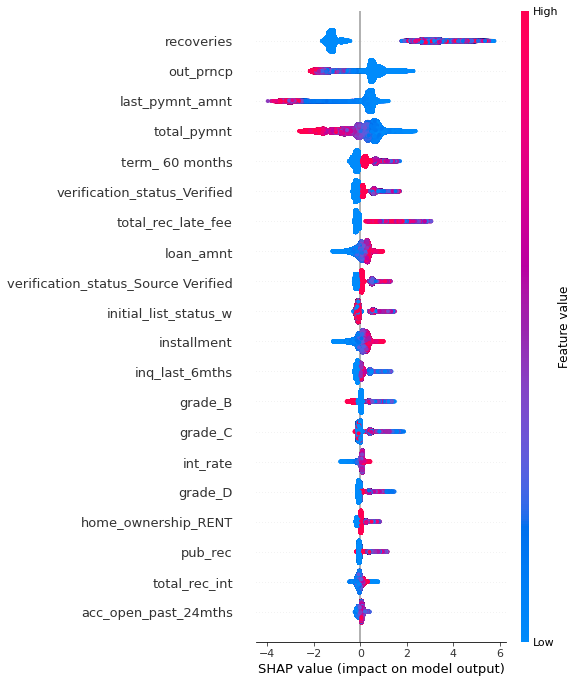

In [ ]:
# Training Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_train.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_precision_ShapSummary_TrainSet.png', 
            dpi=my_dpi, bbox_inches='tight');

In [ ]:
# Test Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_test)

<Figure size 432x288 with 0 Axes>

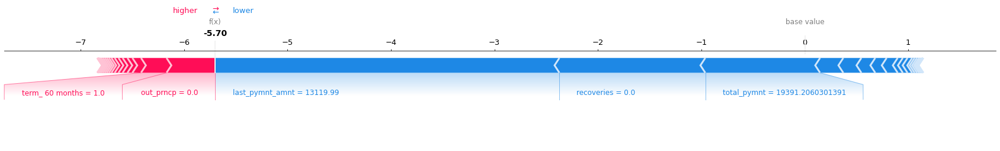

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_test.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 3)).savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_precision_ShapForcePlot_TestSet.png', 
                                                                      dpi=my_dpi, 
                                                                      bbox_inches='tight');

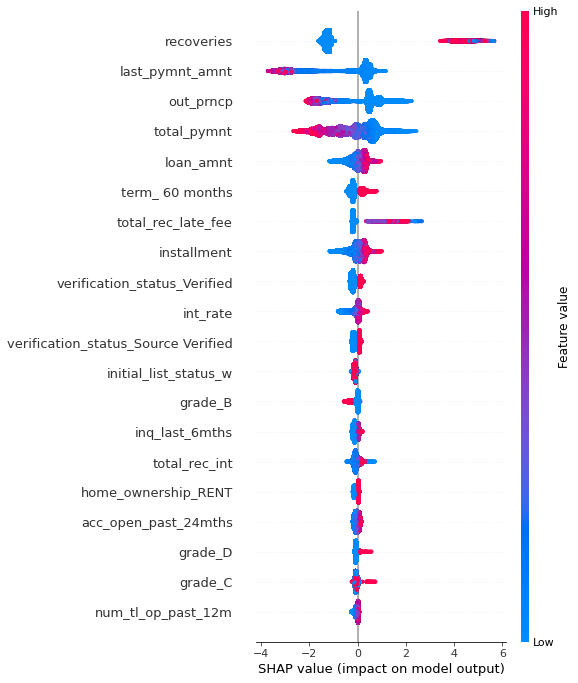

In [ ]:
# Test Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_test.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_precision_ShapSummary_TestSet.png', 
            dpi=my_dpi, bbox_inches='tight');

<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

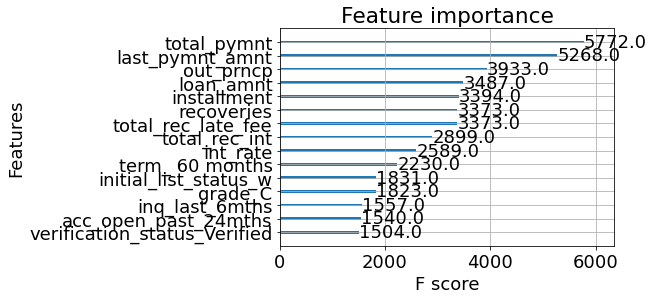

In [ ]:
# Feature importance
plot_importance(best_model, max_num_features=15);

<Figure size 432x288 with 0 Axes>

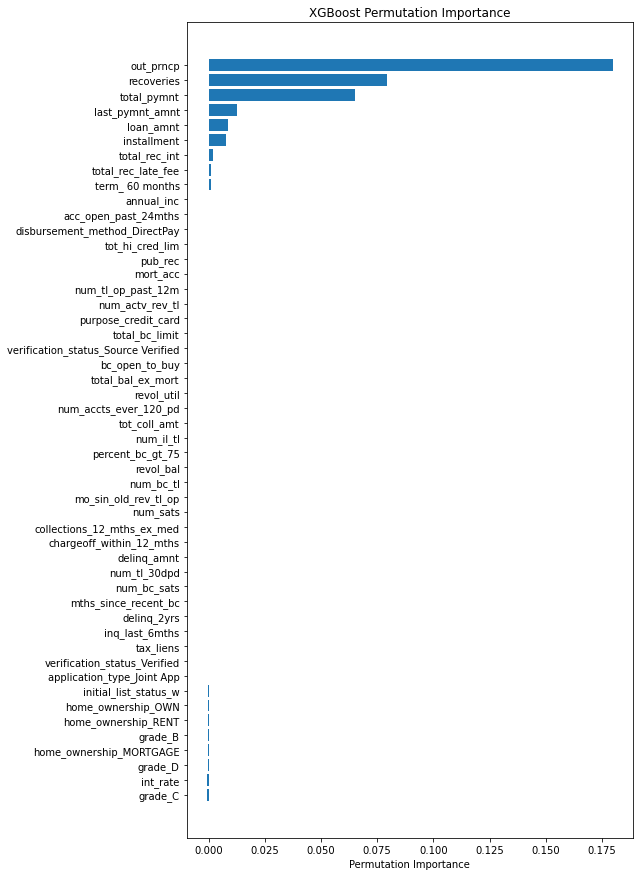

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('XGBoost Permutation Importance')
fig.savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_precision_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

### 300 Trials

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_SMOTE_xgbRapids_precision_300_tpe'

In [ ]:
# Set up wandb
wandb.login()

# called us but it's smote
wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_xgb300gpu_trainvaltest_precision', 
                'save_code': 'False', 'notes': 'smote_xgb300gpu_trainvaltest_precision'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `XGBoostClassifier` model.
    """
    joblib.dump(study, 'xgbRAPIDS_Optuna_SMOTE_300_GPU_precision.pkl')

    # Define parameter grid
    params_xgboost_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 400, 700),
        'max_depth': trial.suggest_int('max_depth', 7, 20),
        'subsample': trial.suggest_float('subsample', 0.5, 0.8),
        'gamma': trial.suggest_float('gamma', 0.8, 3),
        'learning_rate': trial.suggest_float('learning_rate', 0.001, 0.3),
        'reg_alpha' : trial.suggest_float('reg_alpha', 0.04, 2.3),
        'reg_lambda' : trial.suggest_float('reg_lambd', 1, 3),
        'colsample_bytree' : trial.suggest_float('colsample_bytree', 0.6, 0.99),
        'colsample_bylevel' : trial.suggest_float('colsample_bylevel', 0.1, 0.5), 
        'min_child_weight' : trial.suggest_int('min_child_weight', 1, 8),
    }    

    # Define model type
    xgb = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params_xgboost_optuna)
    
    # Start timer for each trial
    start = timer()

    xgb.fit(X_train, y_train, 
            eval_set=[(X_val, y_val)], 
            verbose=0)    
    
    # Predictions
    y_pred_val = xgb.predict(X_val)
    score = precision_score(asnumpy(y_val), asnumpy(y_pred_val))
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial precision:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('xgbRAPIDS_Optuna_SMOTE_300_GPU_precision.pkl'): 
        study = joblib.load('xgbRAPIDS_Optuna_SMOTE_300_GPU_precision.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=100)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Precision Score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 17.554138665960636
- Trial precision: 0.9990621524940044
######################################################
- Trial time: 9.004997754003853
- Trial precision: 0.9994403185157381
######################################################
- Trial time: 19.879107830987778
- Trial precision: 0.9989984323288625
######################################################
- Trial time: 8.340757442987524
- Trial precision: 0.9992630507021117
######################################################
- Trial time: 14.118313865037635
- Trial precision: 0.9992696670619845
######################################################
- Trial time: 22.615688089979813
- Trial precision: 0.9992862528273435
######################################################
- Trial time: 17.981653077993542
- Trial precision: 0.9988881781861899
######################################################
- Trial time: 32.1614827500307
- Trial precision: 0.9997444691009347
###################################################

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'precision'},inplace=True)
trials_df.rename(columns={'params_colsample_bylevel':'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree':'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma':'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate':'learning_rate'}, inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight':'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha':'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda':'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample':'subsample'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('precision', ascending=False)
trials_df.to_csv('xgbRAPIDS_Optuna_SMOTE_300_GPU_precision.csv', index=False)
print(trials_df) 

    iteration  precision             datetime_start  \
49         49   0.999966 2022-09-18 14:53:23.905230   
44         44   0.999962 2022-09-18 14:49:44.330791   
59         59   0.999946 2022-09-18 14:59:34.050293   
94         94   0.999946 2022-09-18 15:20:19.012648   
36         36   0.999939 2022-09-18 14:43:55.666624   
..        ...        ...                        ...   
62         62   0.999035 2022-09-18 15:01:18.430353   
2           2   0.998998 2022-09-18 14:24:52.986797   
52         52   0.998945 2022-09-18 14:55:30.212586   
6           6   0.998888 2022-09-18 14:25:59.570974   
48         48   0.998758 2022-09-18 14:53:06.615215   

            datetime_complete               duration  colsample_bylevel  \
49 2022-09-18 14:54:26.245862 0 days 00:01:02.340632           0.276830   
44 2022-09-18 14:50:52.110557 0 days 00:01:07.779766           0.246191   
59 2022-09-18 15:00:15.215400 0 days 00:00:41.165107           0.303802   
94 2022-09-18 15:21:05.337263 0 days 00

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_xgbRAPIDS_Optuna_SMOTE_300_GPU_precision.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_xgbRAPIDS_Optuna_SMOTE_300_GPU_precision.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_xgbRAPIDS_Optuna_SMOTE_300_GPU_precision.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'learning_rate', 
                                                       'gamma'])
py.plot(fig, filename='contour_xgbRAPIDS_Optuna_SMOTE_300_GPU_precision.html')
fig.show()

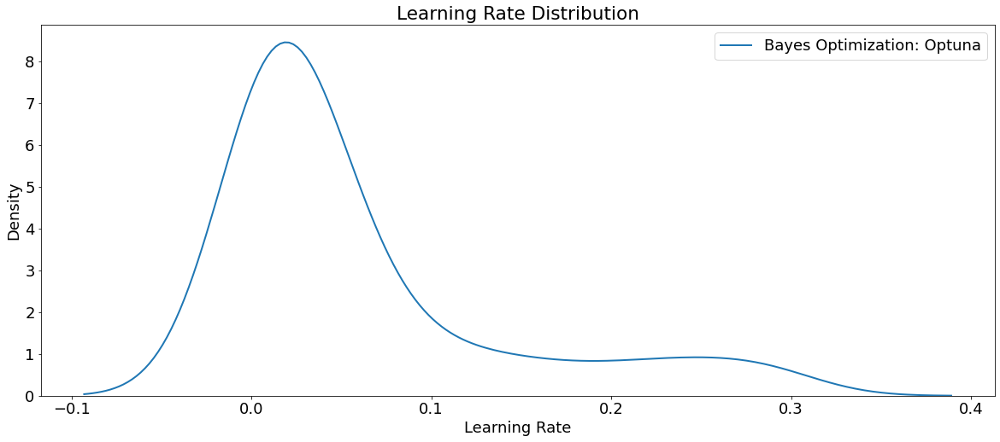

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc = 1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

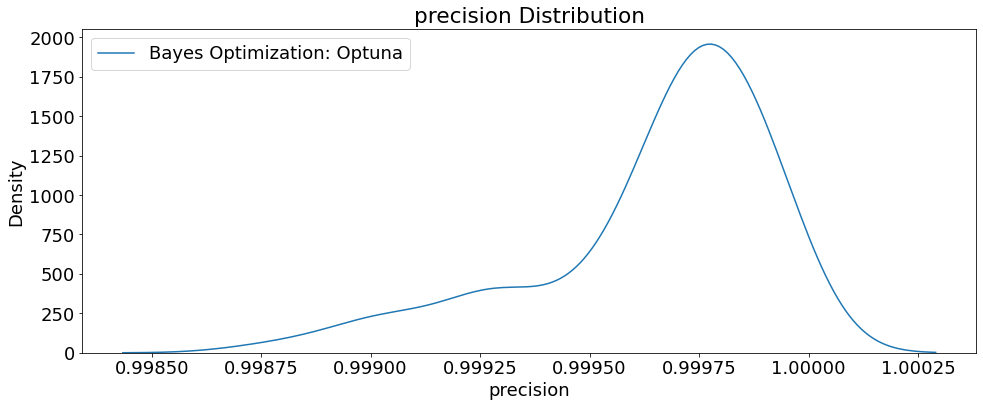

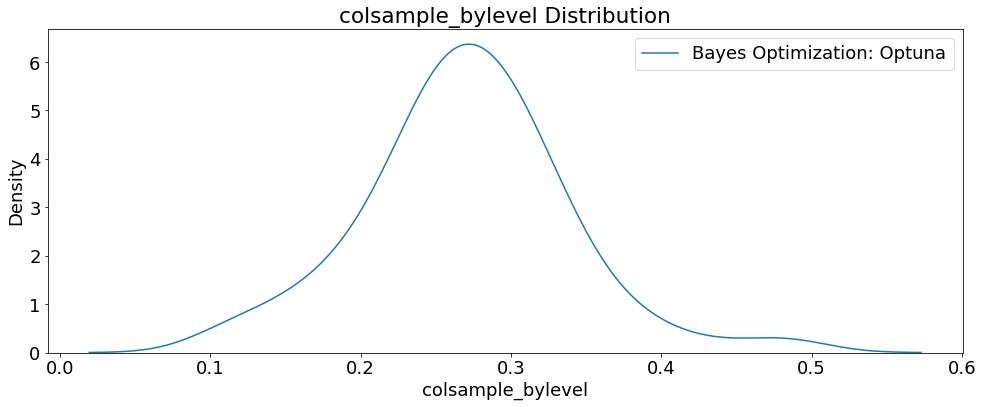

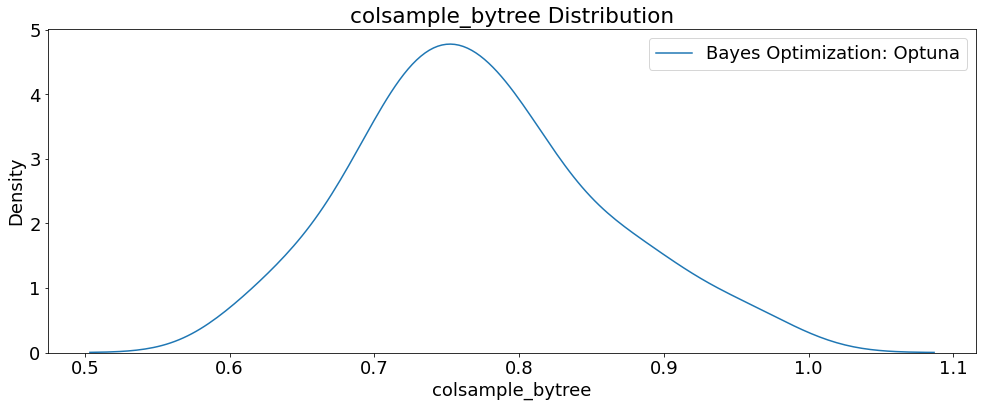

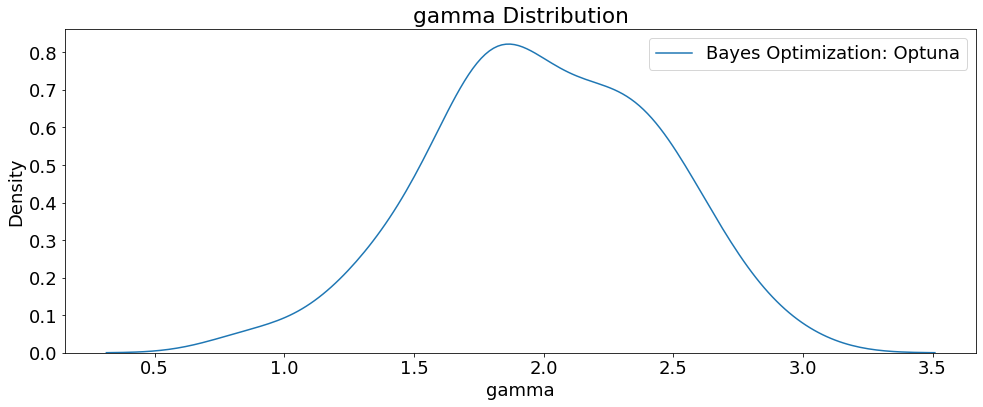

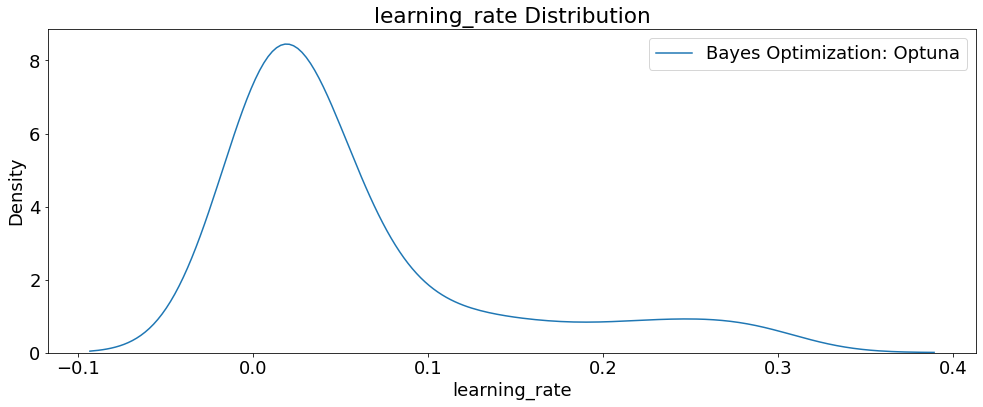

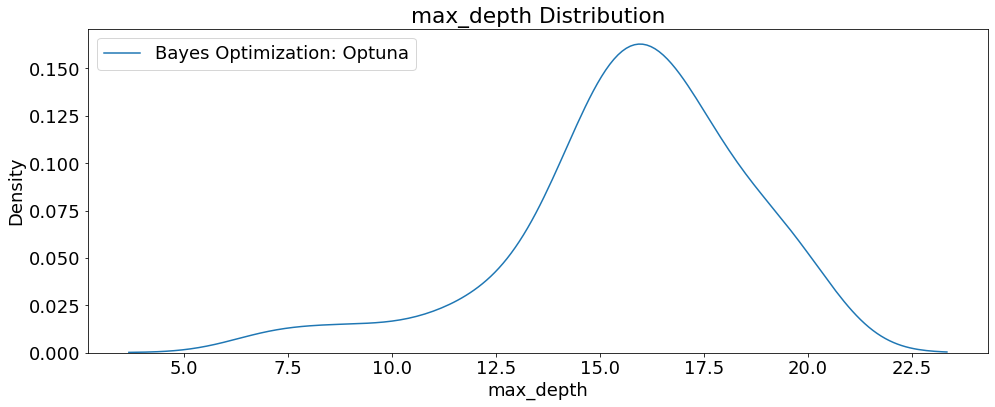

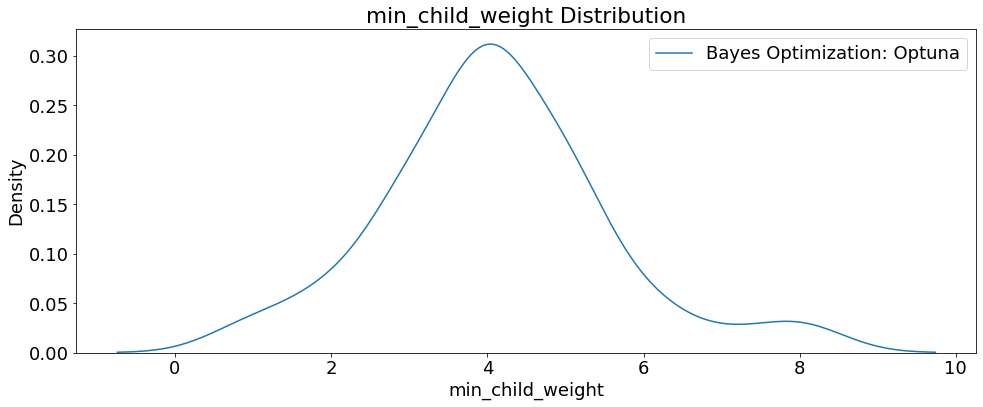

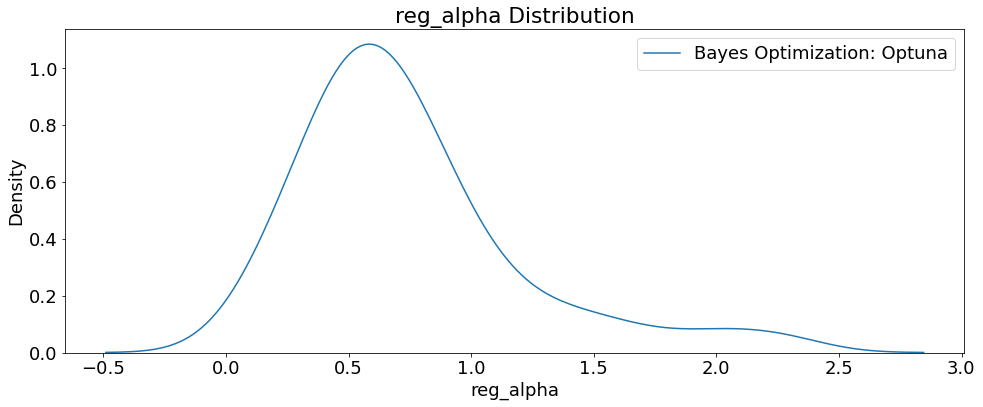

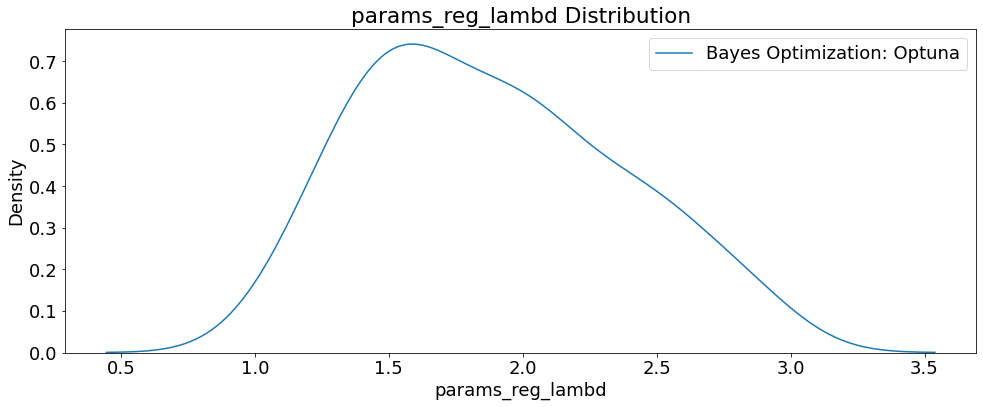

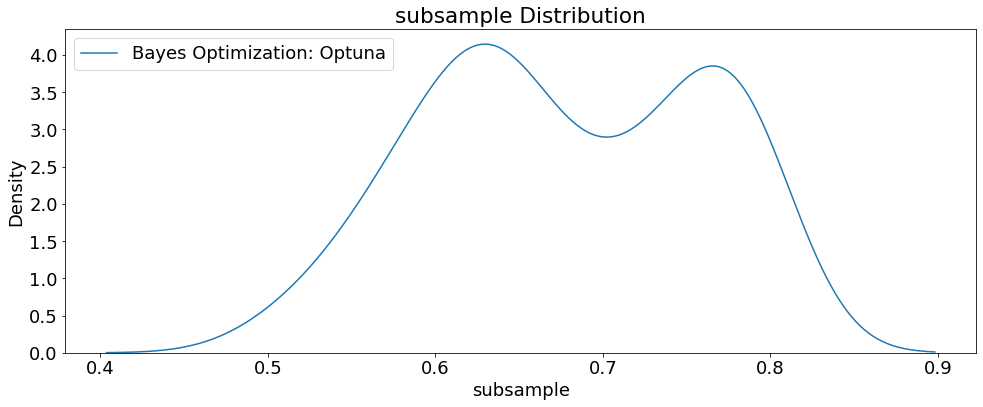

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize = (14, 6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

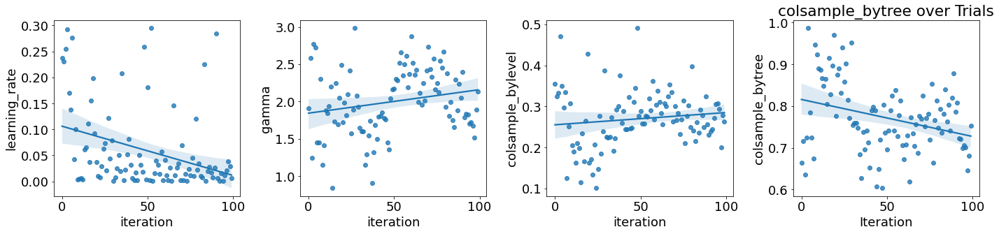

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'gamma', 'colsample_bylevel',
                         'colsample_bytree']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

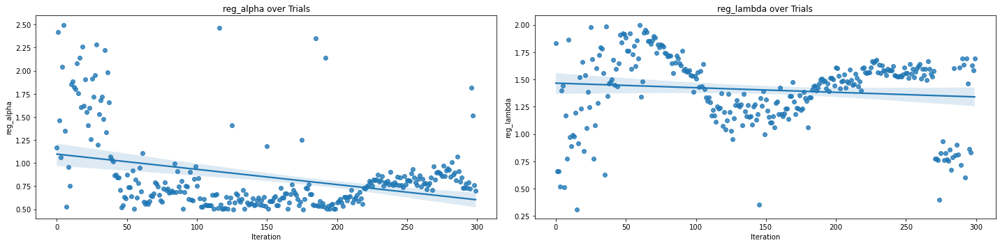

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['reg_alpha', 'reg_lambda']):
        # Scatterplot
        sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
        axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
                   title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_xgbRAPIDS_Optuna_SMOTE_300_GPU_precision.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_xgbRAPIDS_Optuna_SMOTE_300_GPU_precision.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params

{'n_estimators': 491,
 'max_depth': 15,
 'subsample': 0.7604888319527146,
 'gamma': 0.04087059120394826,
 'learning_rate': 0.15906588784061876,
 'reg_alpha': 0.5297264561831198,
 'reg_lambda': 1.4839744523445213,
 'colsample_bytree': 0.8416926592684433,
 'colsample_bylevel': 0.5774439932010007,
 'min_child_weight': 1}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

In [ ]:
# Re-create the best model and train on the training data
best_model = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'xgbRAPIDS_Optuna_SMOTE_300trials_GPU_precision.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('xgbRAPIDS_Optuna_SMOTE_300trials_GPU_precision.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost RAPIDS HPO SMOTE 300 trials GPU Precision')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for XGBoost RAPIDS HPO SMOTE 300 trials GPU Precision


Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    377848
           1       1.00      0.91      0.95     54625

    accuracy                           0.99    432473
   macro avg       0.99      0.95      0.97    432473
weighted avg       0.99      0.99      0.99    432473



Confusion matrix:
[[377654    194]
 [  4911  49714]]


Accuracy score : 0.988
Precision score : 0.996
Recall score : 0.910
F1 score : 0.951


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 300 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 300 GPU trials optimization scores 0.95479 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                   191
f1_weighted                            0.999247
datetime_start       2022-09-17 23:42:18.359414
datetime_complete    2022-09-17 23:43:16.500515
duration                 0 days 00:00:58.141101
colsample_bylevel                      0.577444
colsample_bytree                       0.841693
gamma                                  0.040871
learning_rate                          0.159066
max_depth                                    15
min_child_weight                              1
n_estimators                                491
reg_alpha                              0.529726
reg_lambda                             1.483974
subsample                              0.760489
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_300_GPU_precision_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_300_GPU_precision_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.2377 ± 0.0011,out_prncp
0.2280 ± 0.0002,total_pymnt
0.0675 ± 0.0002,recoveries
0.0401 ± 0.0003,installment
0.0399 ± 0.0004,loan_amnt
0.0241 ± 0.0003,last_pymnt_amnt
0.0114 ± 0.0001,total_rec_int
0.0042 ± 0.0002,int_rate
0.0010 ± 0.0000,grade_C
0.0007 ± 0.0001,total_rec_late_fee


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('xgbRAPIDS_Optuna_SMOTE_300_GPU_precision_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,out_prncp,0.237704,0.000535
1,total_pymnt,0.227980,0.000120
2,recoveries,0.067495,0.000087
3,installment,0.040084,0.000127
4,loan_amnt,0.039862,0.000192
5,last_pymnt_amnt,0.024068,0.000173
6,total_rec_int,0.011421,0.000055
7,int_rate,0.004233,0.000114
8,grade_C,0.001040,0.000020
9,total_rec_late_fee,0.000690,0.000027


In [ ]:
# Training Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_train)

<Figure size 432x288 with 0 Axes>

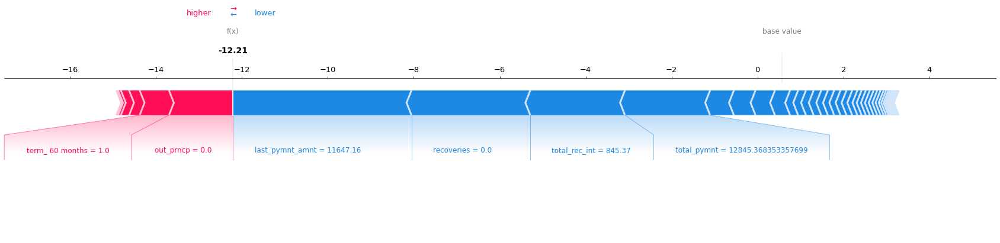

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 5)).savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_precision_ShapForcePlot_TrainSet.png', 
                                                                      dpi=my_dpi, 
                                                                      bbox_inches='tight');

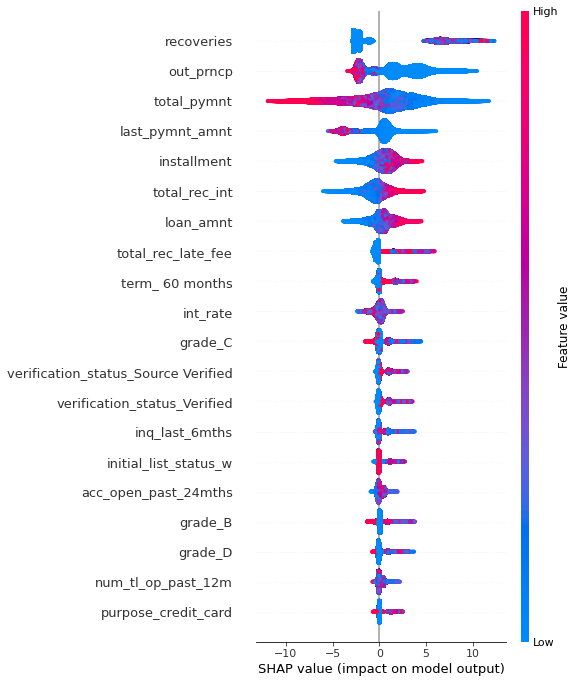

In [ ]:
# Training Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_train.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_precision_ShapSummary_TrainSet.png', 
            dpi=my_dpi, bbox_inches='tight');

In [ ]:
# Test Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_test)

<Figure size 432x288 with 0 Axes>

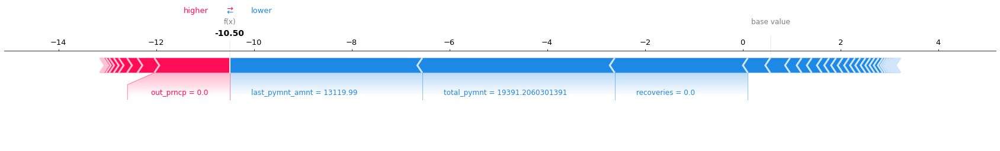

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_test.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 3)).savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_precision_ShapForcePlot_TestSet.png', 
                                                                      dpi=my_dpi, 
                                                                      bbox_inches='tight');

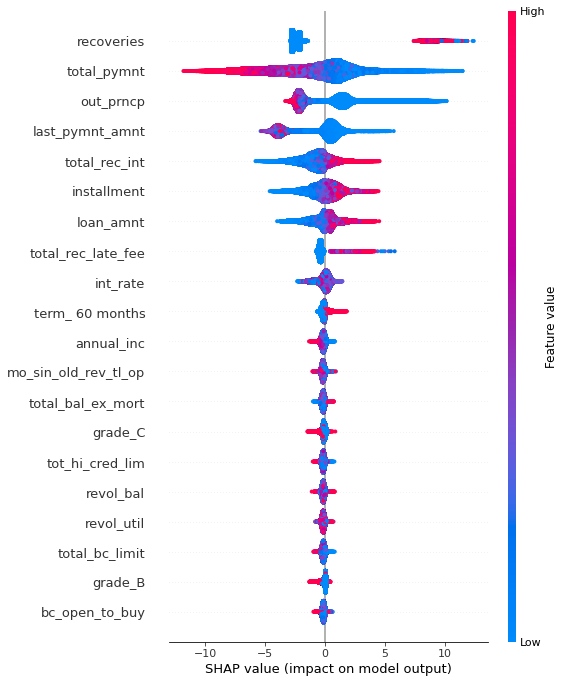

In [ ]:
# Test Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_test.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_precision_ShapSummary_TestSet.png', 
            dpi=my_dpi, bbox_inches='tight');

<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

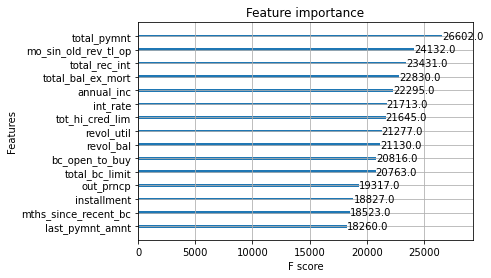

In [ ]:
# Feature importance
plot_importance(best_model, max_num_features=15);

<Figure size 432x288 with 0 Axes>

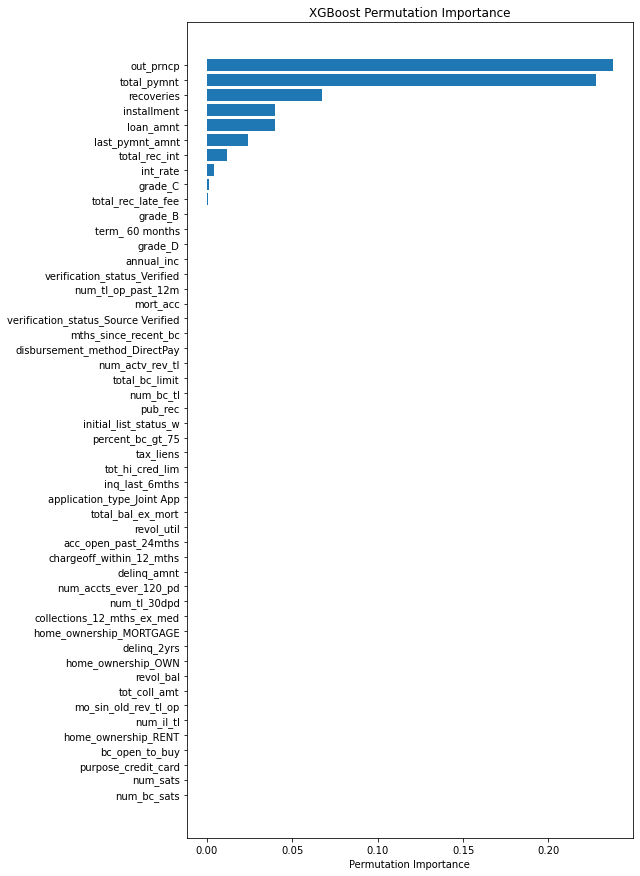

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('XGBoost Permutation Importance')
fig.savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_precision_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

## Recall

### 100 Trials

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_SMOTE_xgbRapids_recall_tpe'

In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_xgb100gpu_trainvaltest_recall', 
                'save_code': 'False', 'notes': 'SMOTE_xgb100gpu_trainvaltest_recall'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `XGBoostClassifier` model.
    """
    joblib.dump(study, 'xgbRAPIDS_Optuna_SMOTE_100_GPU_recall.pkl')

    # Define parameter grid
    params_xgboost_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'subsample': trial.suggest_float('subsample', 0.25, 0.75),
        'gamma': trial.suggest_float('gamma', 0, 3),
        'learning_rate': trial.suggest_float('learning_rate', 0.0001, 0.3),
        'reg_alpha' : trial.suggest_float('reg_alpha', 0, 3),
        'reg_lambda' : trial.suggest_float('reg_lambda', 0, 3),
        'colsample_bytree' : trial.suggest_float('colsample_bytree', 0.5, 0.99),
        'colsample_bylevel' : trial.suggest_float('colsample_bylevel', 0.05, 0.5), 
        'min_child_weight' : trial.suggest_int('min_child_weight', 1, 10),
    }    

    # Define model type
    xgb = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params_xgboost_optuna)
    
    # Start timer for each trial
    start = timer()

    xgb.fit(X_train, y_train, 
            eval_set=[(X_val, y_val)], 
            verbose=0)    
    
    # Predictions
    y_pred_val = xgb.predict(X_val)
    score = recall_score(asnumpy(y_val), asnumpy(y_pred_val))
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial recall:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('xgbRAPIDS_Optuna_SMOTE_100_GPU_recall.pkl'): 
        study = joblib.load('xgbRAPIDS_Optuna_SMOTE_100_GPU_recall.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=100)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Recall Score', study.best_value)
wandb.finish()

- Trial time: 7.652859294088557
- Trial recall: 0.9860414784516565
######################################################
- Trial time: 4.602590783964843
- Trial recall: 0.9800616186987269
######################################################
- Trial time: 9.506979004014283
- Trial recall: 0.9832683060814545
######################################################
- Trial time: 10.27126844599843
- Trial recall: 0.9624331112809872
######################################################
- Trial time: 10.151814072974958
- Trial recall: 0.9638263160158977
######################################################
- Trial time: 15.429365449002944
- Trial recall: 0.9875902191070914
######################################################
- Trial time: 2.8020697759930044
- Trial recall: 0.9743564287628937
######################################################
- Trial time: 11.779748833971098
- Trial recall: 0.987332095664519
######################################################
- Trial time: 13.6137

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'recall'},inplace=True)
trials_df.rename(columns={'params_colsample_bylevel':'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree':'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma':'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate':'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight':'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha':'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda':'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample':'subsample'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('recall', ascending=False)
trials_df.to_csv('xgbRAPIDS_Optuna_SMOTE_100_GPU_recall.csv', index=False)
print(trials_df) 

    iteration    recall             datetime_start          datetime_complete  \
16         16  0.992952 2022-09-17 13:40:44.266320 2022-09-17 13:40:54.458737   
17         17  0.992947 2022-09-17 13:40:54.458961 2022-09-17 13:41:07.350796   
84         84  0.992939 2022-09-17 13:51:48.821359 2022-09-17 13:52:00.623995   
90         90  0.992939 2022-09-17 13:52:51.922340 2022-09-17 13:53:00.520002   
54         54  0.992934 2022-09-17 13:46:50.715572 2022-09-17 13:47:01.053991   
..        ...       ...                        ...                        ...   
20         20  0.987191 2022-09-17 13:41:34.698526 2022-09-17 13:41:41.433864   
0           0  0.986162 2022-09-17 13:38:19.849782 2022-09-17 13:38:33.032042   
14         14  0.980954 2022-09-17 13:40:23.909690 2022-09-17 13:40:34.186218   
6           6  0.976098 2022-09-17 13:39:05.223830 2022-09-17 13:39:08.409260   
99         99       NaN 2022-09-17 13:54:12.059123                        NaT   

                 duration  

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_xgbRAPIDS_Optuna_SMOTE_100_GPU_recall.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_xgbRAPIDS_Optuna_SMOTE_100_GPU_recall.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_xgbRAPIDS_Optuna_SMOTE_100_GPU_recall.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'learning_rate', 
                                                       'gamma'])
py.plot(fig, filename='contour_xgbRAPIDS_Optuna_SMOTE_100_GPU_recall.html')
fig.show()

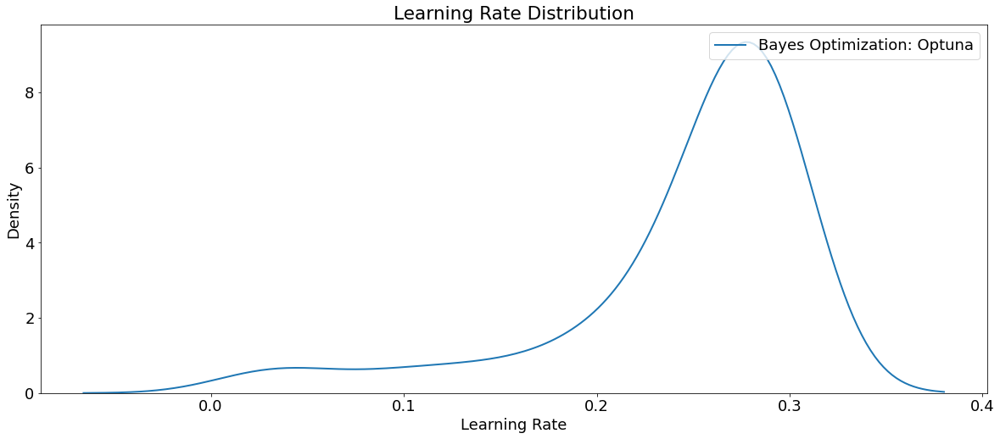

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc = 1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

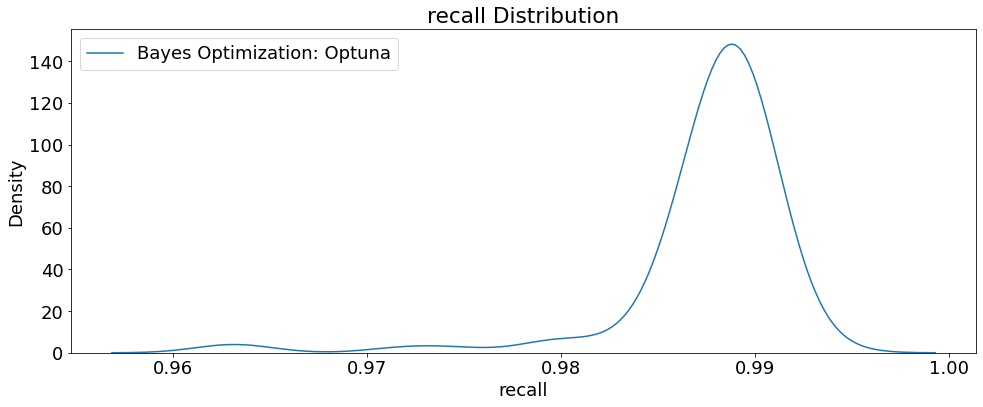

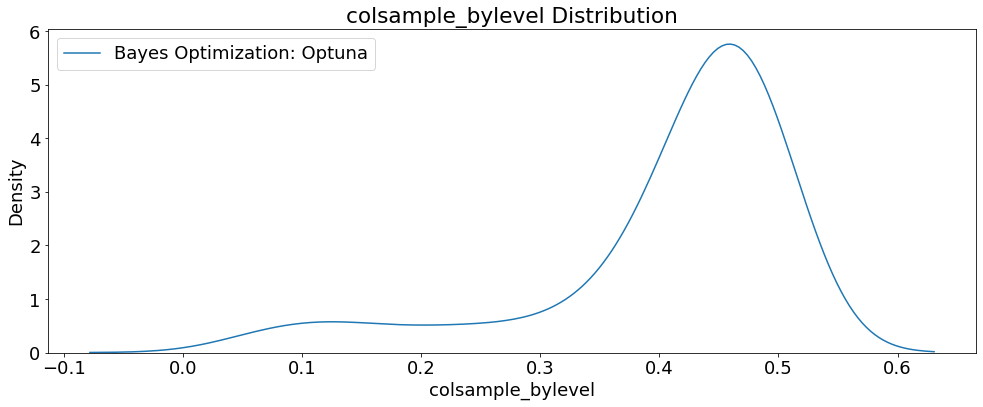

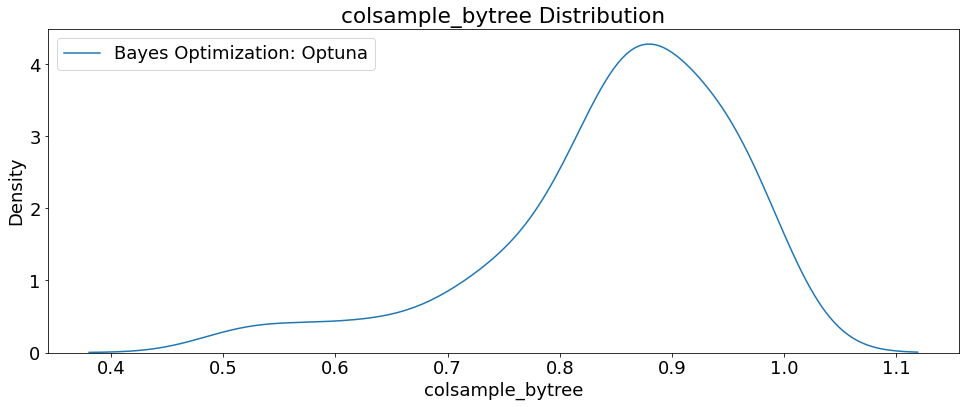

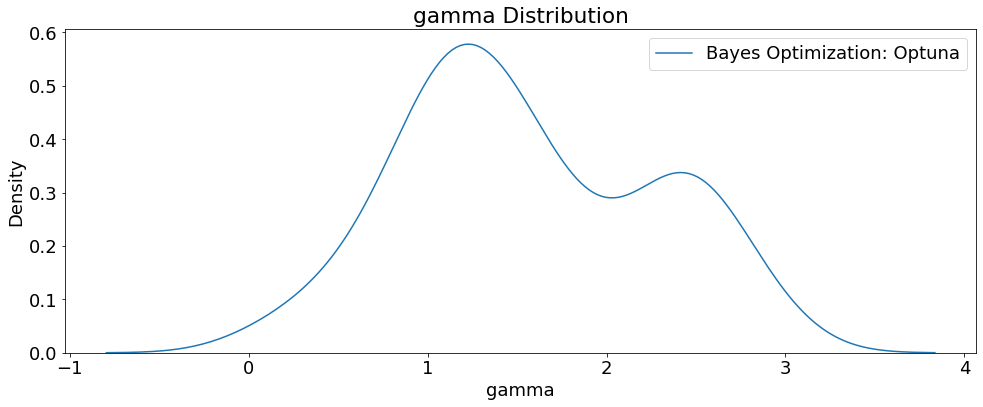

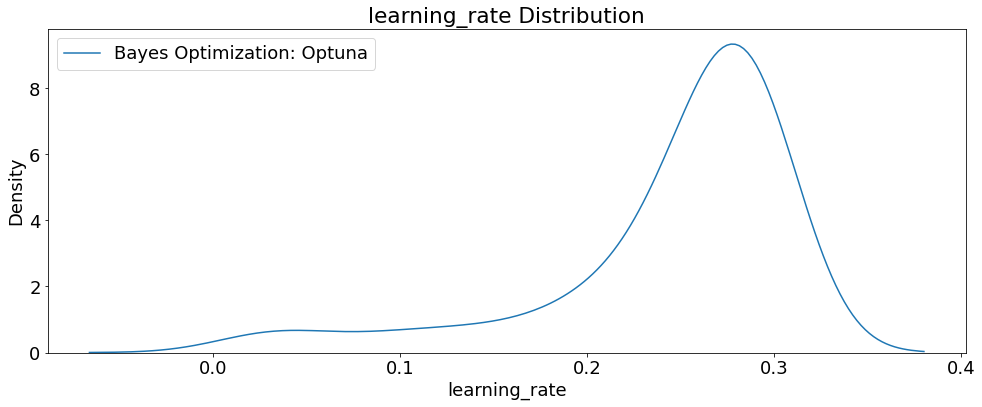

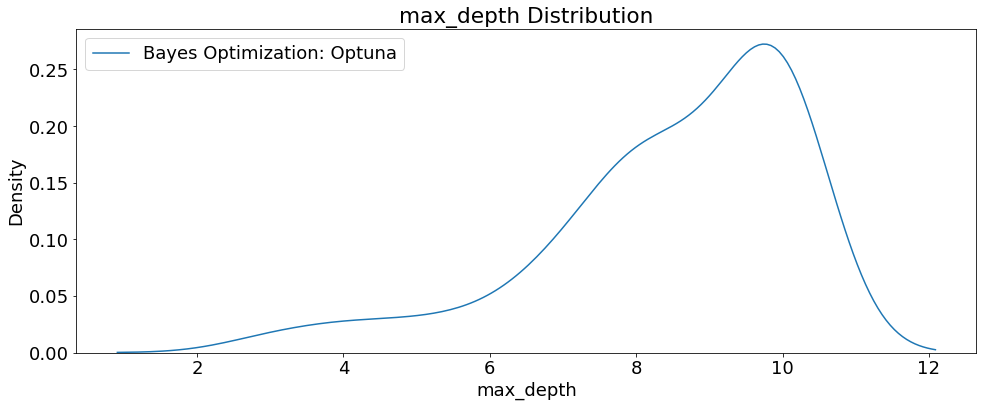

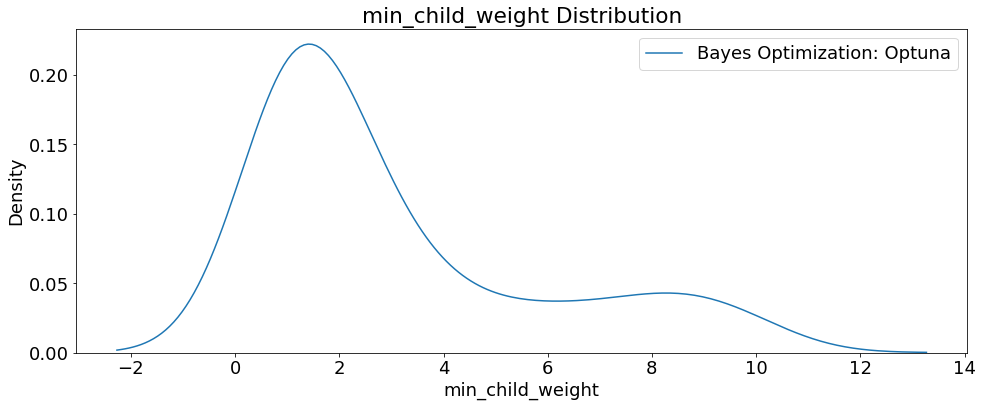

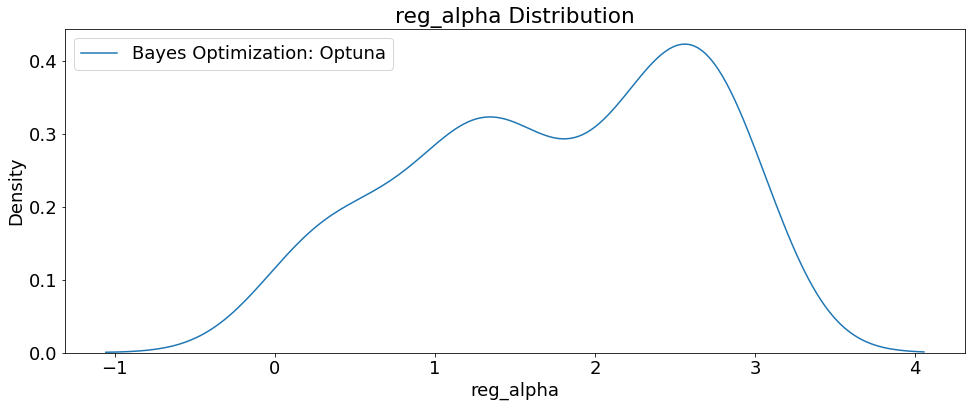

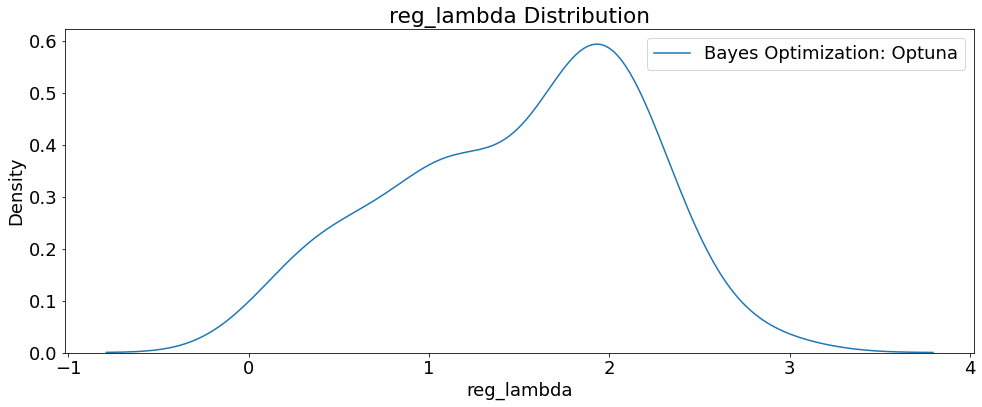

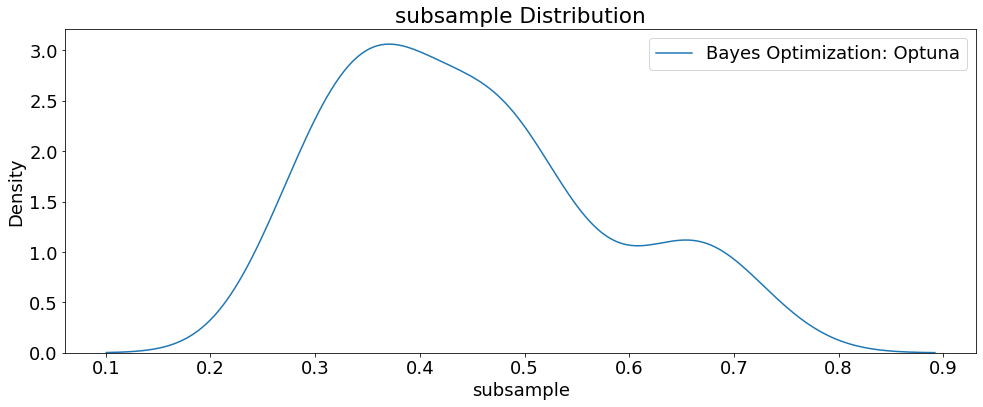

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize = (14, 6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

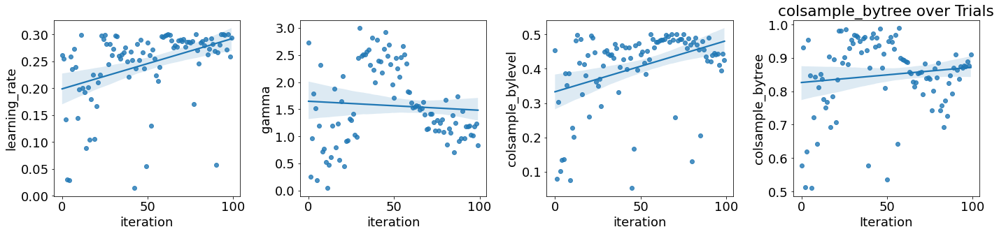

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'gamma', 'colsample_bylevel',
                         'colsample_bytree']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

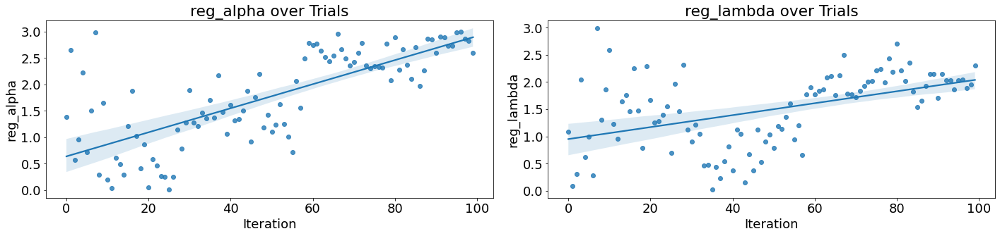

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['reg_alpha', 'reg_lambda']):
        # Scatterplot
        sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
        axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
                   title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_xgbRAPIDS_Optuna_SMOTE_100_GPU_recall.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_xgbRAPIDS_Optuna_SMOTE_100_GPU_recall.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params

{'n_estimators': 490,
 'max_depth': 10,
 'subsample': 0.28966076775392735,
 'gamma': 0.37864151913699096,
 'learning_rate': 0.2100184969671504,
 'reg_alpha': 2.1894596523272014,
 'reg_lambda': 0.004161681139119078,
 'colsample_bytree': 0.9893540545667064,
 'colsample_bylevel': 0.3381554465825316,
 'min_child_weight': 1}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

In [ ]:
# Re-create the best model and train on the training data
best_model = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'xgbRAPIDS_Optuna_SMOTE_100trials_GPU_recall.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('xgbRAPIDS_Optuna_SMOTE_100trials_GPU_recall.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost RAPIDS HPO SMOTE 100 trials GPU Recall')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for XGBoost RAPIDS HPO SMOTE 100 trials GPU Recall


Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    377848
           1       0.99      0.91      0.95     54625

    accuracy                           0.99    432473
   macro avg       0.99      0.95      0.97    432473
weighted avg       0.99      0.99      0.99    432473



Confusion matrix:
[[377228    620]
 [  5042  49583]]


Accuracy score : 0.987
Precision score : 0.988
Recall score : 0.908
F1 score : 0.946


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 100 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 100 GPU trials optimization scores 0.95303 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    16
recall                                 0.992952
datetime_start       2022-09-17 13:40:44.266320
datetime_complete    2022-09-17 13:40:54.458737
duration                 0 days 00:00:10.192417
colsample_bylevel                      0.495241
colsample_bytree                       0.921079
gamma                                  0.570708
learning_rate                          0.208837
max_depth                                   7.0
min_child_weight                            5.0
n_estimators                              340.0
reg_alpha                              1.317264
reg_lambda                             1.724734
subsample                              0.749946
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_100_GPU_recall_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_100_GPU_recall_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.2745 ± 0.0007,total_pymnt
0.2396 ± 0.0009,out_prncp
0.0719 ± 0.0003,loan_amnt
0.0677 ± 0.0002,recoveries
0.0595 ± 0.0003,installment
0.0289 ± 0.0002,last_pymnt_amnt
0.0205 ± 0.0004,total_rec_int
0.0094 ± 0.0003,int_rate
0.0014 ± 0.0000,grade_B
0.0012 ± 0.0001,total_rec_late_fee


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('xgbRAPIDS_Optuna_SMOTE_100_GPU_recall_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,total_pymnt,0.274461,0.000350
1,out_prncp,0.239629,0.000434
2,loan_amnt,0.071934,0.000165
3,recoveries,0.067676,0.000105
4,installment,0.059495,0.000153
5,last_pymnt_amnt,0.028912,0.000107
6,total_rec_int,0.020453,0.000185
7,int_rate,0.009418,0.000169
8,grade_B,0.001410,0.000013
9,total_rec_late_fee,0.001193,0.000044


In [ ]:
# Training Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_train)

<Figure size 432x288 with 0 Axes>

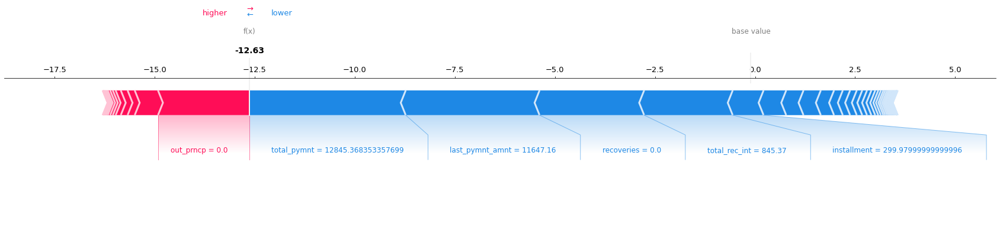

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 5)).savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_recall_ShapForcePlot_TrainSet.png', 
                                                                      dpi=my_dpi, 
                                                                      bbox_inches='tight');

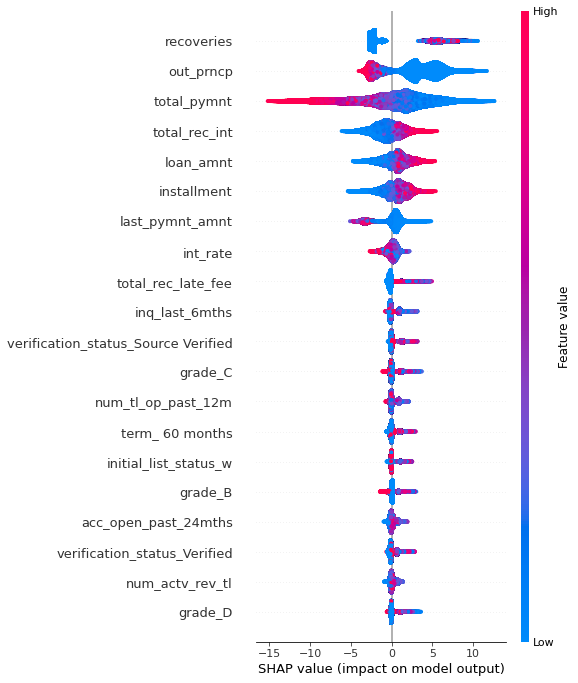

In [ ]:
# Training Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_train.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_recall_ShapSummary_TrainSet.png', 
            dpi=my_dpi, bbox_inches='tight');

In [ ]:
# Test Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_test)

<Figure size 432x288 with 0 Axes>

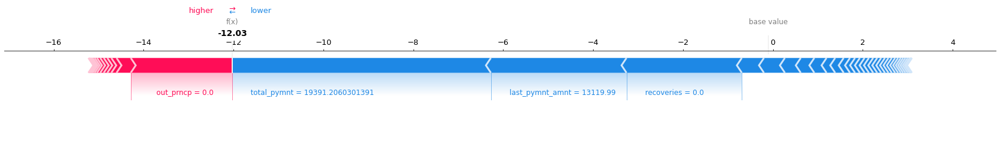

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_test.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 3)).savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_recall_ShapForcePlot_TestSet.png', 
                                                                      dpi=my_dpi, bbox_inches='tight');

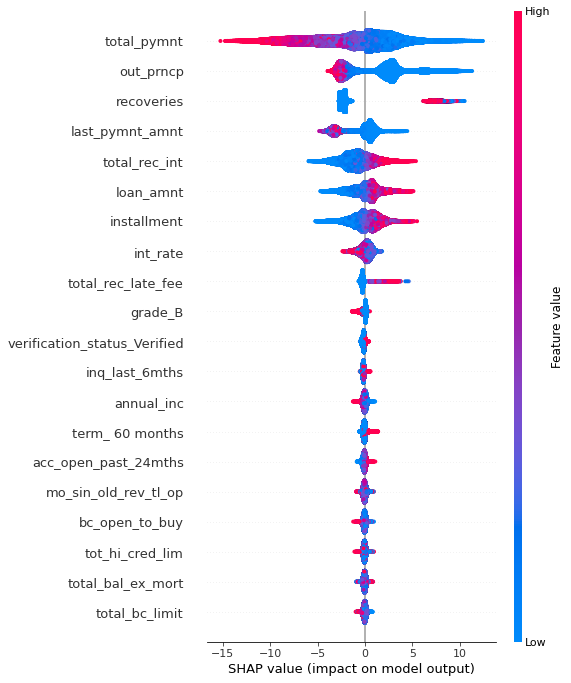

In [ ]:
# Test Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_test.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_recall_ShapSummary_TestSet.png', 
            dpi=my_dpi, bbox_inches='tight');

<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

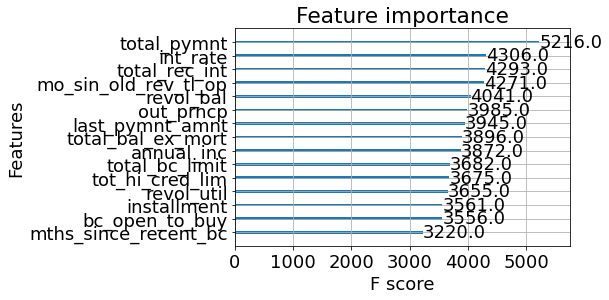

In [ ]:
# Feature importance
plot_importance(best_model, max_num_features=15);

<Figure size 432x288 with 0 Axes>

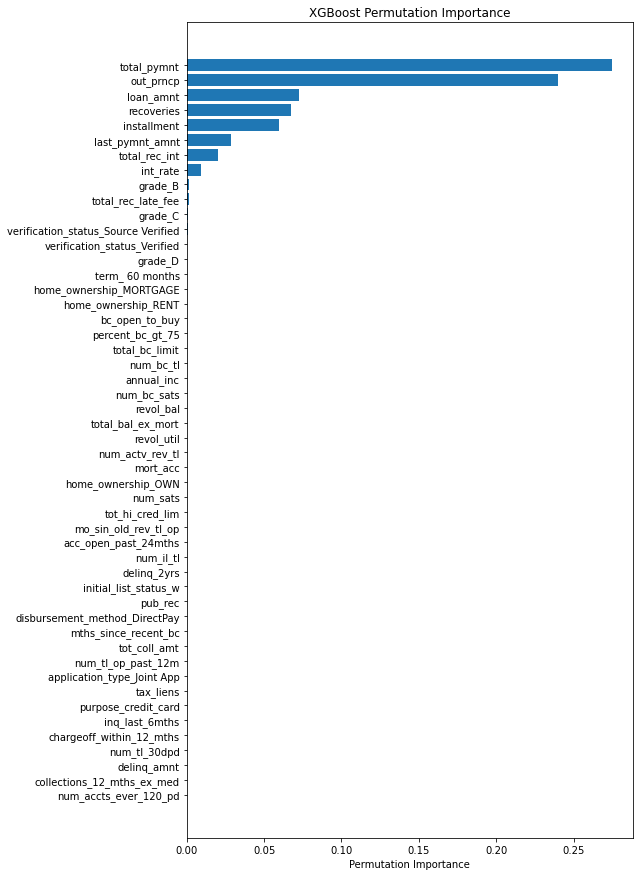

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('XGBoost Permutation Importance')
fig.savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_recall_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

### 300 Trials

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_SMOTE_xgbRapids_recall_tpe'

In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_xgb300gpu_trainvaltest_recall', 
                'save_code': 'False', 'notes': 'SMOTE_xgb300gpu_trainvaltest_recall'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `XGBoostClassifier` model.
    """
    joblib.dump(study, 'xgbRAPIDS_Optuna_SMOTE_300_GPU_recall.pkl')

    # Define parameter grid
    params_xgboost_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 400, 700),
        'max_depth': trial.suggest_int('max_depth', 6, 15),
        'subsample': trial.suggest_float('subsample', 0.6, 0.8),
        'gamma': trial.suggest_float('gamma', 0.001, 0.6),
        'learning_rate': trial.suggest_float('learning_rate', 0.15, 0.3),
        'reg_alpha' : trial.suggest_float('reg_alpha', 0.95, 2.5),
        'reg_lambda' : trial.suggest_float('reg_lambda', 1.3, 2.5),
        'colsample_bytree' : trial.suggest_float('colsample_bytree', 0.75, 0.99),
        'colsample_bylevel' : trial.suggest_float('colsample_bylevel', 0.3, 0.6),
        'min_child_weight' : trial.suggest_int('min_child_weight', 1, 8),
    }    

    # Define model type
    xgb = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params_xgboost_optuna)
    
    # Start timer for each trial
    start = timer()

    xgb.fit(X_train, y_train, 
            eval_set=[(X_val, y_val)], 
            verbose=0)    
    
    # Predictions
    y_pred_val = xgb.predict(X_val)
    score = recall_score(asnumpy(y_val), asnumpy(y_pred_val))
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial recall:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('xgbRAPIDS_Optuna_SMOTE_300_GPU_recall.pkl'): 
        study = joblib.load('xgbRAPIDS_Optuna_SMOTE_300_GPU_recall.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=300)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Recall Score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 25.463031443068758
- Trial recall: 0.9943352138836835
######################################################
- Trial time: 33.132247783010826
- Trial recall: 0.9999801699435835
######################################################
- Trial time: 27.95915055903606
- Trial recall: 0.9979905542831269
######################################################
- Trial time: 33.081081341952085
- Trial recall: 0.9987804515303846
######################################################
- Trial time: 45.35828364081681
- Trial recall: 1.0
######################################################
- Trial time: 49.08267115592025
- Trial recall: 0.9999867799623889
######################################################
- Trial time: 15.22275741607882
- Trial recall: 0.9872096136113507
######################################################
- Trial time: 31.980123477056623
- Trial recall: 0.9971213368102032
######################################################
- Trial time: 19.15620864694938
- T

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'recall'},inplace=True)
trials_df.rename(columns={'params_colsample_bylevel':'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree':'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma':'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate':'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight':'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha':'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda':'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample':'subsample'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('recall', ascending=False)
trials_df.to_csv('xgbRAPIDS_Optuna_SMOTE_300_GPU_recall.csv', index=False)
print(trials_df) 

     iteration    recall             datetime_start  \
299        299  1.000000 2022-09-19 05:59:59.832863   
104        104  1.000000 2022-09-19 03:26:53.392964   
141        141  1.000000 2022-09-19 03:53:58.931622   
142        142  1.000000 2022-09-19 03:54:49.463518   
143        143  1.000000 2022-09-19 03:55:37.471209   
..         ...       ...                        ...   
136        136  0.989097 2022-09-19 03:50:27.093782   
55          55  0.989077 2022-09-19 02:50:52.591552   
8            8  0.987950 2022-09-19 02:16:47.076303   
129        129  0.987408 2022-09-19 03:45:54.471018   
6            6  0.987210 2022-09-19 02:15:59.061267   

             datetime_complete               duration  colsample_bylevel  \
299 2022-09-19 06:00:51.661981 0 days 00:00:51.829118           0.572131   
104 2022-09-19 03:27:39.098984 0 days 00:00:45.706020           0.470024   
141 2022-09-19 03:54:49.462975 0 days 00:00:50.531353           0.562331   
142 2022-09-19 03:55:37.470812 0 da

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_xgbRAPIDS_Optuna_SMOTE_300_GPU_recall.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_xgbRAPIDS_Optuna_SMOTE_300_GPU_recall.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_xgbRAPIDS_Optuna_SMOTE_300_GPU_recall.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'learning_rate', 
                                                       'gamma'])
py.plot(fig, filename='contour_xgbRAPIDS_Optuna_SMOTE_300_GPU_recall.html')
fig.show()

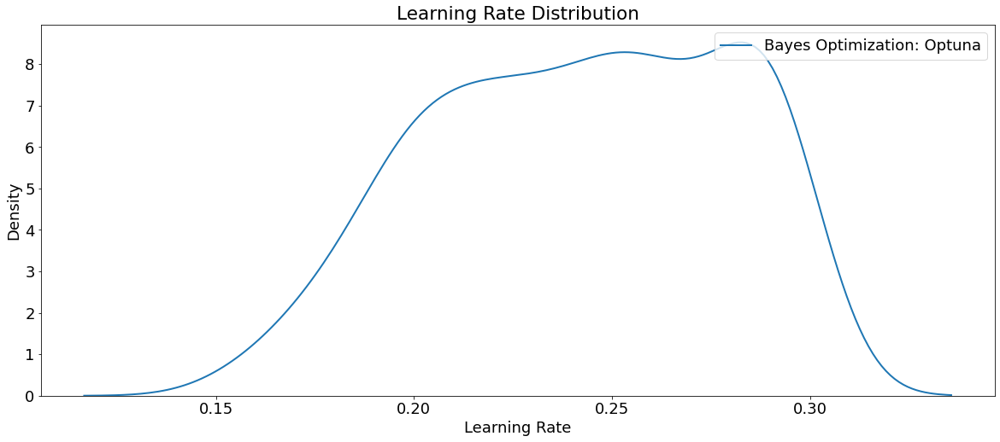

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc = 1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

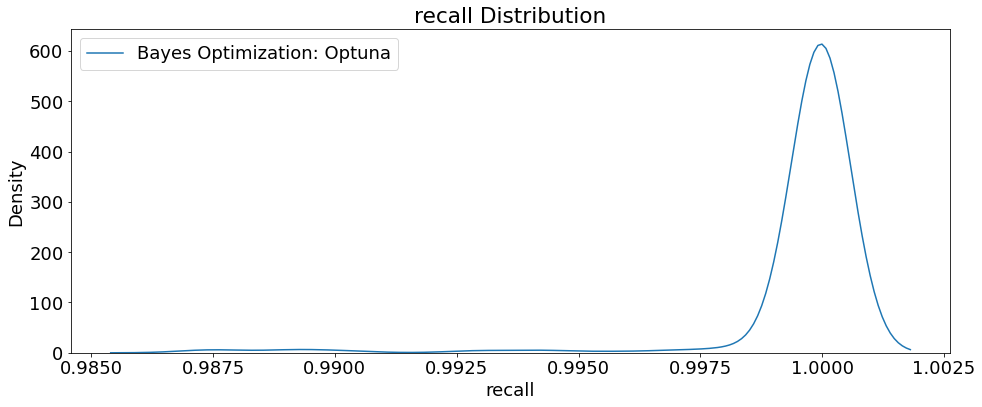

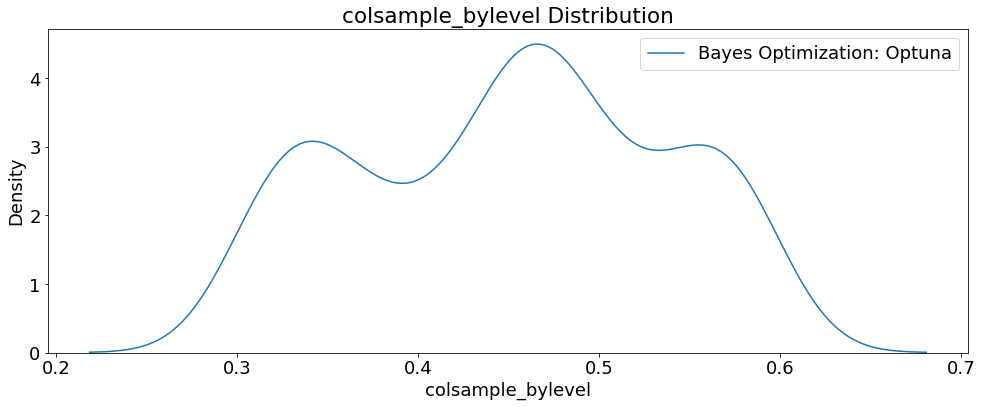

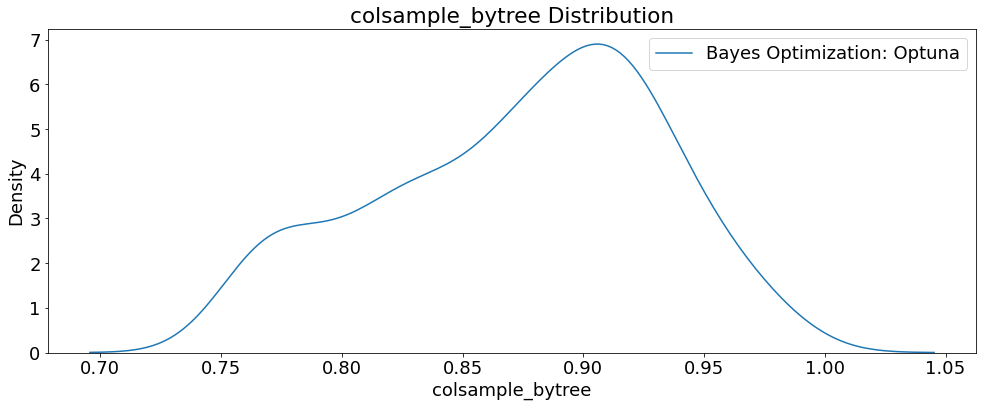

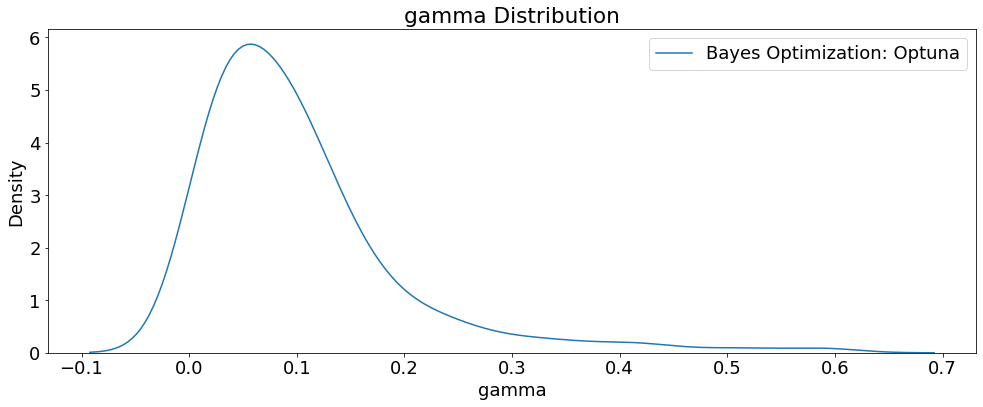

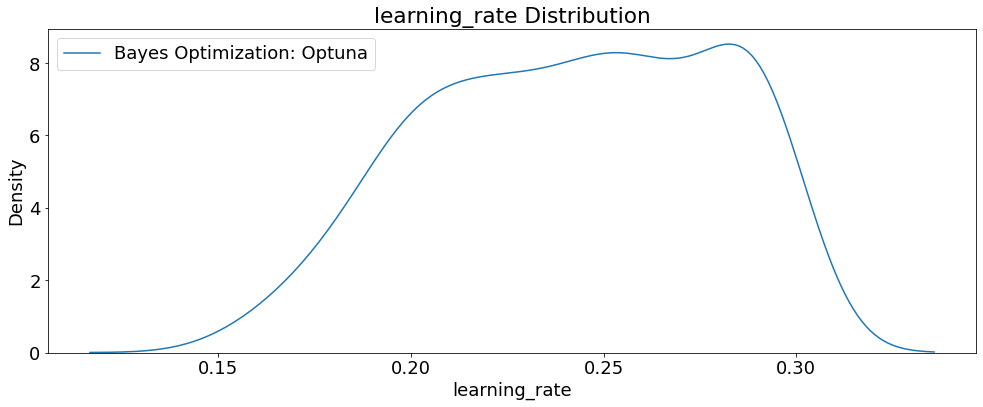

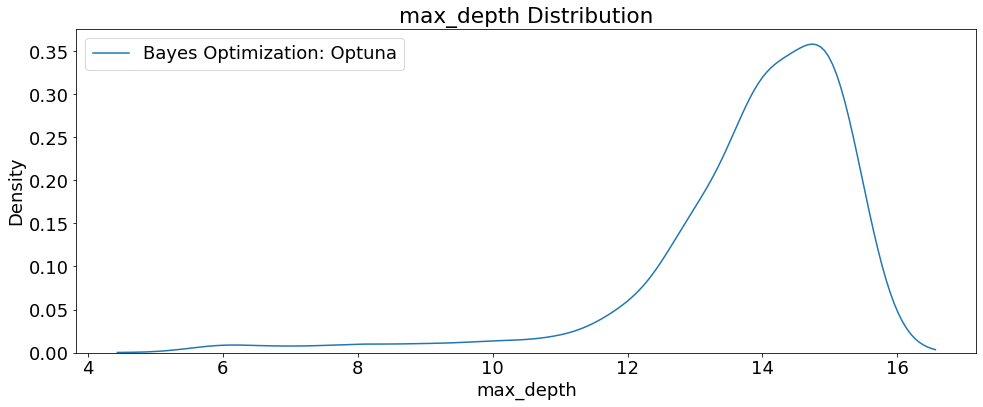

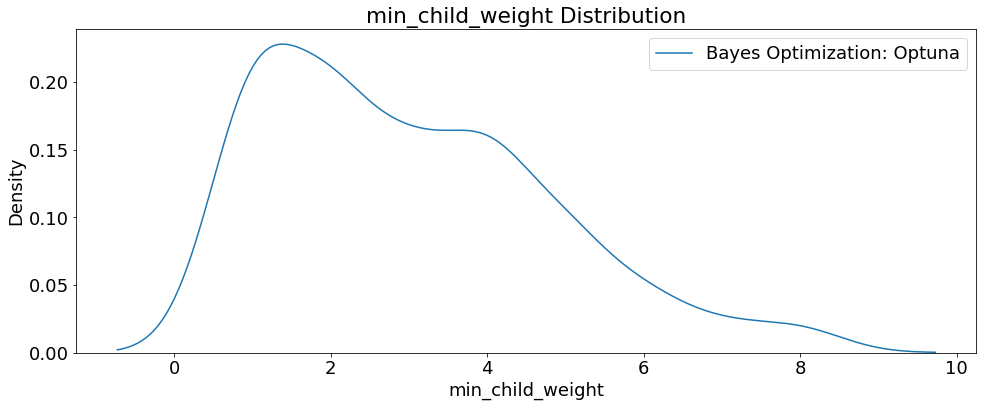

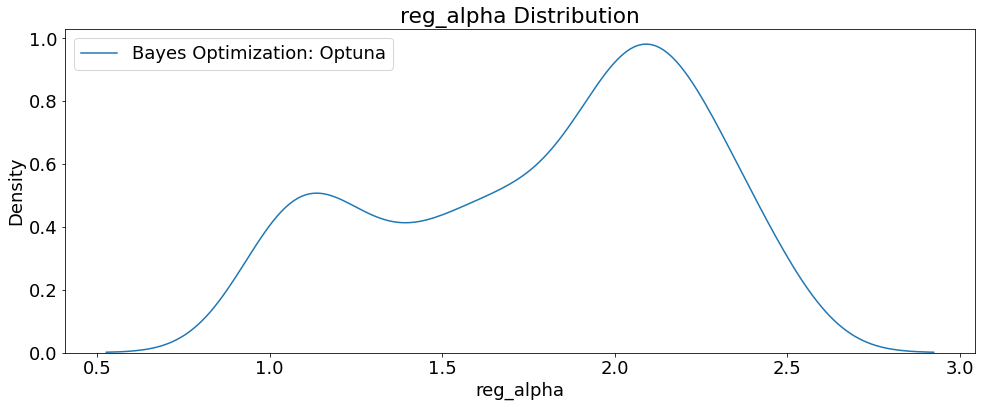

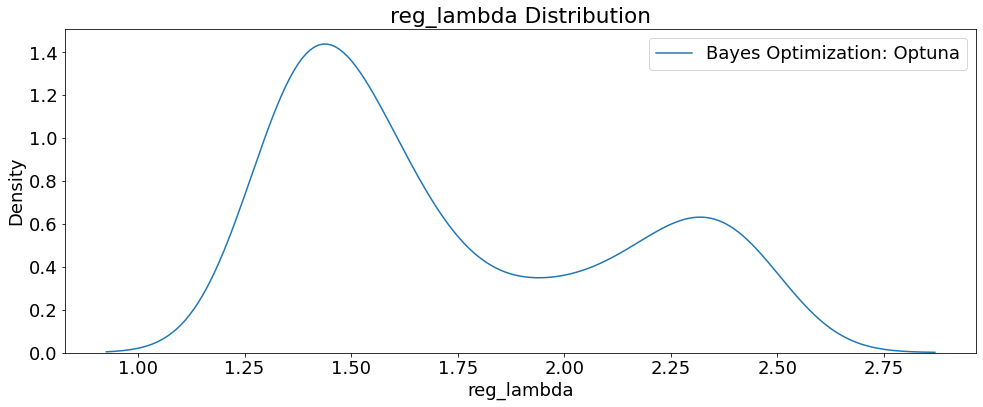

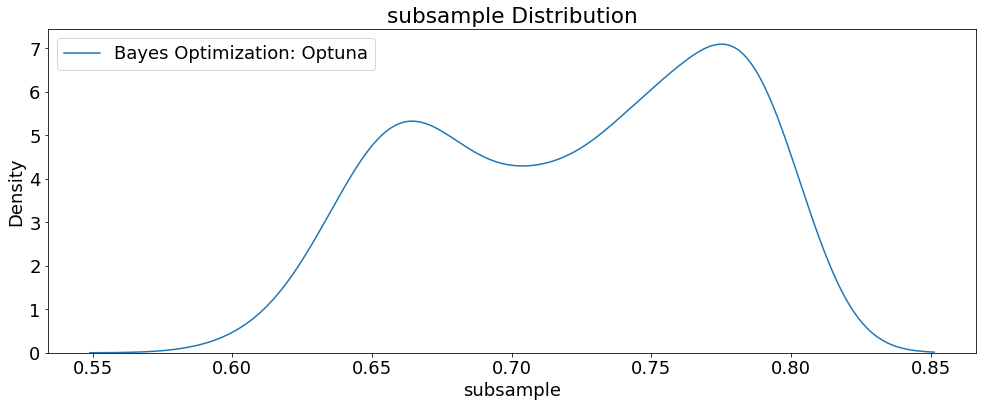

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize = (14, 6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

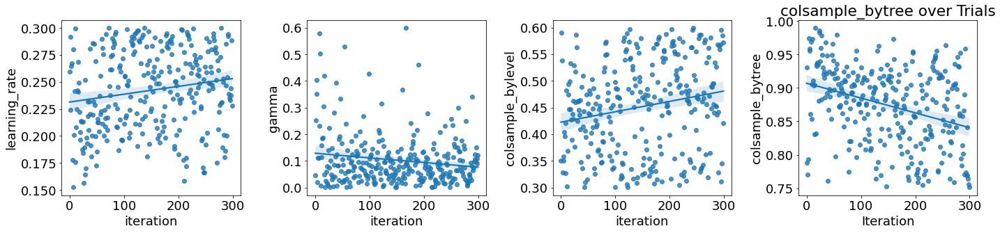

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'gamma', 'colsample_bylevel',
                         'colsample_bytree']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

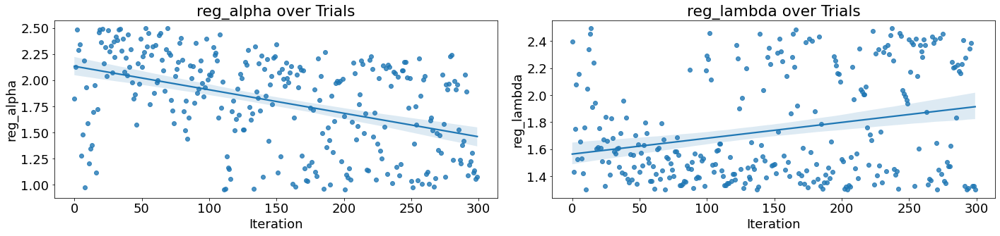

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['reg_alpha', 'reg_lambda']):
        # Scatterplot
        sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
        axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
                   title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_xgbRAPIDS_Optuna_SMOTE_300_GPU_recall.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_xgbRAPIDS_Optuna_SMOTE_300_GPU_recall.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params

{'n_estimators': 470,
 'max_depth': 15,
 'subsample': 0.674527247847795,
 'gamma': 0.021203595854778032,
 'learning_rate': 0.26734442178434226,
 'reg_alpha': 2.340423551994395,
 'reg_lambda': 1.5242296707506715,
 'colsample_bytree': 0.9738605307354204,
 'colsample_bylevel': 0.3508027551794911,
 'min_child_weight': 2}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

In [ ]:
# Re-create the best model and train on the training data
best_model = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'xgbRAPIDS_Optuna_SMOTE_300trials_GPU_recall.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('xgbRAPIDS_Optuna_SMOTE_300trials_GPU_recall.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost RAPIDS HPO SMOTE 300 trials GPU Recall')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), 
                                         asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for XGBoost RAPIDS HPO SMOTE 300 trials GPU Recall


Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    377848
           1       0.99      0.91      0.95     54625

    accuracy                           0.99    432473
   macro avg       0.99      0.95      0.97    432473
weighted avg       0.99      0.99      0.99    432473



Confusion matrix:
[[377546    302]
 [  4977  49648]]


Accuracy score : 0.988
Precision score : 0.994
Recall score : 0.909
F1 score : 0.950


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 300 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 300 GPU trials optimization scores 0.95404 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                   299
recall                                      1.0
datetime_start       2022-09-19 05:59:59.832863
datetime_complete    2022-09-19 06:00:51.661981
duration                 0 days 00:00:51.829118
colsample_bylevel                      0.572131
colsample_bytree                       0.751355
gamma                                  0.121742
learning_rate                          0.227891
max_depth                                    15
min_child_weight                              4
n_estimators                                687
reg_alpha                              1.074115
reg_lambda                              1.30175
subsample                              0.673204
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_300_GPU_recall_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_300_GPU_recall_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.2365 ± 0.0010,out_prncp
0.2355 ± 0.0010,total_pymnt
0.0675 ± 0.0002,recoveries
0.0487 ± 0.0003,installment
0.0470 ± 0.0004,loan_amnt
0.0240 ± 0.0003,last_pymnt_amnt
0.0109 ± 0.0001,total_rec_int
0.0021 ± 0.0001,int_rate
0.0010 ± 0.0001,total_rec_late_fee
0.0010 ± 0.0001,verification_status_Source Verified


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('xgbRAPIDS_Optuna_SMOTE_300_GPU_recall_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,out_prncp,0.236468,0.000515
1,total_pymnt,0.235485,0.000481
2,recoveries,0.067527,0.000103
3,installment,0.048670,0.000175
4,loan_amnt,0.047049,0.000213
5,last_pymnt_amnt,0.024013,0.000175
6,total_rec_int,0.010858,0.000030
7,int_rate,0.002123,0.000045
8,total_rec_late_fee,0.001021,0.000034
9,verification_status_Source Verified,0.000992,0.000047


In [ ]:
# Training Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_train)

<Figure size 432x288 with 0 Axes>

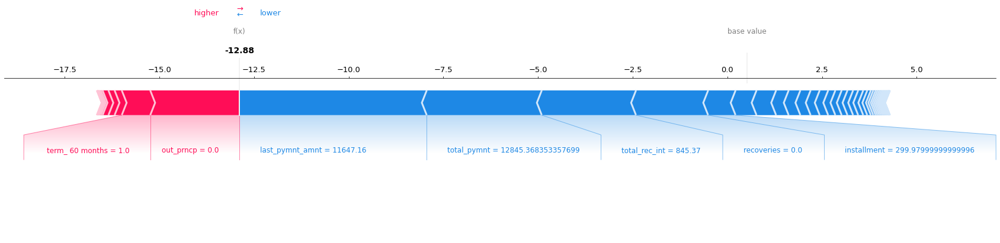

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 5)).savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_recall_ShapForcePlot_TrainSet.png', 
                                                                      dpi=my_dpi, 
                                                                      bbox_inches='tight');

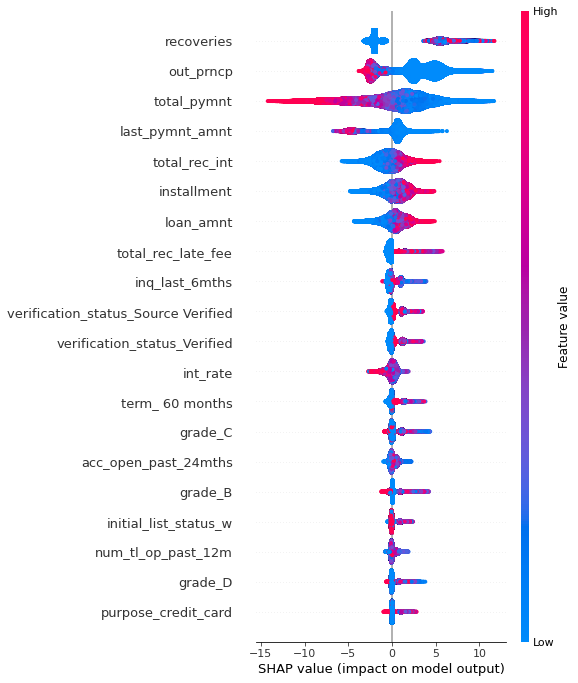

In [ ]:
# Training Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_train.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_recall_ShapSummary_TrainSet.png', 
            dpi=my_dpi, bbox_inches='tight');

In [ ]:
# Test Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_test)

<Figure size 432x288 with 0 Axes>

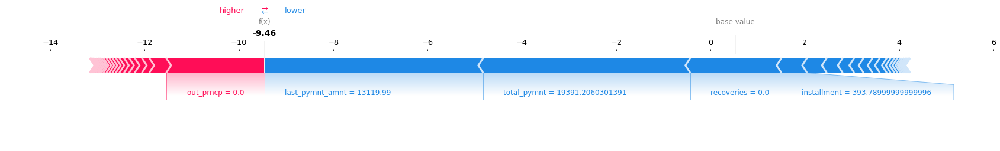

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_test.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 3)).savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_recall_ShapForcePlot_TestSet.png', 
                                                                      dpi=my_dpi, 
                                                                      bbox_inches='tight');

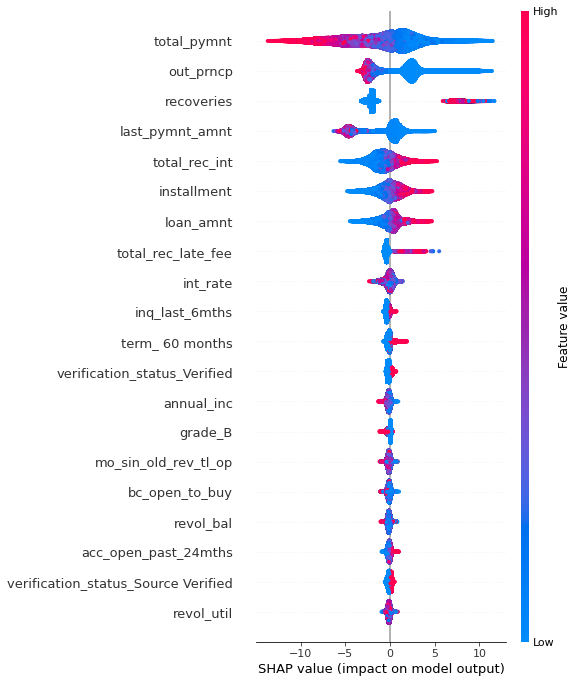

In [ ]:
# Test Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_test.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_recall_ShapSummary_TestSet.png', 
            dpi=my_dpi, bbox_inches='tight');

<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

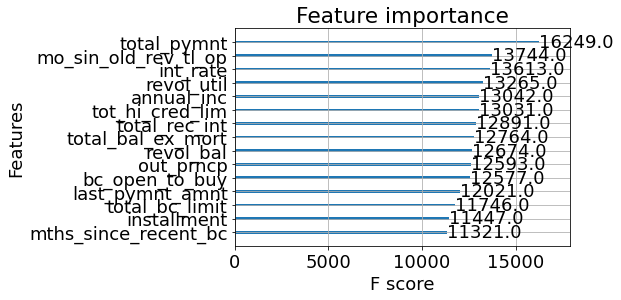

In [ ]:
# Feature importance
plot_importance(best_model, max_num_features=15);

<Figure size 432x288 with 0 Axes>

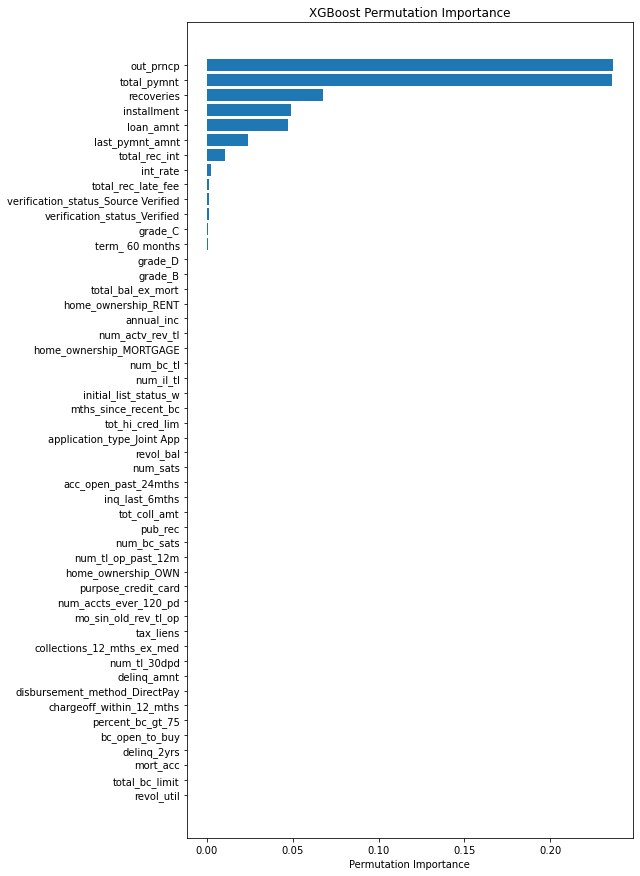

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('XGBoost Permutation Importance')
fig.savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_recall_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

## Weighted ROC

### 100 Trials

In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_SMOTE_xgbRapids_wROC_tpe'

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_xgb100gpu_trainvaltest_wROC', 
                'save_code': 'False', 'notes': 'xgb100gpu_trainvaltest_wROC'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `XGBoostClassifier` model.
    """
    joblib.dump(study, 'xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.pkl')

    # Define parameter grid
    params_xgboost_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'subsample': trial.suggest_float('subsample', 0.25, 0.75),
        'gamma': trial.suggest_float('gamma', 0, 3),
        'learning_rate': trial.suggest_float('learning_rate', 0.0001, 0.3),
        'reg_alpha' : trial.suggest_float('reg_alpha', 0, 3),
        'reg_lambda' : trial.suggest_float('reg_lambda', 0, 3),
        'colsample_bytree' : trial.suggest_float('colsample_bytree', 0.5, 0.99),
        'colsample_bylevel' : trial.suggest_float('colsample_bylevel', 0.05, 0.5), 
        'min_child_weight' : trial.suggest_int('min_child_weight', 1, 10),
    }    

    # Define model type
    xgb = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params_xgboost_optuna)
    
    # Start timer for each trial
    start = timer()

    xgb.fit(X_train, y_train, 
            eval_set=[(X_val, y_val)], 
            verbose=0)    
    
    # Predictions
    y_pred_val = xgb.predict(X_val)
    score = roc_auc_score(asnumpy(y_val), asnumpy(y_pred_val), 
                          average='weighted')
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial weighted ROC:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.pkl'): 
        study = joblib.load('xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=100)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest weighted ROC Score', study.best_value)
wandb.finish()

- Trial time: 4.173970355070196
- Trial weighted ROC: 0.9894807643708997
######################################################
- Trial time: 3.5006219960050657
- Trial weighted ROC: 0.990984692668161
######################################################
- Trial time: 11.472950853058137
- Trial weighted ROC: 0.9500943462017263
######################################################
- Trial time: 11.487911020987667
- Trial weighted ROC: 0.9875069570462276
######################################################
- Trial time: 8.447555511025712
- Trial weighted ROC: 0.9886022252022139
######################################################
- Trial time: 5.244099632021971
- Trial weighted ROC: 0.9912609914114824
######################################################
- Trial time: 6.1390601340681314
- Trial weighted ROC: 0.9916845384064322
######################################################
- Trial time: 3.131062748027034
- Trial weighted ROC: 0.9895734129594876
############################

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'roc_weighted'},inplace=True)
trials_df.rename(columns={'params_colsample_bylevel':'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree':'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma':'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate':'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight':'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha':'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda':'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample':'subsample'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('roc_weighted', ascending=False)
trials_df.to_csv('xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.csv', index=False)
print(trials_df) 

    iteration  roc_weighted             datetime_start  \
93         93      0.997857 2022-09-17 18:15:38.743325   
92         92      0.997765 2022-09-17 18:15:13.018189   
91         91      0.997664 2022-09-17 18:14:47.276976   
96         96      0.997467 2022-09-17 18:16:50.732193   
95         95      0.997202 2022-09-17 18:16:25.425127   
..        ...           ...                        ...   
4           4      0.988602 2022-09-17 17:47:20.421368   
47         47      0.988053 2022-09-17 17:58:54.846765   
3           3      0.987507 2022-09-17 17:47:08.548597   
46         46      0.985727 2022-09-17 17:58:44.864503   
2           2      0.950094 2022-09-17 17:46:56.781272   

            datetime_complete               duration  colsample_bylevel  \
93 2022-09-17 18:16:04.004363 0 days 00:00:25.261038           0.492788   
92 2022-09-17 18:15:38.743094 0 days 00:00:25.724905           0.488400   
91 2022-09-17 18:15:13.017910 0 days 00:00:25.740934           0.493881   
96 

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'learning_rate', 
                                                       'gamma'])
py.plot(fig, filename='contour_xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.html')
fig.show()

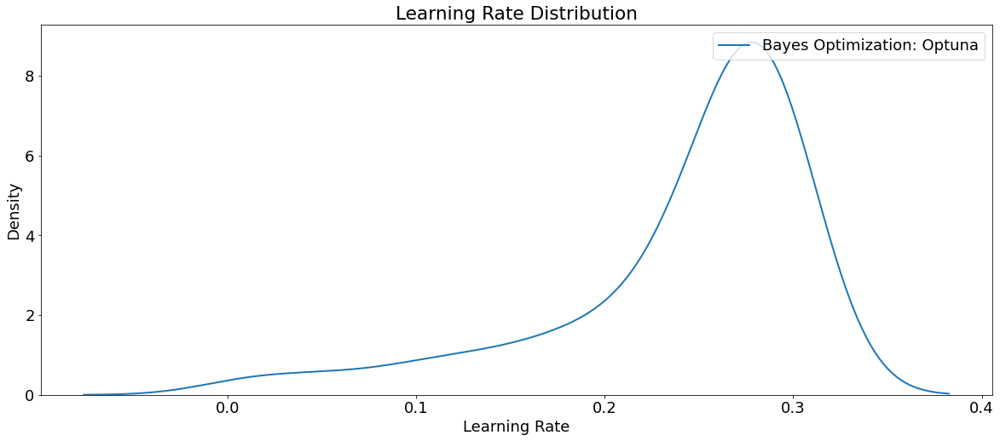

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc = 1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

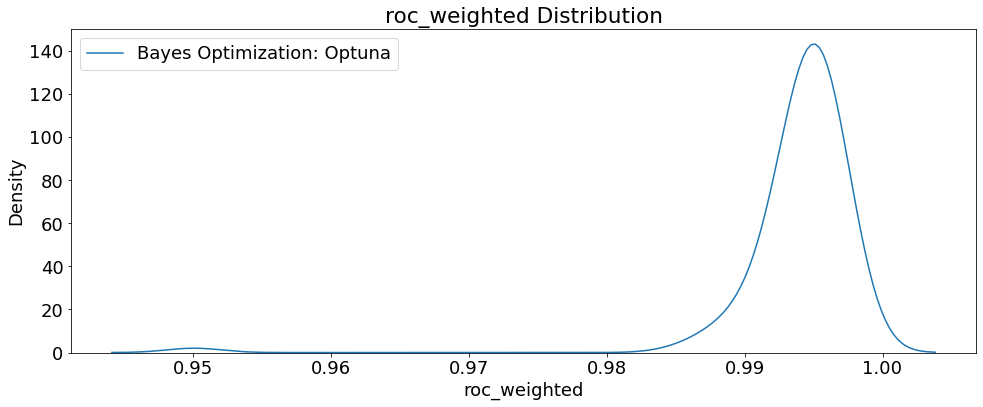

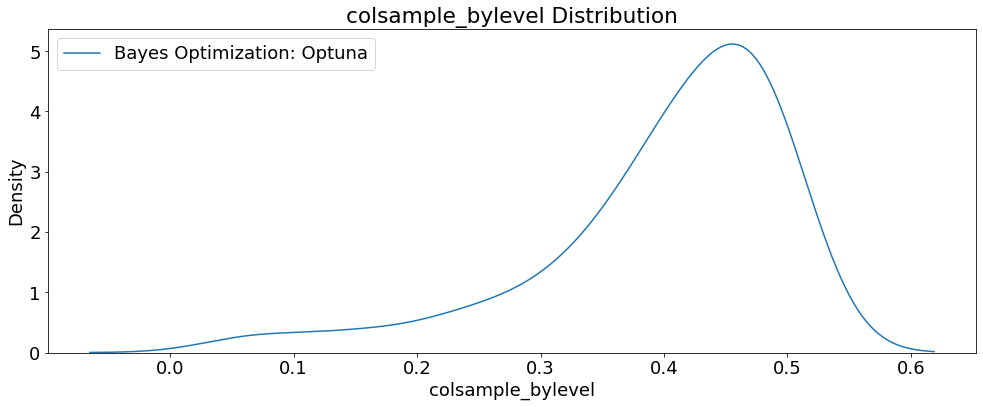

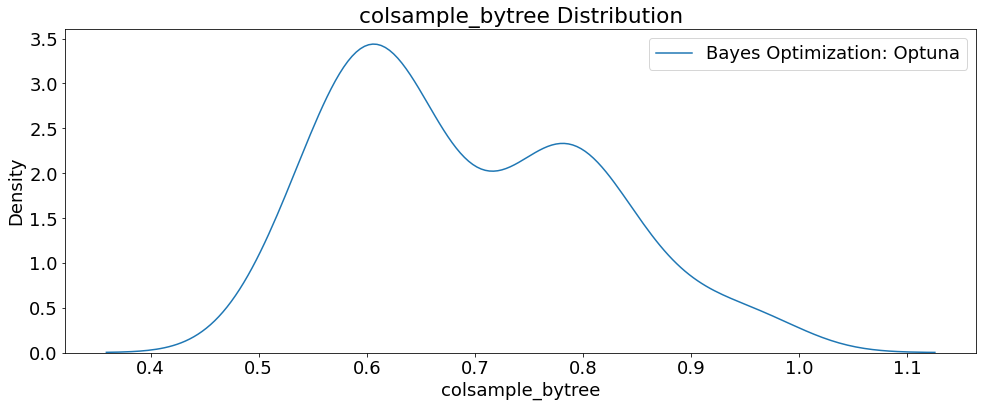

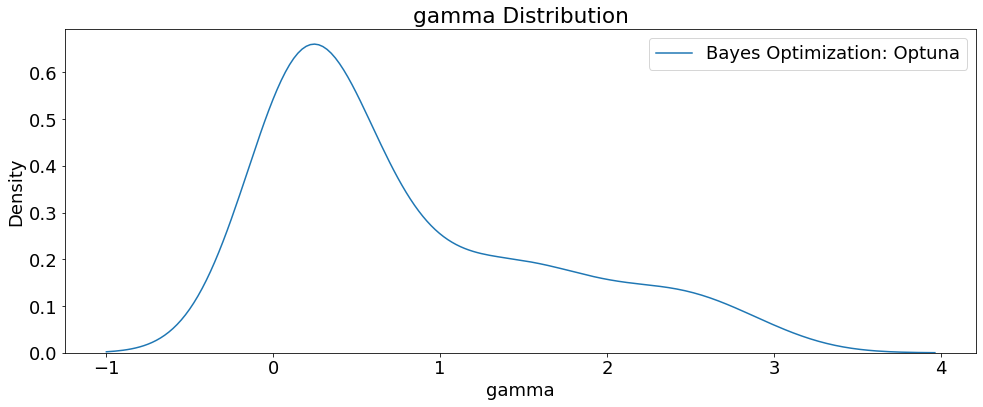

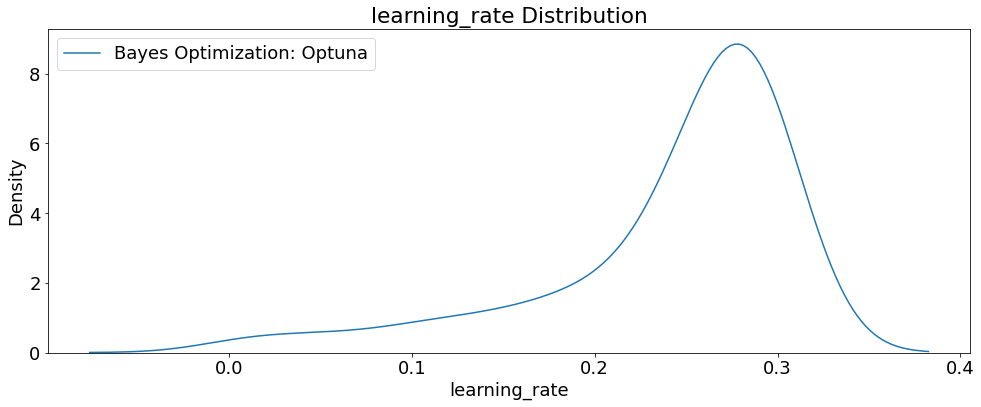

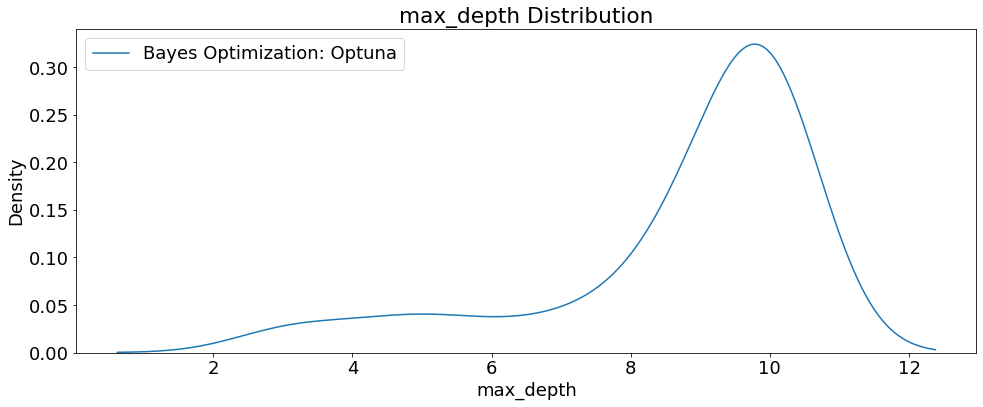

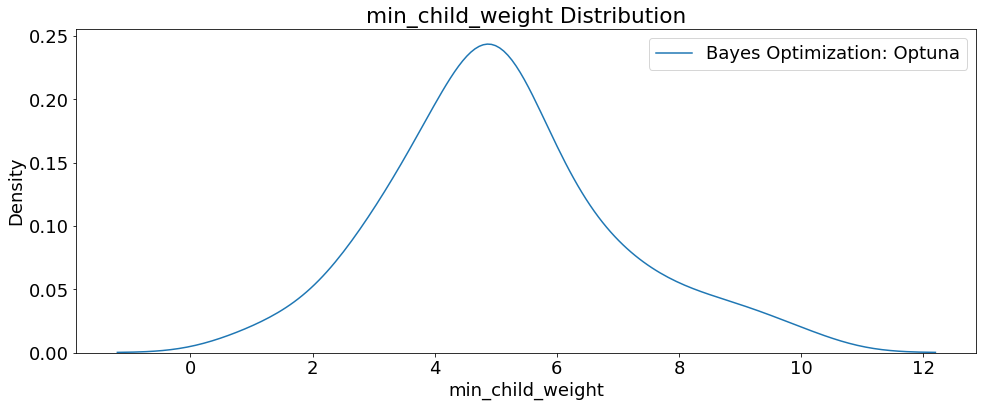

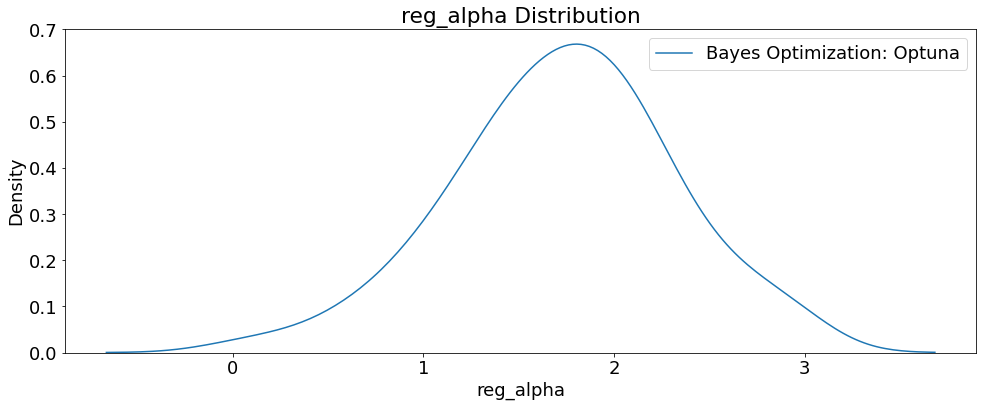

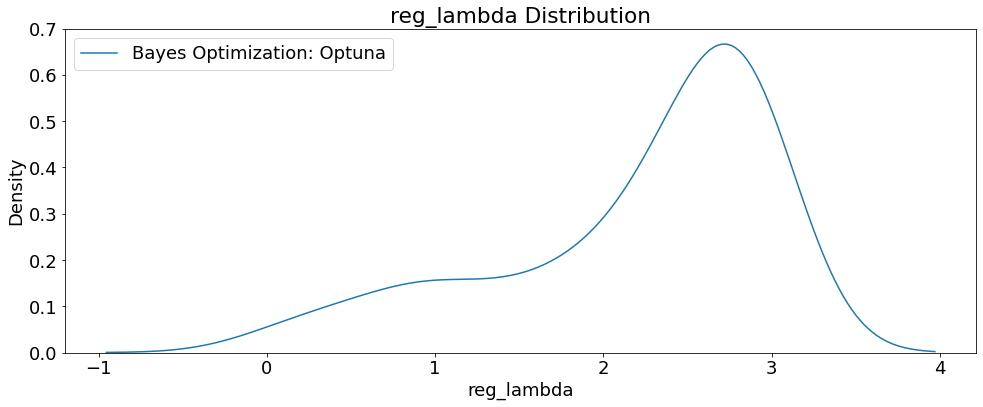

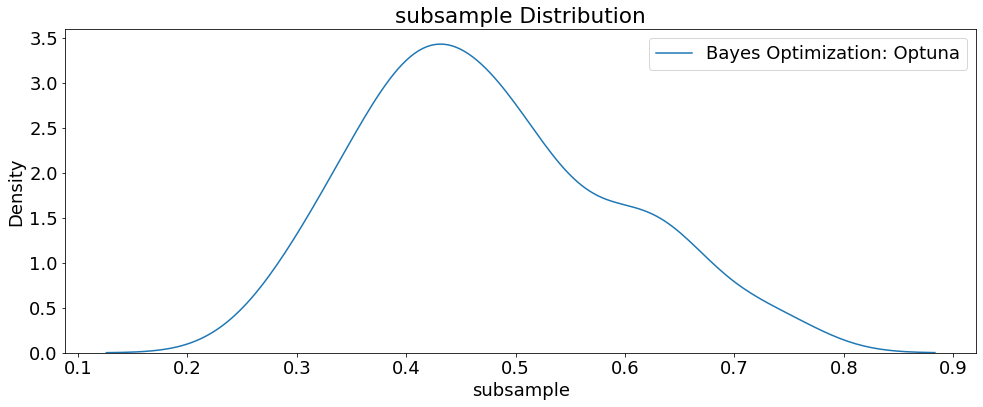

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize = (14, 6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

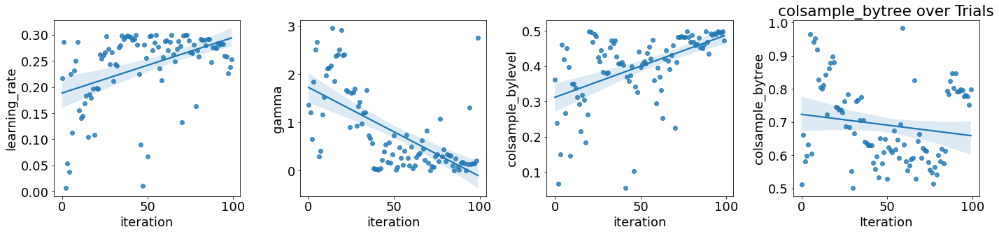

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'gamma', 'colsample_bylevel',
                         'colsample_bytree']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

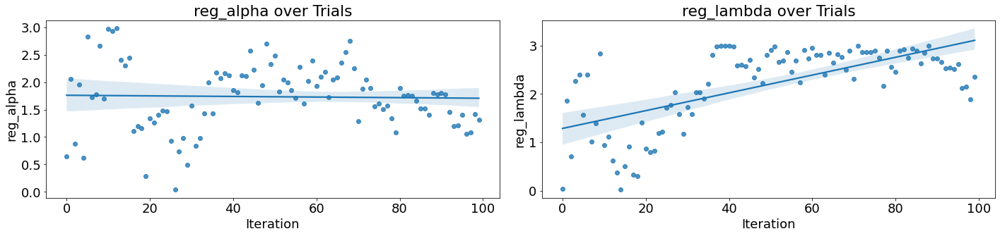

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['reg_alpha', 'reg_lambda']):
        # Scatterplot
        sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
        axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
                   title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params

{'n_estimators': 460,
 'max_depth': 10,
 'subsample': 0.624135782806238,
 'gamma': 0.12724739294700088,
 'learning_rate': 0.2836729139549415,
 'reg_alpha': 1.1951762523375251,
 'reg_lambda': 2.544027965007359,
 'colsample_bytree': 0.7994849950711413,
 'colsample_bylevel': 0.4927879170693253,
 'min_child_weight': 5}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

In [ ]:
# Re-create the best model and train on the training data
best_model = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'xgbRAPIDS_Optuna_SMOTE_100trials_GPU_ROCweighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('xgbRAPIDS_Optuna_SMOTE_100trials_GPU_ROCweighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost RAPIDS HPO SMOTE 100 trials GPU ROCweighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for XGBoost RAPIDS HPO SMOTE 100 trials GPU ROCweighted


Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    377848
           1       0.99      0.91      0.95     54625

    accuracy                           0.99    432473
   macro avg       0.99      0.95      0.97    432473
weighted avg       0.99      0.99      0.99    432473



Confusion matrix:
[[377409    439]
 [  4909  49716]]


Accuracy score : 0.988
Precision score : 0.991
Recall score : 0.910
F1 score : 0.949


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 100 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 100 GPU trials optimization scores 0.95449 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    93
roc_weighted                           0.997857
datetime_start       2022-09-17 18:15:38.743325
datetime_complete    2022-09-17 18:16:04.004363
duration                 0 days 00:00:25.261038
colsample_bylevel                      0.492788
colsample_bytree                       0.799485
gamma                                  0.127247
learning_rate                          0.283673
max_depth                                    10
min_child_weight                              5
n_estimators                                460
reg_alpha                              1.195176
reg_lambda                             2.544028
subsample                              0.624136
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance

perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.2703 ± 0.0006,total_pymnt
0.2389 ± 0.0011,out_prncp
0.0785 ± 0.0006,installment
0.0675 ± 0.0002,recoveries
0.0637 ± 0.0002,loan_amnt
0.0280 ± 0.0003,total_rec_int
0.0273 ± 0.0005,last_pymnt_amnt
0.0134 ± 0.0003,int_rate
0.0015 ± 0.0000,verification_status_Source Verified
0.0013 ± 0.0001,verification_status_Verified


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted_WeightsExplain.csv', 
           index=False)
exp

,feature,weight,std
0,total_pymnt,0.270320,0.000282
1,out_prncp,0.238905,0.000553
2,installment,0.078490,0.000288
3,recoveries,0.067479,0.000097
4,loan_amnt,0.063704,0.000095
5,total_rec_int,0.027993,0.000172
6,last_pymnt_amnt,0.027285,0.000254
7,int_rate,0.013391,0.000133
8,verification_status_Source Verified,0.001451,0.000015
9,verification_status_Verified,0.001321,0.000032


In [ ]:
# Training Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_train)

<Figure size 432x288 with 0 Axes>

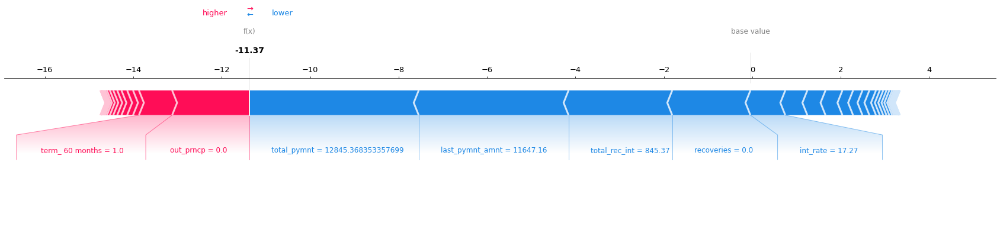

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 5)).savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted_ShapForcePlot_TrainSet.png', 
                                                                      dpi=my_dpi, 
                                                                      bbox_inches='tight');

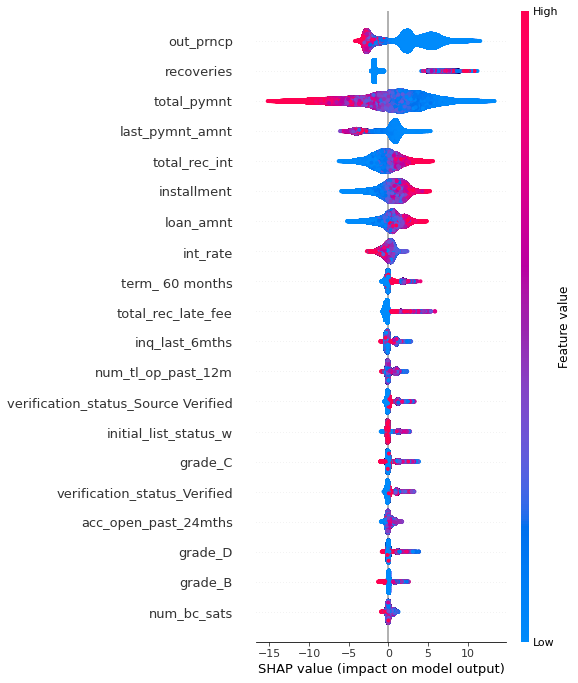

In [ ]:
# Training Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_train.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted_ShapSummary_TrainSet.png', 
            dpi=my_dpi, bbox_inches='tight');

In [ ]:
# Test Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_test)

<Figure size 432x288 with 0 Axes>

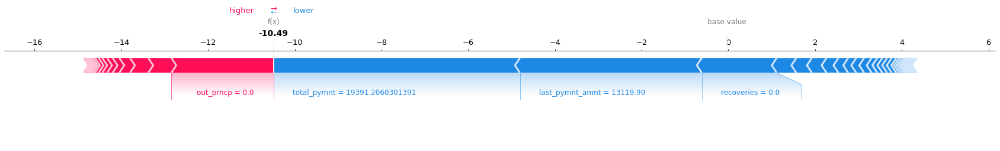

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_test.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 3)).savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted_ShapForcePlot_TestSet.png', 
                                                                      dpi=my_dpi, 
                                                                      bbox_inches='tight');

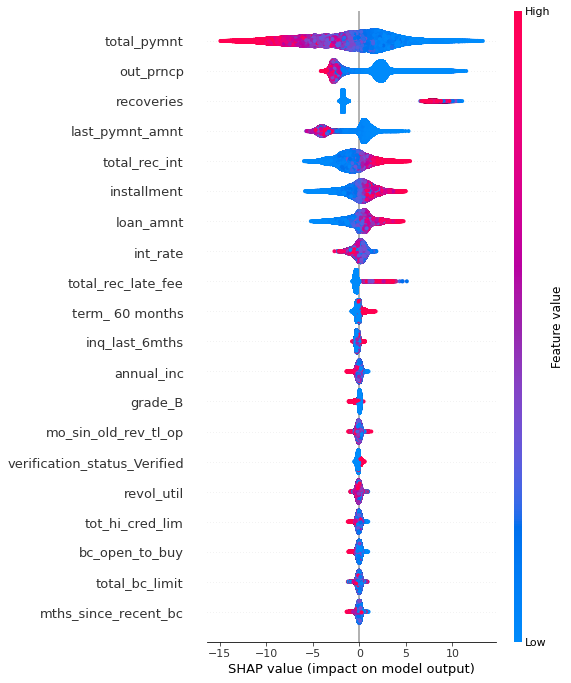

In [ ]:
# Test Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_test.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted_ShapSummary_TestSet.png', 
            dpi=my_dpi, bbox_inches='tight');

<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

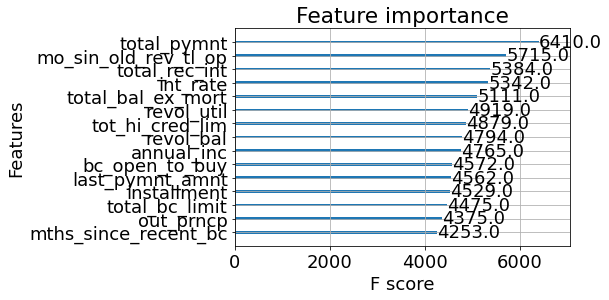

In [ ]:
# Feature importance
plot_importance(best_model, max_num_features=15);

<Figure size 432x288 with 0 Axes>

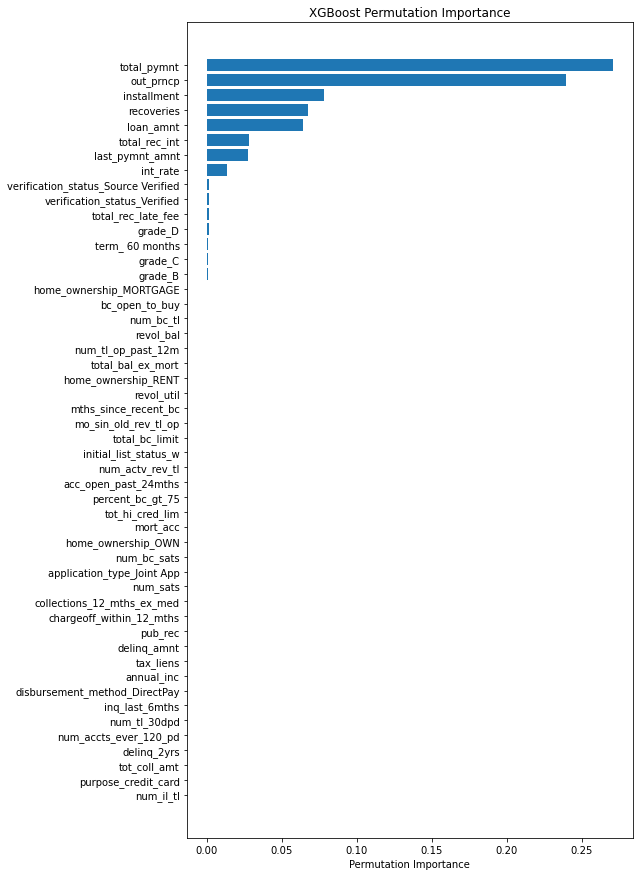

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('XGBoost Permutation Importance')
fig.savefig('xgbRAPIDS_Optuna_SMOTE_100_GPU_ROCweighted_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

### 300 Trials

In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_SMOTE_xgbRapids_wROC_300_tpe'

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_SMOTE_xgb300gpu_trainvaltest_wROC', 
                'save_code': 'False', 'notes': 'smote_xgb300gpu_trainvaltest_wROC'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `XGBoostClassifier` model.
    """
    joblib.dump(study, 'xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.pkl')

    # Define parameter grid
    params_xgboost_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 400, 700),
        'max_depth': trial.suggest_int('max_depth', 7, 15),
        'subsample': trial.suggest_float('subsample', 0.35, 0.65),
        'gamma': trial.suggest_float('gamma', 0.001, 0.75),
        'learning_rate': trial.suggest_float('learning_rate', 0.2, 0.35),
        'reg_alpha' : trial.suggest_float('reg_alpha', 1, 2.3),
        'reg_lambda' : trial.suggest_float('reg_lambda', 1.8, 3),
        'colsample_bytree' : trial.suggest_float('colsample_bytree', 0.5, 0.85),
        'colsample_bylevel' : trial.suggest_float('colsample_bylevel', 0.35, 0.5), 
        'min_child_weight' : trial.suggest_int('min_child_weight', 4, 8),
    }  

    # Define model type
    xgb = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params_xgboost_optuna)
    
    # Start timer for each trial
    start = timer()

    xgb.fit(X_train, y_train, 
            eval_set=[(X_val, y_val)], 
            verbose=0)    
    
    # Predictions
    y_pred_val = xgb.predict(X_val)
    score = roc_auc_score(asnumpy(y_val), asnumpy(y_pred_val), average='weighted')
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial weighted ROC:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.pkl'): 
        study = joblib.load('xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=300)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest weighted ROC Score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 27.55684891412966
- Trial weighted ROC: 0.9923005188693125
######################################################
- Trial time: 17.568216508021578
- Trial weighted ROC: 0.9922292945654362
######################################################
- Trial time: 31.416082514915615
- Trial weighted ROC: 0.9926143787597232
######################################################
- Trial time: 25.91619667597115
- Trial weighted ROC: 0.9924176996318604
######################################################
- Trial time: 24.56872742716223
- Trial weighted ROC: 0.992601339580622
######################################################
- Trial time: 12.135826112003997
- Trial weighted ROC: 0.9928146229776159
######################################################
- Trial time: 13.79813768598251
- Trial weighted ROC: 0.9925733698940387
######################################################
- Trial time: 30.34158191201277
- Trial weighted ROC: 0.9928941108155082
#############################

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'roc_weighted'},inplace=True)
trials_df.rename(columns={'params_colsample_bylevel':'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree':'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma':'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate':'learning_rate'}, inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight':'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha':'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda':'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample':'subsample'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('roc_weighted', ascending=False)
trials_df.to_csv('xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.csv', index=False)
print(trials_df) 

     iteration  roc_weighted             datetime_start  \
183        183      0.993048 2022-09-20 00:25:09.177375   
210        210      0.993041 2022-09-20 00:33:11.303755   
226        226      0.993025 2022-09-20 00:37:41.120085   
156        156      0.993011 2022-09-20 00:17:25.982544   
238        238      0.993008 2022-09-20 00:41:06.094092   
..         ...           ...                        ...   
8            8      0.992411 2022-09-19 23:24:51.834927   
9            9      0.992400 2022-09-19 23:25:22.392657   
29          29      0.992334 2022-09-19 23:35:55.712168   
0            0      0.992301 2022-09-19 23:21:37.859326   
1            1      0.992229 2022-09-19 23:22:10.894670   

             datetime_complete               duration  colsample_bylevel  \
183 2022-09-20 00:25:25.646974 0 days 00:00:16.469599           0.451178   
210 2022-09-20 00:33:27.206490 0 days 00:00:15.902735           0.457740   
226 2022-09-20 00:37:57.527296 0 days 00:00:16.407211          

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'learning_rate', 
                                                       'gamma'])
py.plot(fig, filename='contour_xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.html')
fig.show()

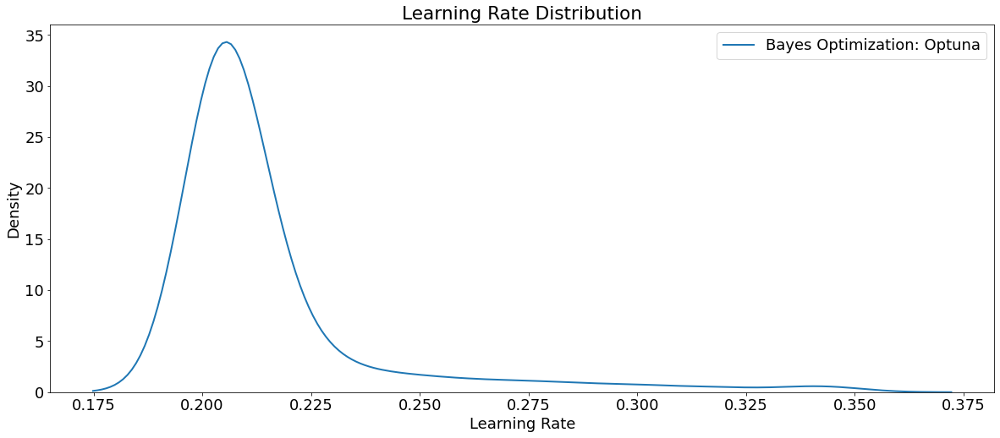

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc = 1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

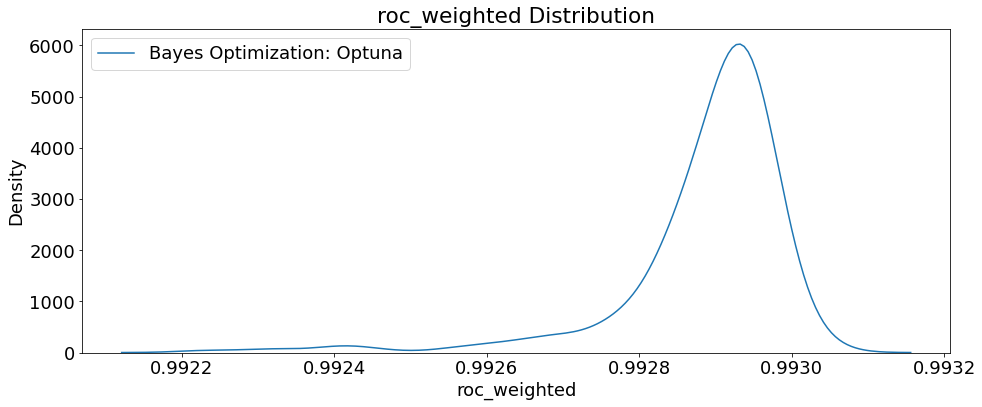

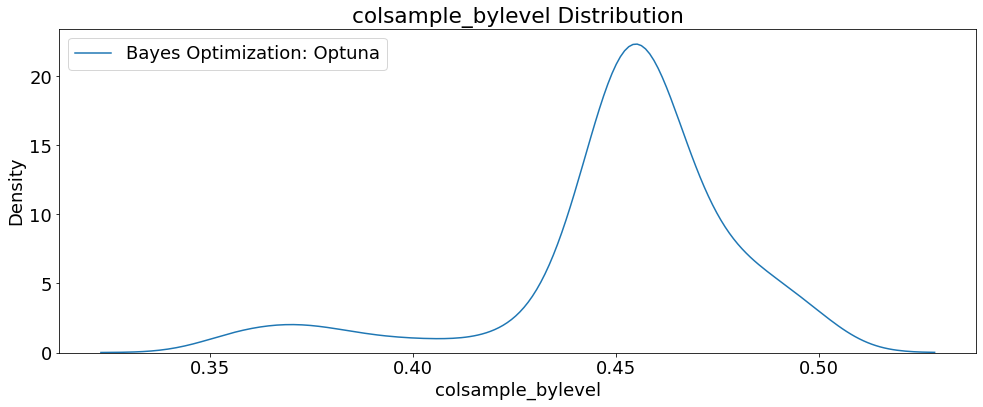

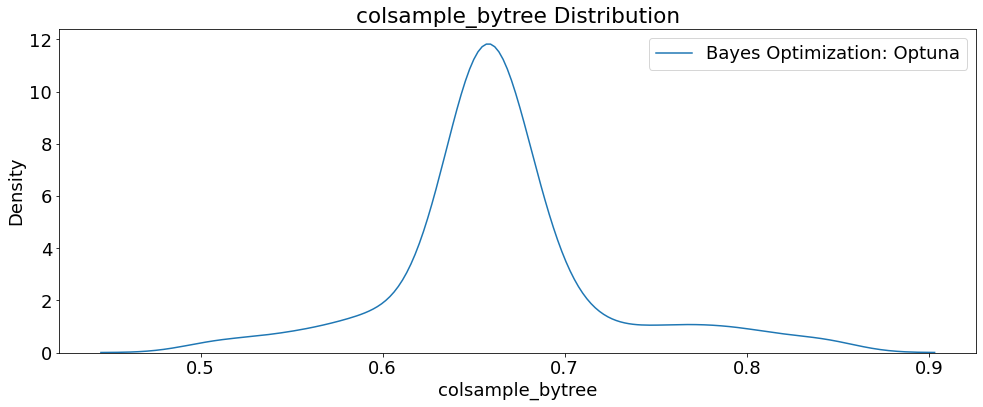

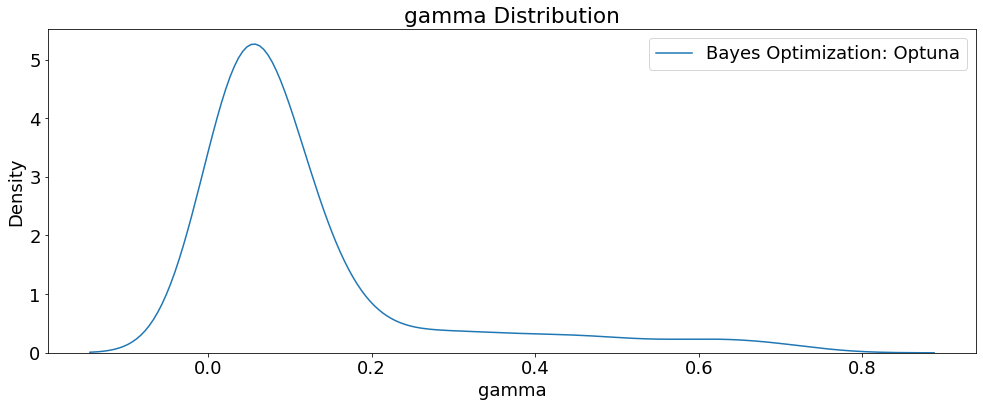

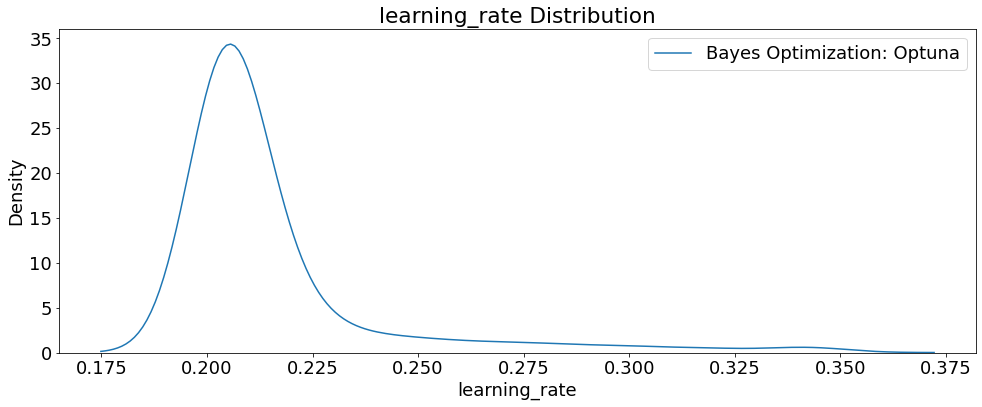

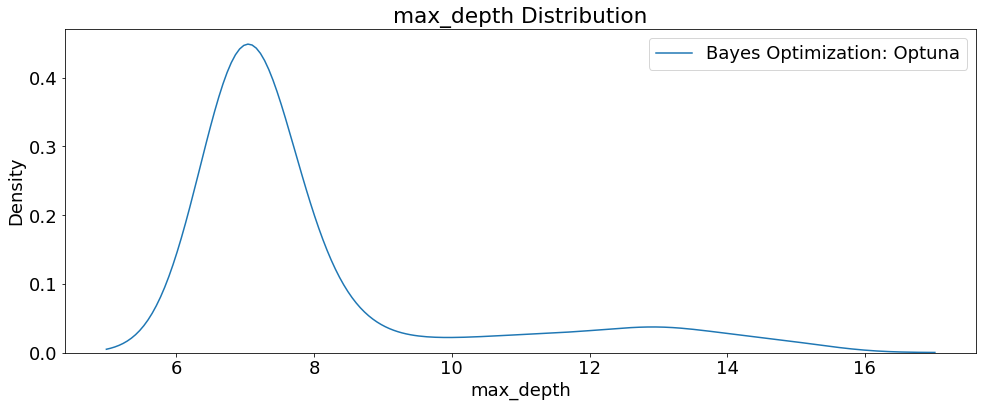

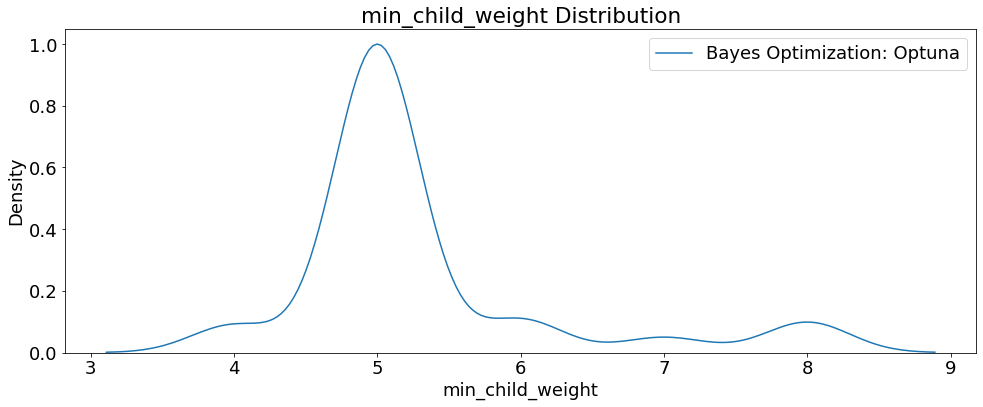

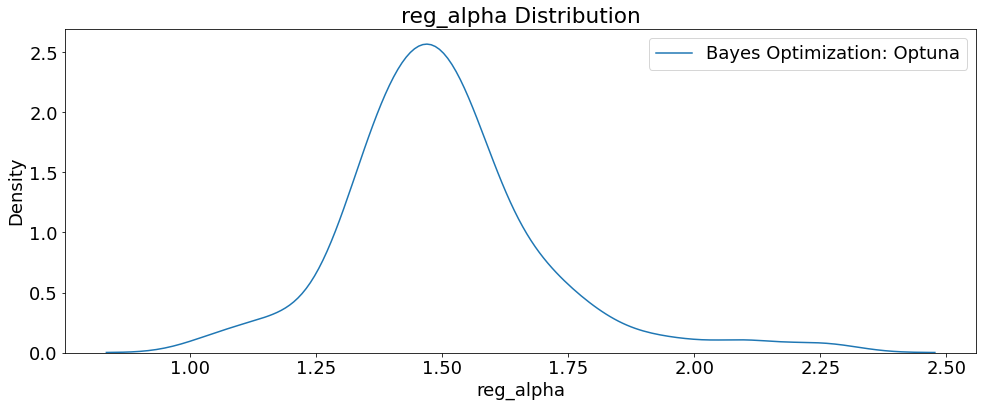

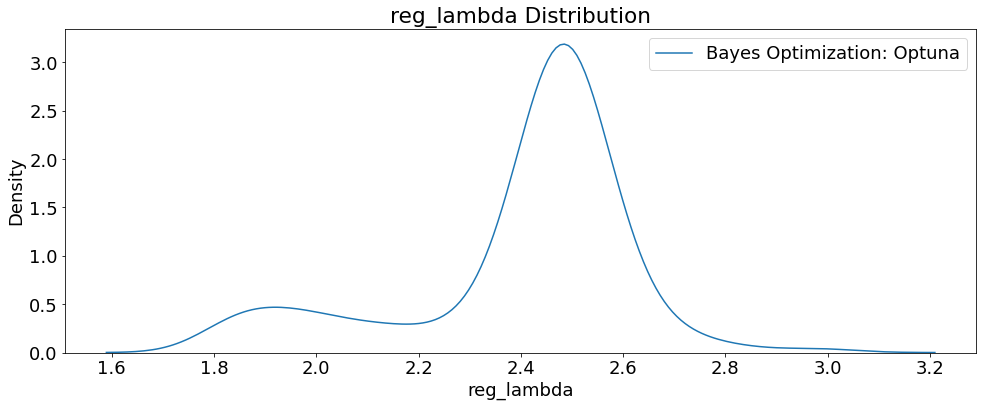

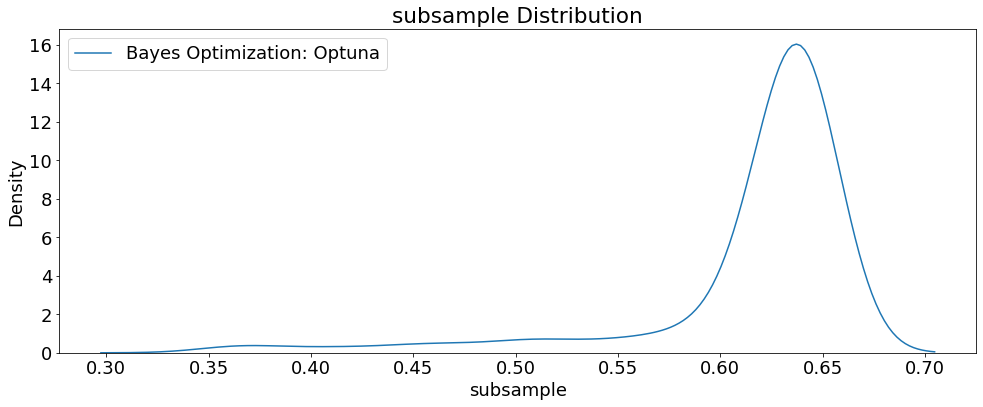

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize = (14, 6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

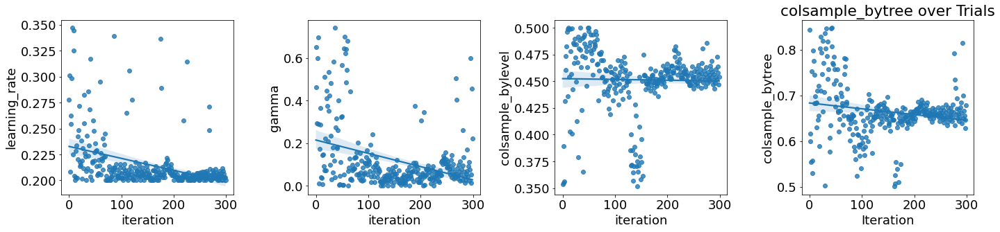

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'gamma', 'colsample_bylevel',
                         'colsample_bytree']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

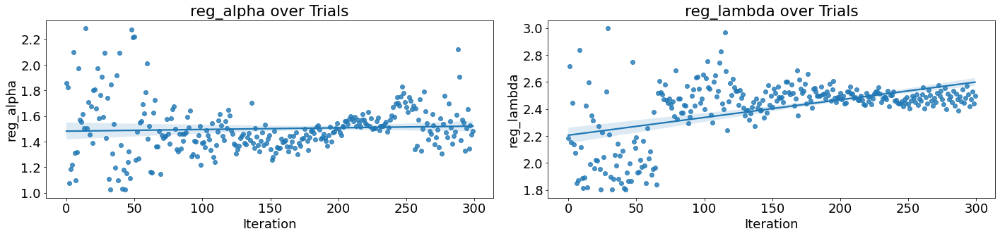

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['reg_alpha', 'reg_lambda']):
        # Scatterplot
        sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
        axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
                   title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params

{'n_estimators': 613,
 'max_depth': 7,
 'subsample': 0.6455621636856372,
 'gamma': 0.06729573089116253,
 'learning_rate': 0.21010413924260277,
 'reg_alpha': 1.4151064905421942,
 'reg_lambda': 2.4957399405744187,
 'colsample_bytree': 0.652697345304521,
 'colsample_bylevel': 0.45117759780347294,
 'min_child_weight': 5}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

In [ ]:
# Re-create the best model and train on the training data
best_model = XGBClassifier(
        objective='binary:logistic',
        n_jobs=-1,
        random_state=seed_value,
        booster='gbtree',   
        scale_pos_weight=1,
        tree_method='gpu_hist',    
        use_label_encoder=False,
        verbosity=0,
        **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'xgbRAPIDS_Optuna_SMOTE_300trials_GPU_ROCweighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('xgbRAPIDS_Optuna_SMOTE_300trials_GPU_ROCweighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost RAPIDS HPO SMOTE 300 trials GPU ROCweighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for XGBoost RAPIDS HPO SMOTE 300 trials GPU ROCweighted


Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    377848
           1       0.99      0.91      0.95     54625

    accuracy                           0.99    432473
   macro avg       0.99      0.95      0.97    432473
weighted avg       0.99      0.99      0.99    432473



Confusion matrix:
[[377567    281]
 [  4920  49705]]


Accuracy score : 0.988
Precision score : 0.994
Recall score : 0.910
F1 score : 0.950


In [ ]:
# Evaluate on the testing data 
print('The best model from SMOTE 300 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                          asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from SMOTE 300 GPU trials optimization scores 0.95459 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                   183
roc_weighted                           0.993048
datetime_start       2022-09-20 00:25:09.177375
datetime_complete    2022-09-20 00:25:25.646974
duration                 0 days 00:00:16.469599
colsample_bylevel                      0.451178
colsample_bytree                       0.652697
gamma                                  0.067296
learning_rate                          0.210104
max_depth                                     7
min_child_weight                              5
n_estimators                                613
reg_alpha                              1.415106
reg_lambda                              2.49574
subsample                              0.645562
state                                  COMPLETE
Name: 183, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance

perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/Model_Explanations/xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.2819 ± 0.0008,total_pymnt
0.2405 ± 0.0009,out_prncp
0.0860 ± 0.0003,loan_amnt
0.0781 ± 0.0006,installment
0.0677 ± 0.0002,recoveries
0.0297 ± 0.0003,total_rec_int
0.0280 ± 0.0005,last_pymnt_amnt
0.0021 ± 0.0001,int_rate
0.0008 ± 0.0000,total_rec_late_fee
0.0002 ± 0.0000,term_ 60 months


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted_WeightsExplain.csv', 
           index=False)
exp

,feature,weight,std
0,total_pymnt,0.281868,0.000381
1,out_prncp,0.240451,0.000430
2,loan_amnt,0.086012,0.000166
3,installment,0.078091,0.000277
4,recoveries,0.067670,0.000093
5,total_rec_int,0.029683,0.000145
6,last_pymnt_amnt,0.027971,0.000259
7,int_rate,0.002094,0.000059
8,total_rec_late_fee,0.000783,0.000018
9,term_ 60 months,0.000234,0.000019


In [ ]:
# Training Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_train)

<Figure size 432x288 with 0 Axes>

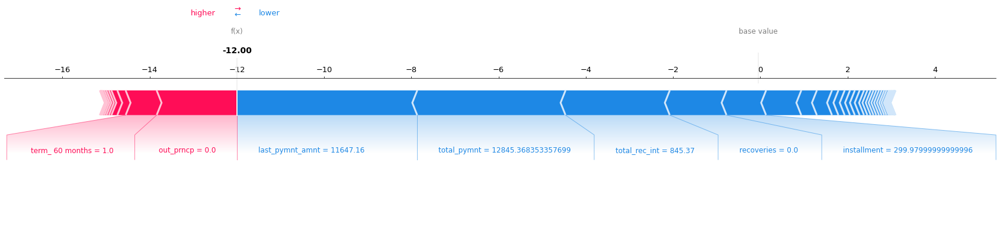

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 5)).savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted_ShapForcePlot_TrainSet.png', 
                                                                      dpi=my_dpi, 
                                                                      bbox_inches='tight');

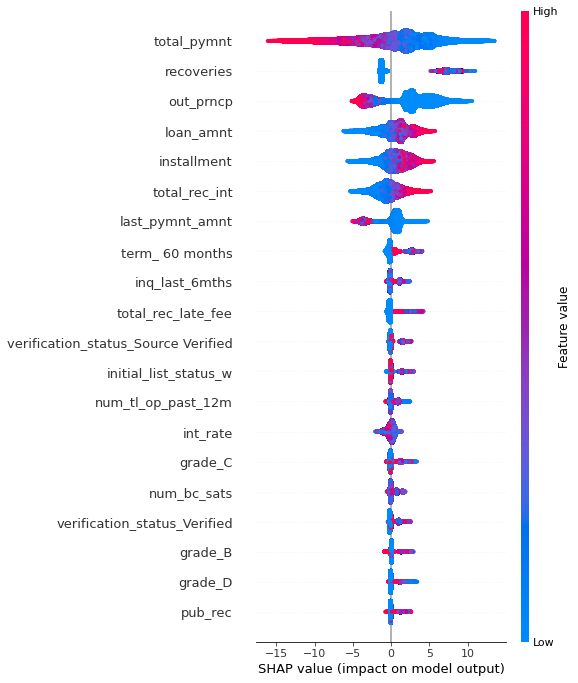

In [ ]:
# Training Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_train.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted_ShapSummary_TrainSet.png', 
            dpi=my_dpi, bbox_inches='tight');

In [ ]:
# Test Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_test)

<Figure size 432x288 with 0 Axes>

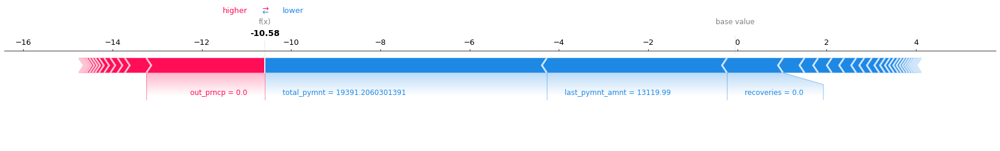

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_test.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 3)).savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted_ShapForcePlot_TestSet.png', 
                                                                      dpi=my_dpi, 
                                                                      bbox_inches='tight');

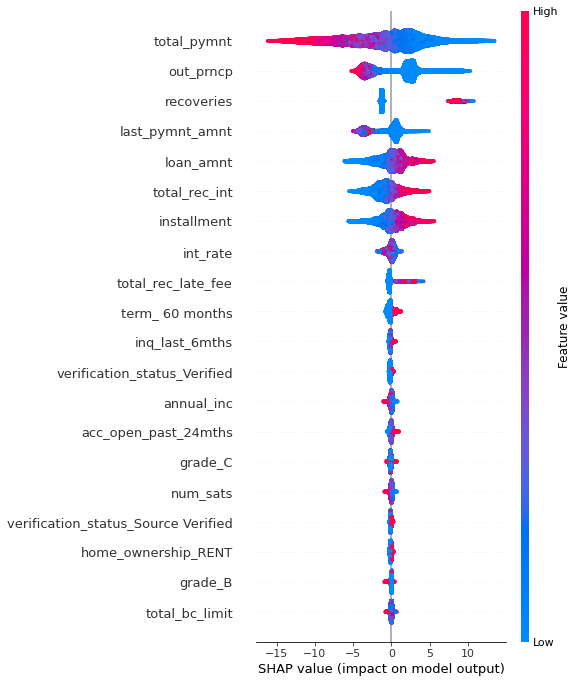

In [ ]:
# Test Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_test.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted_ShapSummary_TestSet.png', 
            dpi=my_dpi, bbox_inches='tight');

<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

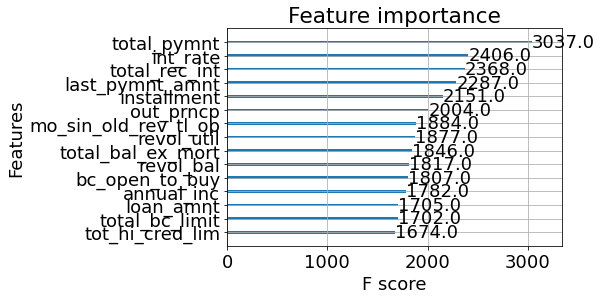

In [ ]:
# Feature importance
plot_importance(best_model, max_num_features=15);

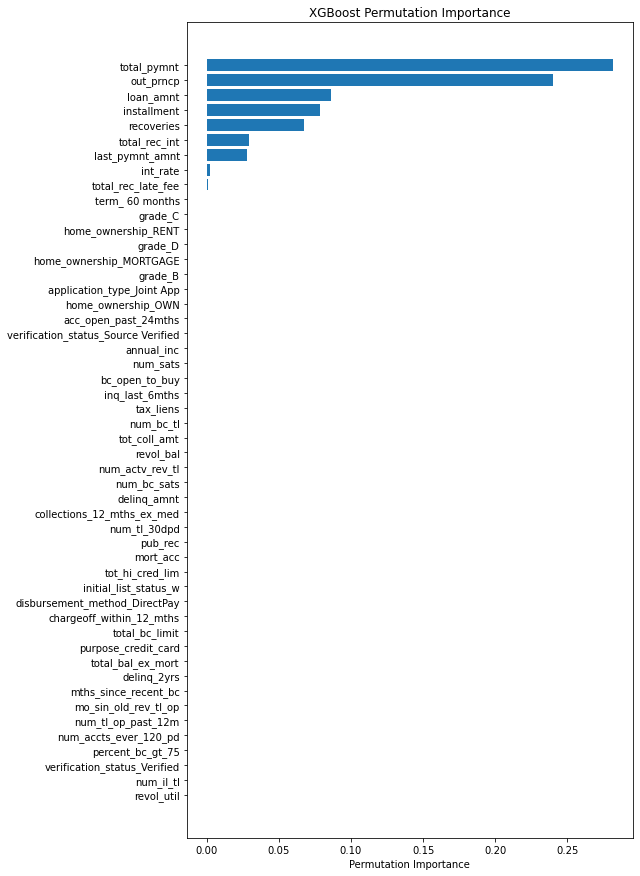

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('XGBoost Permutation Importance')
fig.savefig('xgbRAPIDS_Optuna_SMOTE_300_GPU_ROCweighted_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');